<a href="https://colab.research.google.com/github/jeraimondi/aai-cv-obj-detect-fashion/blob/main/Yolov8_5models.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Importing Libraries/Setting Data Path

In [1]:
!pip install ultralytics

In [2]:
import os
import cv2
import numpy as np
import random
import cv2
from matplotlib import pyplot as plt
from sklearn.model_selection import train_test_split
#from sklearn.metrics import confusion_matrix, plot_confusion_matrix
from tensorflow import keras
from tensorflow.keras import layers
from xml.etree import ElementTree as ET
import matplotlib.pyplot as plt
from sklearn.model_selection import GridSearchCV
from google.colab import drive
import shutil
import tqdm
from ultralytics import YOLO
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [ ]:
images_path = '/content/drive/MyDrive/colorful_fashion_dataset_for_object_detection/JPEGImages/'
annotations_path = '/content/drive/MyDrive/colorful_fashion_dataset_for_object_detection/Annotations_txt/'
file_path = '/content/drive/MyDrive/colorful_fashion_dataset_for_object_detection'

# Graphing 6 Random Images

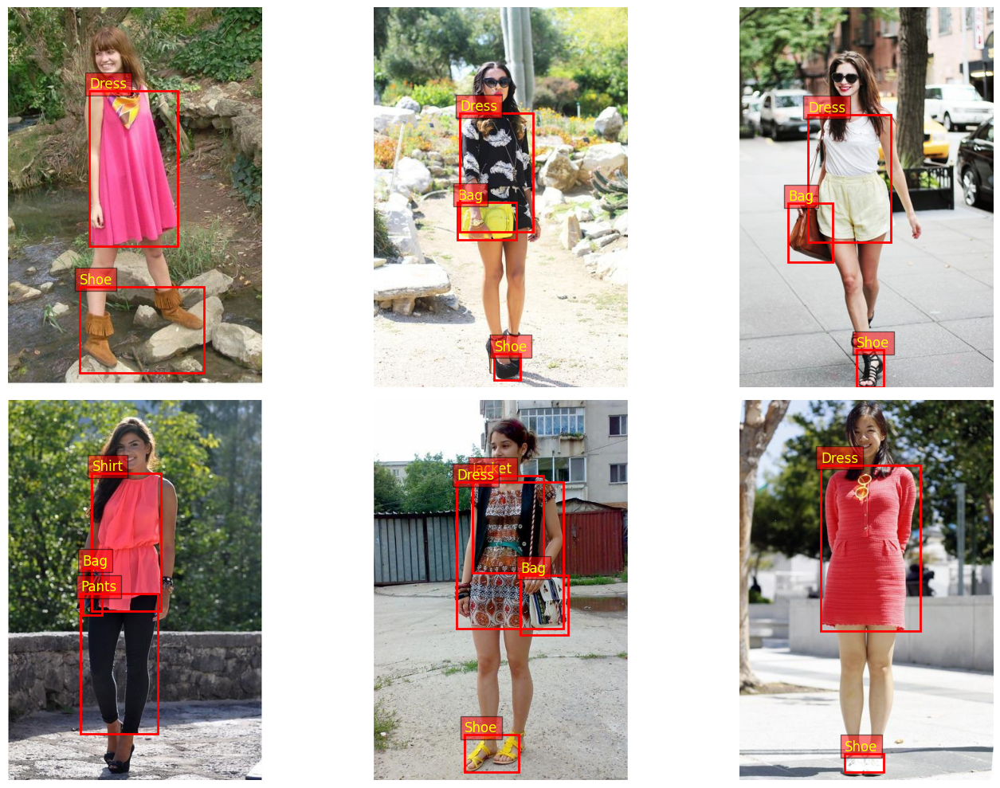

In [ ]:
class_id_to_name = {
    0: "Sunglass",
    1: "Hat",
    2: "Jacket",
    3: "Shirt",
    4: "Pants",
    5: "Shorts",
    6: "Skirt",
    7: "Dress",
    8: "Bag",
    9: "Shoe"
}


def plot_images_with_annotations(image_paths, annotation_paths, num_images=6):
    # Set up the subplot dimensions as 2 rows and 3 columns
    fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(15, 10))
    axes = axes.flatten()

    for ax, image_path, annotation_path in zip(axes, image_paths, annotation_paths):
        # Read the image
        image = cv2.imread(image_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert from BGR to RGB

        # Load the annotations
        with open(annotation_path, 'r') as file:
            annotations = file.readlines()

        # Plot the image
        ax.imshow(image)

        # Plot each bounding box and class ID
        for annotation in annotations:
            class_id, x_center, y_center, width, height = map(float, annotation.split())
            # Convert normalized coordinates to pixel values
            x_center, y_center, width, height = (x_center * image.shape[1], y_center * image.shape[0],
                                                 width * image.shape[1], height * image.shape[0])
            xmin = int(x_center - width / 2)
            ymin = int(y_center - height / 2)
            xmax = int(x_center + width / 2)
            ymax = int(y_center + height / 2)

            # Draw the bounding box
            rect = plt.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin, linewidth=2, edgecolor='r', facecolor='none')
            ax.add_patch(rect)

            # Display the class ID or name
            class_name = class_id_to_name.get(class_id, f"Class{int(class_id)}")
            ax.text(xmin, ymin - 5, class_name, color='yellow', fontsize=12, bbox=dict(facecolor='red', alpha=0.5))

        # Hide the axes
        ax.axis('off')

    plt.tight_layout()
    plt.show()

# List all images and annotations
image_files = os.listdir(images_path)
annotation_files = os.listdir(annotations_path)

# Select five random images and their corresponding annotations
random_image_names = random.sample(image_files, 6)
random_image_paths = [os.path.join(images_path, img_name) for img_name in random_image_names]
random_annotation_paths = [os.path.join(annotations_path, img_name.replace('.jpg', '.txt')) for img_name in random_image_names]

# Plot the images with annotations
plot_images_with_annotations(random_image_paths, random_annotation_paths)

Annotations look usable, except some do not detect the entire section of the image.

# Train/Test Initialization (Only needs to be run once)

In [ ]:
# Initializing Train and Test Sets

# Setting path to sets of train and reading the txt file
train_set = []
with open(file_path + '/ImageSets/Main/trainval.txt', 'r') as train:
    for line in train.readlines():
      line = line[:-1]
      train_set.append(line)
# Setting path to sets of test and reading the txt file
test_set = []
with open(file_path + '/ImageSets/Main/test.txt', 'r') as test:
  for line in test.readlines():
      line = line[:-1]
      test_set.append(line)

In [ ]:
# Checking length of train/test sets
print("Length of train set:", len(train_set))
print("Length of test set:", len(test_set))

Length of train set: 2144
Length of test set: 537


In [ ]:
# Making paths for train/test

# Making folder for labels and images in drive
base_path = '/content/drive/My Drive/YoloProject/'

# Making directories for train/test labels/images in new folder to be stored
os.mkdir(base_path + 'train')
os.mkdir(base_path + 'train/images')
os.mkdir(base_path + 'train/labels')

os.mkdir(base_path + 'test')
os.mkdir(base_path + 'test/images')
os.mkdir(base_path + 'test/labels')

# Setting location
train_location = base_path + 'train/'
test_location = base_path + 'test/'

In [ ]:
# Populating train new folder with images and labels
for i in tqdm.tqdm(train_set):
    try:
        # Images
        x = shutil.copyfile(images_path + i + '.jpg', train_location + 'images/' + i + '.jpg')
        # Labels
        x = shutil.copyfile(annotations_path + i + '.txt', train_location + 'labels/' + i + '.txt')
    except FileNotFoundError as e:
        print(f"File not found: {e}")

100%|██████████| 2144/2144 [17:13<00:00,  2.07it/s]

File not found: [Errno 2] No such file or directory: '/content/drive/MyDrive/colorful_fashion_dataset_for_object_detection/JPEGImages/10255.jpg'


Sometimes, the last file is not found

In [ ]:
# Populating test new folder with images and labels
for i in tqdm.tqdm(test_set):
    try:
      # Images
      x = shutil.copyfile(images_path + i + '.jpg', test_location + 'images/' + i + '.jpg')
      # Labels
      x = shutil.copyfile(annotations_path + i + '.txt', test_location + 'labels/' + i + '.txt')
    except FileNotFoundError as e:
        print(f"File not found: {e}")

100%|██████████| 537/537 [04:10<00:00,  2.14it/s]

File not found: [Errno 2] No such file or directory: '/content/drive/MyDrive/colorful_fashion_dataset_for_object_detection/JPEGImages/24.jpg'


Sometimes, the last file is not found

# Training and Evaluating Yolo Models

In [ ]:
# Initial yaml file for first round of training
text_file = '''

train: '/content/drive/My Drive/YoloProject/train'
val: '/content/drive/My Drive/YoloProject/test'

nc: 10
names: ['sunglass', 'hat', 'jacket', 'shirt', 'pants', 'shorts', 'skirt', 'dress', 'bag', 'shoe']
'''

with open('/content/drive/My Drive/YoloProject/data1.yaml', 'w') as f:
  f.write(text_file)

# Yolo Model 1 - 50 Epochs

## Yolo 1 Training

In [ ]:
# Training Model
yolo1 = YOLO('yolov8m.pt')
yolo1.train(data='/content/drive/My Drive/YoloProject/data1.yaml', epochs=50)

100%|██████████| 49.7M/49.7M [00:00<00:00, 354MB/s]


Ultralytics YOLOv8.0.222 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
engine/trainer: task=detect, mode=train, model=yolov8m.pt, data=/content/drive/My Drive/YoloProject/data1.yaml, epochs=50, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=True

100%|██████████| 755k/755k [00:00<00:00, 43.3MB/s]

Overriding model.yaml nc=80 with nc=10

                   from  n    params  module                                       arguments                     
  0                  -1  1      1392  ultralytics.nn.modules.conv.Conv             [3, 48, 3, 2]                 
  1                  -1  1     41664  ultralytics.nn.modules.conv.Conv             [48, 96, 3, 2]                
  2                  -1  2    111360  ultralytics.nn.modules.block.C2f             [96, 96, 2, True]             
  3                  -1  1    166272  ultralytics.nn.modules.conv.Conv             [96, 192, 3, 2]               
  4                  -1  4    813312  ultralytics.nn.modules.block.C2f             [192, 192, 4, True]           
  5                  -1  1    664320  ultralytics.nn.modules.conv.Conv             [192, 384, 3, 2]              
  6                  -1  4   3248640  ultralytics.nn.modules.block.C2f             [384, 384, 4, True]           
  7                  -1  1   1991808  ultralytic

 12                  -1  2   1993728  ultralytics.nn.modules.block.C2f             [960, 384, 2]                 
 13                  -1  1         0  torch.nn.modules.upsampling.Upsample         [None, 2, 'nearest']          
 14             [-1, 4]  1         0  ultralytics.nn.modules.conv.Concat           [1]                           
 15                  -1  2    517632  ultralytics.nn.modules.block.C2f             [576, 192, 2]                 
 16                  -1  1    332160  ultralytics.nn.modules.conv.Conv             [192, 192, 3, 2]              
 17            [-1, 12]  1         0  ultralytics.nn.modules.conv.Concat           [1]                           
 18                  -1  2   1846272  ultralytics.nn.modules.block.C2f             [576, 384, 2]                 
 19                  -1  1   1327872  ultralytics.nn.modules.conv.Conv             [384, 384, 3, 2]              
 20             [-1, 9]  1         0  ultralytics.nn.modules.conv.Concat           [1]  

100%|██████████| 6.23M/6.23M [00:00<00:00, 196MB/s]


WARNING ⚠️ NMS time limit 0.550s exceeded
AMP: checks passed ✅


train: Scanning /content/drive/My Drive/YoloProject/train/labels.cache... 2143 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2143/2143 [00:00<?, ?it/s]


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/drive/My Drive/YoloProject/test/labels.cache... 536 images, 0 backgrounds, 0 corrupt: 100%|██████████| 536/536 [00:00<?, ?it/s]


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000714, momentum=0.9) with parameter groups 77 weight(decay=0.0), 84 weight(decay=0.0005), 83 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/train
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      6.94G      1.302       1.83      1.425        117        640: 100%|██████████| 134/134 [00:48<00:00,  2.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:10<00:00,  1.55it/s]

                   all        536       2031       0.58      0.633      0.626      0.381



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      7.16G      1.252      1.261      1.382         88        640: 100%|██████████| 134/134 [00:25<00:00,  5.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.65it/s]


                   all        536       2031      0.665      0.679      0.696      0.429

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      7.16G      1.268      1.218      1.389        103        640: 100%|██████████| 134/134 [00:25<00:00,  5.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.77it/s]


                   all        536       2031       0.69      0.629      0.674       0.41

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      7.17G      1.264      1.176      1.384         98        640: 100%|██████████| 134/134 [00:25<00:00,  5.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.81it/s]


                   all        536       2031      0.629      0.611      0.618      0.386

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      7.15G      1.256      1.141      1.389        122        640: 100%|██████████| 134/134 [00:25<00:00,  5.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.67it/s]


                   all        536       2031      0.703      0.729      0.738      0.476

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      7.17G      1.225      1.089      1.363        112        640: 100%|██████████| 134/134 [00:25<00:00,  5.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.50it/s]


                   all        536       2031      0.698      0.718      0.735      0.467

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      7.18G      1.211      1.065       1.36        144        640: 100%|██████████| 134/134 [00:25<00:00,  5.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.44it/s]


                   all        536       2031      0.765      0.707      0.754       0.49

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50       7.2G      1.181      1.009      1.342        140        640: 100%|██████████| 134/134 [00:25<00:00,  5.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.54it/s]


                   all        536       2031      0.733      0.701      0.732       0.48

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      7.16G      1.188      1.013      1.345         85        640: 100%|██████████| 134/134 [00:25<00:00,  5.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.55it/s]


                   all        536       2031      0.631      0.747      0.729      0.473

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      7.17G      1.156     0.9609      1.325        124        640: 100%|██████████| 134/134 [00:25<00:00,  5.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.70it/s]


                   all        536       2031      0.727      0.729      0.757        0.5

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      7.17G      1.145     0.9445      1.311        120        640: 100%|██████████| 134/134 [00:25<00:00,  5.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.57it/s]


                   all        536       2031      0.753      0.699      0.756      0.497

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      7.16G       1.12     0.8984      1.296        104        640: 100%|██████████| 134/134 [00:25<00:00,  5.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.65it/s]


                   all        536       2031      0.731      0.719      0.746      0.503

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      7.17G      1.119     0.9008      1.302        102        640: 100%|██████████| 134/134 [00:25<00:00,  5.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.74it/s]


                   all        536       2031      0.717       0.75      0.771      0.508

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      7.15G      1.096     0.8591      1.287        100        640: 100%|██████████| 134/134 [00:25<00:00,  5.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.63it/s]


                   all        536       2031      0.764      0.774       0.78       0.52

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      7.17G      1.085     0.8566      1.276        122        640: 100%|██████████| 134/134 [00:25<00:00,  5.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.60it/s]


                   all        536       2031      0.723      0.767      0.778      0.523

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      7.16G      1.071     0.8333       1.27         82        640: 100%|██████████| 134/134 [00:25<00:00,  5.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:04<00:00,  4.22it/s]


                   all        536       2031      0.751      0.751      0.778      0.522

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      7.17G      1.051     0.8128      1.259        107        640: 100%|██████████| 134/134 [00:25<00:00,  5.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.43it/s]

                   all        536       2031      0.735      0.747      0.778      0.531



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      7.17G      1.039     0.8139      1.252         84        640: 100%|██████████| 134/134 [00:25<00:00,  5.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.45it/s]


                   all        536       2031      0.751      0.751       0.78      0.522

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      7.18G      1.042     0.7804      1.248        155        640: 100%|██████████| 134/134 [00:25<00:00,  5.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.51it/s]

                   all        536       2031      0.752       0.74       0.78      0.533



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      7.18G      1.033     0.7723       1.24         93        640: 100%|██████████| 134/134 [00:25<00:00,  5.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.46it/s]


                   all        536       2031      0.749      0.772      0.787      0.536

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      7.17G      1.011     0.7452      1.232        106        640: 100%|██████████| 134/134 [00:25<00:00,  5.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.65it/s]


                   all        536       2031      0.764      0.777      0.792      0.536

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      7.17G      1.001     0.7293      1.218        102        640: 100%|██████████| 134/134 [00:25<00:00,  5.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.73it/s]


                   all        536       2031      0.731      0.746      0.769      0.523

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      7.15G     0.9914     0.7292      1.219        100        640: 100%|██████████| 134/134 [00:25<00:00,  5.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.65it/s]


                   all        536       2031      0.737      0.774      0.783      0.545

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      7.17G     0.9963     0.7129      1.223         95        640: 100%|██████████| 134/134 [00:25<00:00,  5.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.45it/s]


                   all        536       2031      0.752       0.77      0.794      0.547

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      7.16G     0.9649     0.7017      1.199         97        640: 100%|██████████| 134/134 [00:25<00:00,  5.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.58it/s]

                   all        536       2031      0.761       0.76      0.792      0.542



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      7.18G     0.9688      0.687      1.206        126        640: 100%|██████████| 134/134 [00:25<00:00,  5.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.77it/s]


                   all        536       2031      0.774      0.748      0.783      0.537

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      7.18G     0.9563     0.6783      1.188        117        640: 100%|██████████| 134/134 [00:25<00:00,  5.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.69it/s]

                   all        536       2031      0.749      0.776      0.791      0.537



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      7.18G     0.9446     0.6668      1.184        110        640: 100%|██████████| 134/134 [00:25<00:00,  5.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.53it/s]


                   all        536       2031      0.765      0.777      0.785      0.541

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      7.17G     0.9215     0.6409      1.177        113        640: 100%|██████████| 134/134 [00:25<00:00,  5.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.61it/s]

                   all        536       2031      0.748      0.765      0.784      0.539



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      7.17G     0.9205     0.6357      1.172        102        640: 100%|██████████| 134/134 [00:25<00:00,  5.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.61it/s]


                   all        536       2031      0.774      0.751      0.788      0.542

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      7.17G     0.9095      0.627      1.169        102        640: 100%|██████████| 134/134 [00:25<00:00,  5.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.66it/s]

                   all        536       2031      0.756       0.78      0.795      0.542



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      7.17G     0.9086     0.6106      1.158         90        640: 100%|██████████| 134/134 [00:25<00:00,  5.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.66it/s]


                   all        536       2031      0.791      0.747      0.787       0.54

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      7.17G     0.8871     0.5962       1.15        119        640: 100%|██████████| 134/134 [00:25<00:00,  5.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.69it/s]

                   all        536       2031      0.762      0.769      0.782      0.535



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      7.16G     0.8928     0.6005      1.151        107        640: 100%|██████████| 134/134 [00:25<00:00,  5.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.58it/s]

                   all        536       2031      0.742      0.772      0.783      0.531



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      7.16G      0.874      0.584       1.14        110        640: 100%|██████████| 134/134 [00:25<00:00,  5.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.57it/s]


                   all        536       2031      0.783      0.768      0.799      0.548

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      7.17G     0.8704     0.5694      1.138        118        640: 100%|██████████| 134/134 [00:25<00:00,  5.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.59it/s]


                   all        536       2031      0.761       0.78      0.795      0.546

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      7.17G     0.8503     0.5641      1.125        106        640: 100%|██████████| 134/134 [00:25<00:00,  5.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.68it/s]

                   all        536       2031      0.753      0.769      0.794      0.546



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      7.17G     0.8453     0.5515      1.122        109        640: 100%|██████████| 134/134 [00:25<00:00,  5.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.68it/s]

                   all        536       2031      0.743      0.769      0.775      0.535



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      7.18G     0.8436     0.5528      1.118        147        640: 100%|██████████| 134/134 [00:25<00:00,  5.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.63it/s]

                   all        536       2031      0.769      0.751      0.785      0.541



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      7.18G     0.8297     0.5423      1.123        117        640: 100%|██████████| 134/134 [00:25<00:00,  5.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.52it/s]

                   all        536       2031      0.753      0.778      0.791      0.537


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      7.17G     0.7674     0.4434      1.081         63        640: 100%|██████████| 134/134 [00:27<00:00,  4.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.40it/s]


                   all        536       2031      0.767       0.77      0.786       0.54

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      7.17G     0.7462     0.4326      1.065         59        640: 100%|██████████| 134/134 [00:25<00:00,  5.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.51it/s]


                   all        536       2031      0.742      0.776      0.787      0.537

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      7.17G     0.7349     0.4168      1.063         57        640: 100%|██████████| 134/134 [00:25<00:00,  5.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:04<00:00,  4.15it/s]

                   all        536       2031       0.75      0.781      0.792      0.537



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      7.18G     0.7229     0.4035      1.045         54        640: 100%|██████████| 134/134 [00:25<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:04<00:00,  4.12it/s]


                   all        536       2031      0.772      0.749      0.781      0.537

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      7.15G     0.7169     0.3985      1.045         57        640: 100%|██████████| 134/134 [00:25<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:04<00:00,  4.03it/s]


                   all        536       2031      0.762      0.752      0.784      0.535

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      7.18G     0.6979     0.3842      1.036         55        640: 100%|██████████| 134/134 [00:26<00:00,  5.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:04<00:00,  4.18it/s]


                   all        536       2031      0.781      0.757      0.778      0.533

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      7.17G     0.6935     0.3828      1.032         53        640: 100%|██████████| 134/134 [00:25<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:04<00:00,  4.23it/s]


                   all        536       2031      0.764      0.766      0.791       0.54

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      7.16G       0.68     0.3749      1.021         60        640: 100%|██████████| 134/134 [00:25<00:00,  5.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:04<00:00,  4.17it/s]


                   all        536       2031      0.773      0.765      0.785      0.537

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      7.17G     0.6671     0.3577      1.015         53        640: 100%|██████████| 134/134 [00:25<00:00,  5.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.26it/s]


                   all        536       2031      0.747      0.788      0.791      0.543

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      7.19G     0.6541     0.3549      1.007         56        640: 100%|██████████| 134/134 [00:25<00:00,  5.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.40it/s]


                   all        536       2031      0.771      0.775      0.794      0.542

50 epochs completed in 0.435 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 52.0MB
Optimizer stripped from runs/detect/train/weights/best.pt, 52.0MB

Validating runs/detect/train/weights/best.pt...
Ultralytics YOLOv8.0.222 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
Model summary (fused): 218 layers, 25845550 parameters, 0 gradients, 78.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:07<00:00,  2.22it/s]


                   all        536       2031      0.784      0.769      0.799      0.547
            Sunglasses        536         82      0.738      0.207      0.382      0.156
                   Hat        536         76      0.813      0.816      0.848      0.501
                Jacket        536        181      0.748      0.818      0.854       0.67
                 Shirt        536        365      0.816       0.86       0.87       0.63
                 Pants        536        114       0.86      0.939       0.96      0.776
                Shorts        536        107      0.815      0.826      0.783      0.515
                 Skirt        536        185      0.766       0.85      0.838      0.654
                 Dress        536        128      0.748      0.844      0.858      0.707
                   Bag        536        274      0.727      0.701      0.768      0.394
                  Shoe        536        519      0.806      0.826      0.825       0.47
Speed: 0.1ms preproce

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7dfdc98aa9b0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.0

# Yolo 1 Evaluation
- P: 0.783
- R: 0.769
-mAP50: 0.798
- mAP50-95: 0.548


In [ ]:
# Check final metrics
yolo1.val()

Ultralytics YOLOv8.0.222 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
Model summary (fused): 218 layers, 25845550 parameters, 0 gradients, 78.7 GFLOPs


val: Scanning /content/drive/My Drive/YoloProject/test/labels.cache... 536 images, 0 backgrounds, 0 corrupt: 100%|██████████| 536/536 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 34/34 [00:09<00:00,  3.54it/s]


                   all        536       2031      0.783      0.769      0.798      0.548
            Sunglasses        536         82      0.738      0.207      0.381      0.157
                   Hat        536         76      0.813      0.816      0.848      0.501
                Jacket        536        181      0.744      0.818      0.854       0.67
                 Shirt        536        365      0.815       0.86       0.87      0.629
                 Pants        536        114       0.86      0.939       0.96      0.776
                Shorts        536        107      0.815      0.826      0.783      0.518
                 Skirt        536        185      0.766       0.85      0.838      0.656
                 Dress        536        128      0.748      0.844      0.858      0.706
                   Bag        536        274      0.728      0.702      0.769      0.397
                  Shoe        536        519      0.806      0.826      0.824      0.468
Speed: 0.1ms preproce

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7dfd55e7d270>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.0

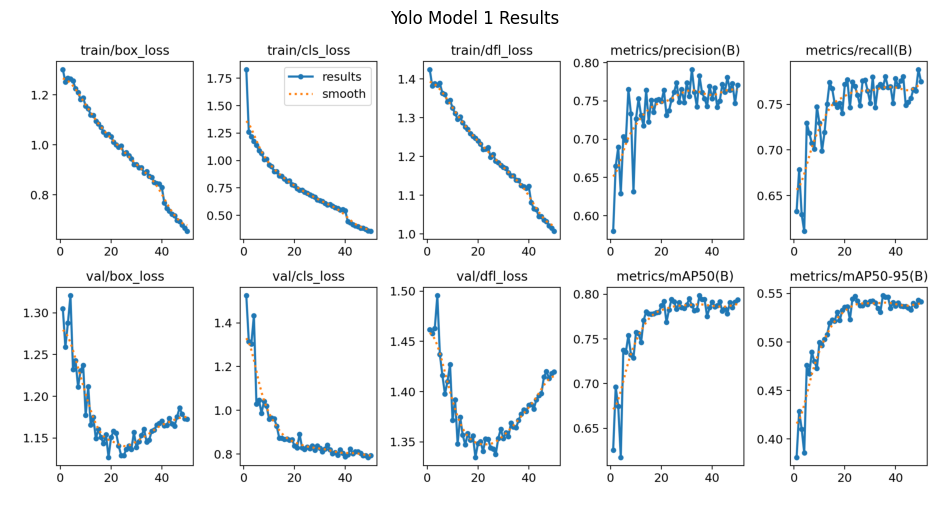

In [45]:
# Load image
yolo1_results = cv2.imread('/content/drive/MyDrive/yolo_runs2/runs2/detect/1st yolo train/results.png', 1)

# Convert BGR to RGB
yolo1_results_rgb = cv2.cvtColor(yolo1_results, cv2.COLOR_BGR2RGB)

# Set a larger figure size for display
plt.figure(figsize=(12, 10))

# Display the image
plt.title("Yolo Model 1 Results")
plt.imshow(yolo1_results_rgb)
plt.axis("off")
plt.show()

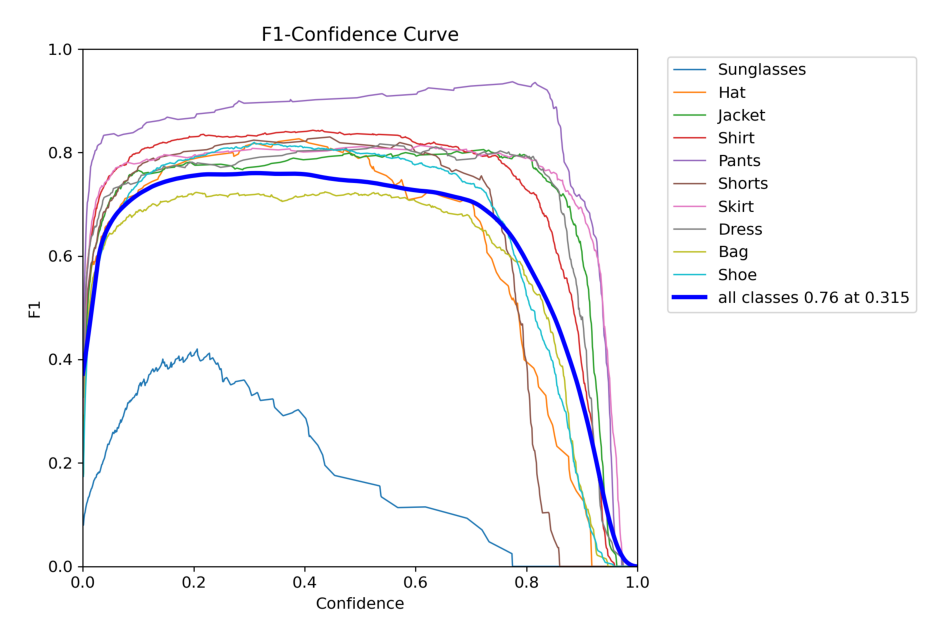

In [42]:
# Load image
yolo1_f1 = cv2.imread('/content/drive/MyDrive/yolo_runs2/runs2/detect/1st yolo val/F1_curve.png', 1)

# Convert BGR to RGB
yolo1_f1_rgb = cv2.cvtColor(yolo1_f1, cv2.COLOR_BGR2RGB)

# Set a larger figure size for display
plt.figure(figsize=(12, 10))

# Display the image
plt.imshow(yolo1_f1_rgb)
plt.axis("off")
plt.show()

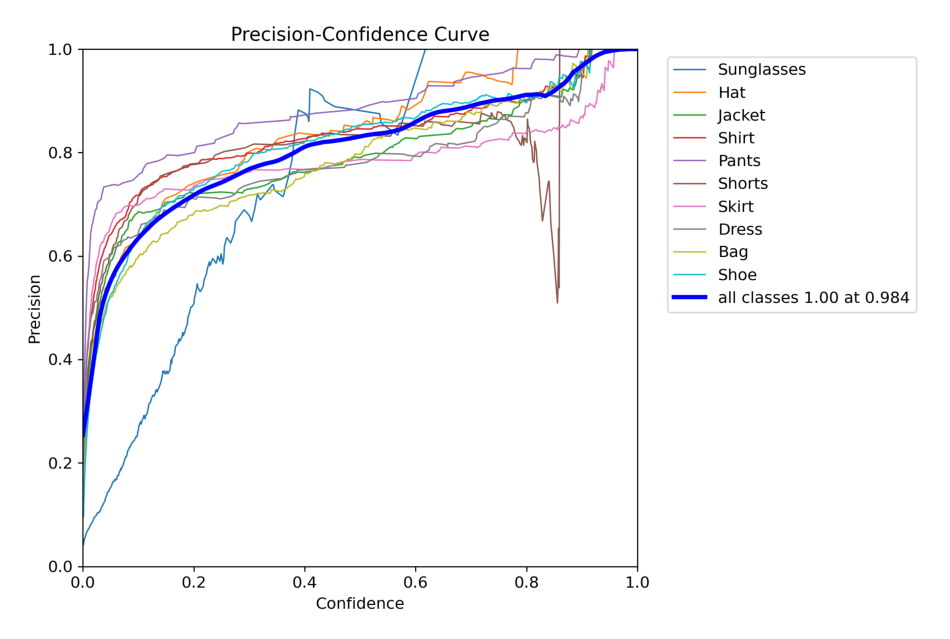

In [40]:
# Load image
yolo1_pc = cv2.imread('/content/drive/MyDrive/yolo_runs2/runs2/detect/1st yolo val/P_curve.png', 1)

# Convert BGR to RGB
yolo1_pc_rgb = cv2.cvtColor(yolo1_pc, cv2.COLOR_BGR2RGB)

# Set a larger figure size for display
plt.figure(figsize=(12, 10))

# Display the image
plt.imshow(yolo1_pc_rgb)
plt.axis("off")
plt.show()

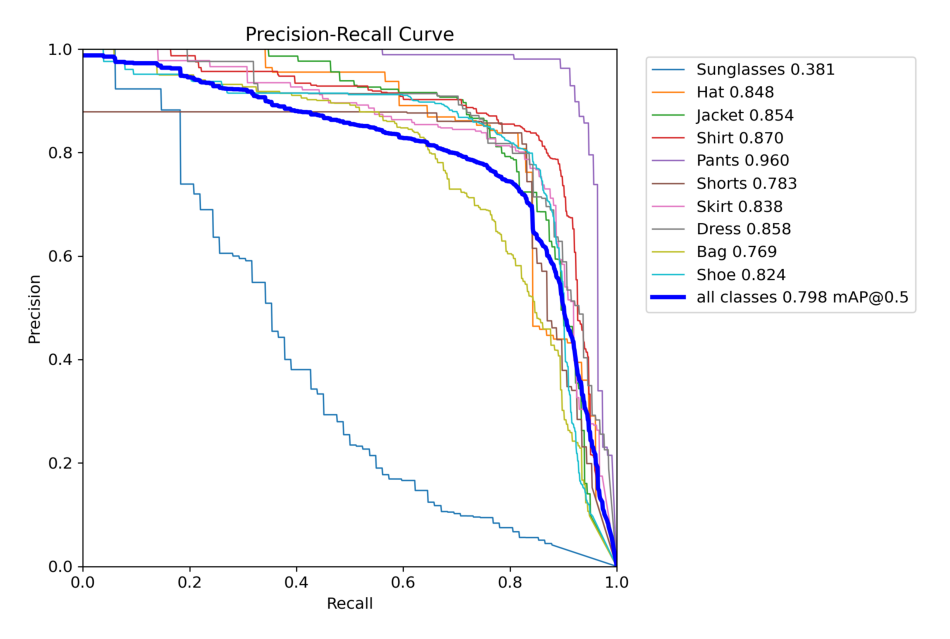

In [36]:
# Load image
yolo1_pr = cv2.imread('/content/drive/MyDrive/yolo_runs2/runs2/detect/1st yolo val/PR_curve.png', 1)

# Convert BGR to RGB
yolo1_pr_rgb = cv2.cvtColor(yolo1_pr, cv2.COLOR_BGR2RGB)

# Set a larger figure size for display
plt.figure(figsize=(12, 10))

# Display the image
plt.imshow(yolo1_pr_rgb)
plt.axis("off")
plt.show()

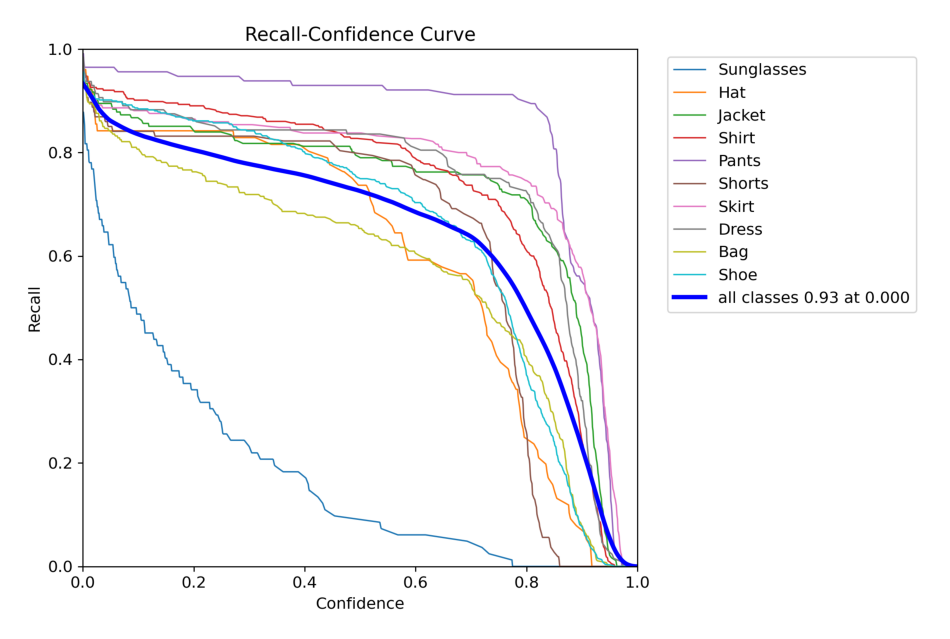

In [35]:
# Load image
yolo1_rm = cv2.imread('/content/drive/MyDrive/yolo_runs2/runs2/detect/1st yolo val/R_curve.png', 1)

# Convert BGR to RGB
yolo1_rm_rgb = cv2.cvtColor(yolo1_rm, cv2.COLOR_BGR2RGB)

# Set a larger figure size for display
plt.figure(figsize=(12, 10))

# Display the image
plt.imshow(yolo1_rm_rgb)
plt.axis("off")
plt.show()

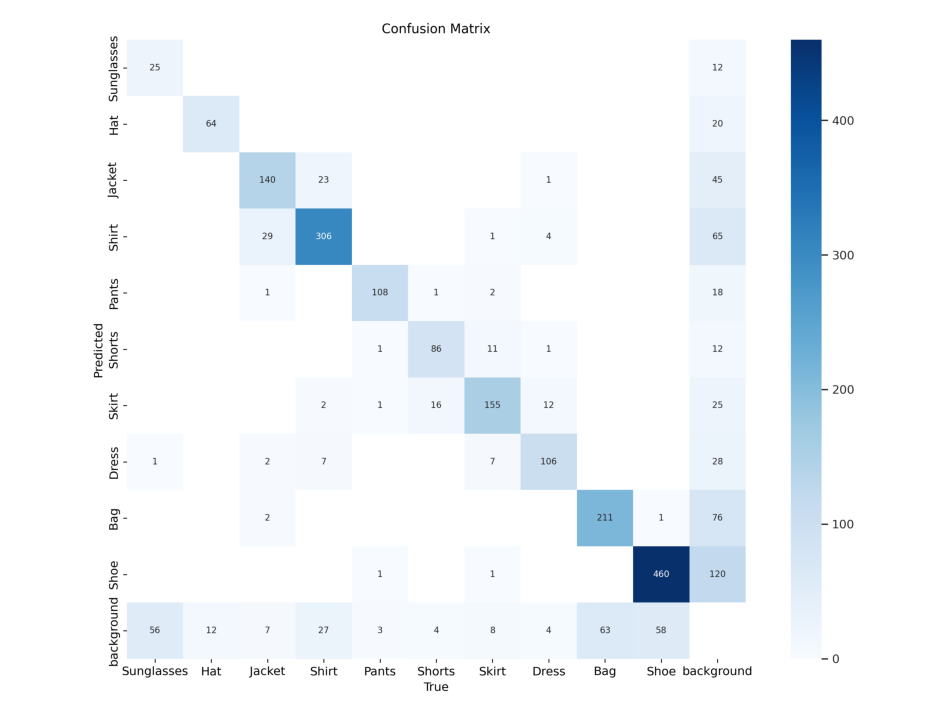

In [33]:
# Load image
yolo1_cm = cv2.imread('/content/drive/MyDrive/yolo_runs2/runs2/detect/1st yolo val/confusion_matrix.png', 1)

# Convert BGR to RGB
yolo1_cm_rgb = cv2.cvtColor(yolo1_cm, cv2.COLOR_BGR2RGB)

# Set a larger figure size for display
plt.figure(figsize=(12, 10))

# Display the image
plt.imshow(yolo1_cm_rgb)
plt.axis("off")
plt.show()

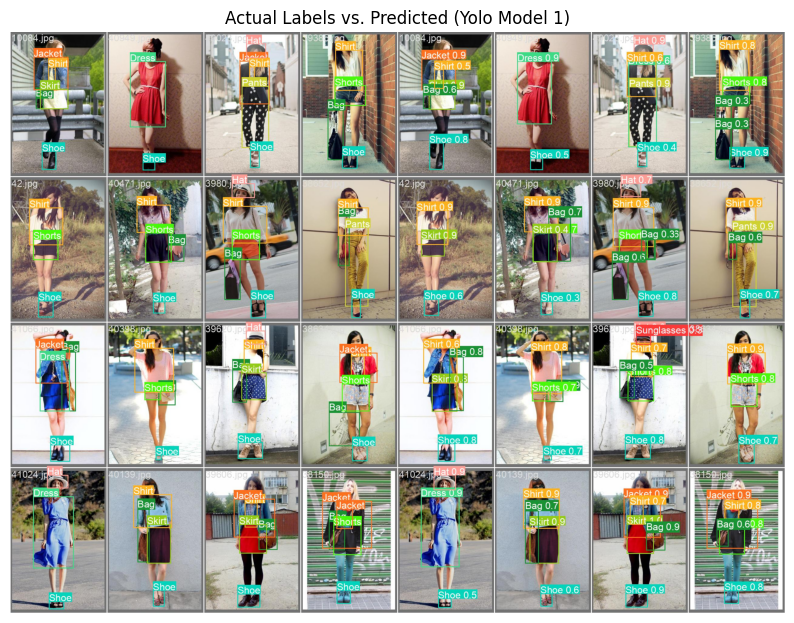

In [28]:
# Load the image
yolo1_pred = cv2.imread('/content/drive/MyDrive/yolo_runs2/runs2/detect/1st yolo val/val_batch0_pred.jpg', -1)

# Convert BGR to RGB
yolo1_pred_rgb = cv2.cvtColor(yolo1_pred, cv2.COLOR_BGR2RGB)

actual_labels = cv2.imread('/content/drive/MyDrive/yolo_runs2/runs2/detect/1st yolo val/val_batch0_labels.jpg', -1)
actual_labels_rgb = cv2.cvtColor(actual_labels, cv2.COLOR_BGR2RGB)

# Combine the images side by side
combined_image = cv2.hconcat([actual_labels_rgb, yolo1_pred_rgb])
plt.figure(figsize=(10, 8))

# Display the combined image
plt.imshow(combined_image)
plt.axis("off")
plt.title("Actual Labels vs. Predicted (Yolo Model 1)")
plt.show()


image 1/1 /content/drive/MyDrive/people.jpg: 448x640 3 Jackets, 3 Shirts, 3 Pantss, 3 Shoes, 81.6ms
Speed: 3.0ms preprocess, 81.6ms inference, 2.5ms postprocess per image at shape (1, 3, 448, 640)


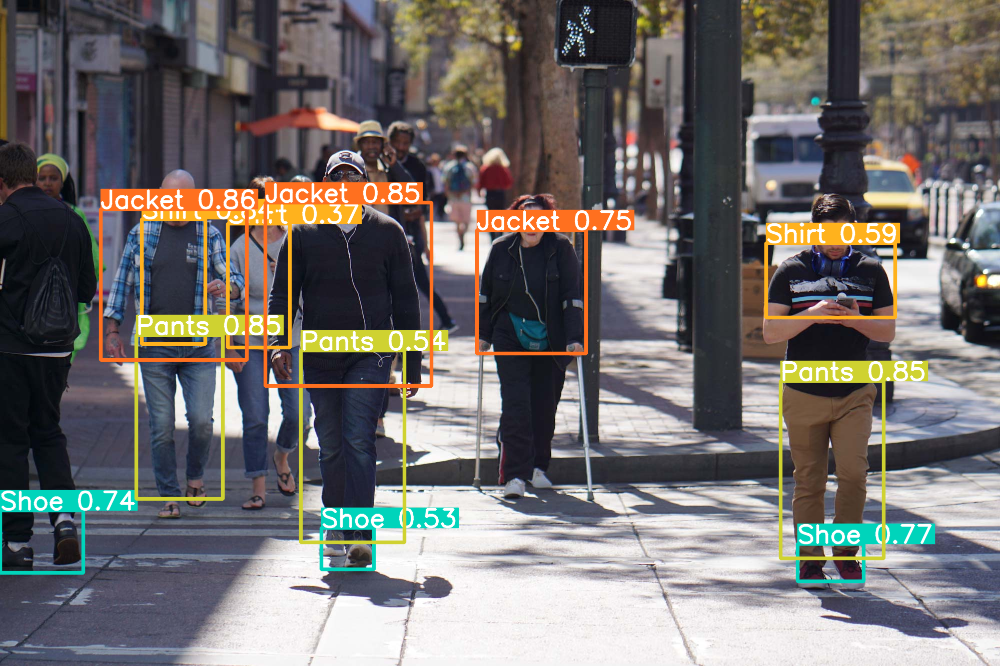

In [ ]:
# Testing with real-world data
from PIL import Image
results1 = yolo1("/content/drive/MyDrive/people.jpg")
for r in results1:
    im_array = r.plot()
    im = Image.fromarray(im_array[..., ::-1])
    display(im)

# Yolo Model 2 - 100 Epochs

## Yolo 2 Training

In [ ]:
# Training model
yolo2 = YOLO('yolov8m.pt')
yolo2.train(data='/content/drive/My Drive/YoloProject/data1.yaml', epochs=100)

Ultralytics YOLOv8.0.222 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
engine/trainer: task=detect, mode=train, model=yolov8m.pt, data=/content/drive/My Drive/YoloProject/data1.yaml, epochs=100, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=Tru

train: Scanning /content/drive/My Drive/YoloProject/train/labels.cache... 2143 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2143/2143 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/drive/My Drive/YoloProject/test/labels.cache... 536 images, 0 backgrounds, 0 corrupt: 100%|██████████| 536/536 [00:00<?, ?it/s]


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000714, momentum=0.9) with parameter groups 77 weight(decay=0.0), 84 weight(decay=0.0005), 83 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/train
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      7.59G      1.302       1.83      1.425        117        640: 100%|██████████| 134/134 [00:30<00:00,  4.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.29it/s]


                   all        536       2031       0.58      0.633      0.626      0.381

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      7.75G      1.259      1.259      1.385         88        640: 100%|██████████| 134/134 [00:26<00:00,  5.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.37it/s]


                   all        536       2031      0.596      0.684      0.675      0.429

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      7.77G       1.27      1.232      1.403        103        640: 100%|██████████| 134/134 [00:26<00:00,  5.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.47it/s]


                   all        536       2031      0.607      0.694      0.676       0.41

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100       7.8G      1.271      1.188      1.399         98        640: 100%|██████████| 134/134 [00:26<00:00,  5.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:04<00:00,  4.19it/s]


                   all        536       2031      0.698        0.6      0.652        0.4

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      7.81G      1.265      1.149      1.394        122        640: 100%|██████████| 134/134 [00:25<00:00,  5.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.48it/s]


                   all        536       2031      0.688      0.693      0.709      0.448

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      7.81G      1.231      1.101      1.377        112        640: 100%|██████████| 134/134 [00:25<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.55it/s]


                   all        536       2031      0.758      0.682      0.733       0.46

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      7.81G      1.213      1.081      1.368        144        640: 100%|██████████| 134/134 [00:25<00:00,  5.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.26it/s]


                   all        536       2031      0.763      0.679       0.74      0.478

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      7.81G      1.184      1.025      1.352        140        640: 100%|██████████| 134/134 [00:25<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.38it/s]


                   all        536       2031      0.717      0.722      0.748      0.482

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      7.81G      1.202       1.02      1.357         85        640: 100%|██████████| 134/134 [00:25<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.56it/s]


                   all        536       2031      0.744      0.706      0.737      0.487

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      7.81G      1.159     0.9691      1.333        124        640: 100%|██████████| 134/134 [00:25<00:00,  5.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.47it/s]


                   all        536       2031      0.773      0.724       0.75      0.493

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      7.81G      1.152     0.9676      1.326        120        640: 100%|██████████| 134/134 [00:25<00:00,  5.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.33it/s]


                   all        536       2031       0.75      0.725       0.76      0.511

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      7.84G       1.13     0.9221      1.309        104        640: 100%|██████████| 134/134 [00:25<00:00,  5.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.45it/s]

                   all        536       2031      0.758      0.718      0.753      0.495



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      7.82G      1.132     0.9218      1.317        102        640: 100%|██████████| 134/134 [00:26<00:00,  5.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.33it/s]


                   all        536       2031      0.755      0.725      0.777      0.507

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      7.81G      1.114     0.8886      1.297        100        640: 100%|██████████| 134/134 [00:26<00:00,  5.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:04<00:00,  4.03it/s]


                   all        536       2031      0.753       0.75      0.777      0.513

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      7.81G        1.1     0.8734      1.286        122        640: 100%|██████████| 134/134 [00:25<00:00,  5.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:04<00:00,  4.24it/s]

                   all        536       2031      0.727      0.754      0.771      0.507



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      7.81G      1.097     0.8515      1.286         82        640: 100%|██████████| 134/134 [00:26<00:00,  5.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.32it/s]


                   all        536       2031      0.716      0.764      0.769      0.519

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      7.81G      1.067     0.8358       1.27        107        640: 100%|██████████| 134/134 [00:26<00:00,  5.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:04<00:00,  4.11it/s]


                   all        536       2031      0.738      0.754      0.778      0.525

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      7.82G      1.067      0.843      1.273         84        640: 100%|██████████| 134/134 [00:26<00:00,  5.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.27it/s]


                   all        536       2031      0.765      0.744      0.776      0.523

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100       7.8G       1.06     0.8203      1.257        155        640: 100%|██████████| 134/134 [00:26<00:00,  5.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.45it/s]


                   all        536       2031      0.747      0.754      0.787      0.532

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      7.83G      1.057      0.803      1.261         93        640: 100%|██████████| 134/134 [00:26<00:00,  5.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:04<00:00,  4.07it/s]

                   all        536       2031      0.745      0.771      0.782      0.533



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100       7.8G      1.038     0.7776      1.248        106        640: 100%|██████████| 134/134 [00:25<00:00,  5.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:04<00:00,  4.16it/s]

                   all        536       2031      0.739      0.762      0.779      0.519



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      7.82G      1.038     0.7712       1.24        102        640: 100%|██████████| 134/134 [00:26<00:00,  5.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:04<00:00,  4.21it/s]


                   all        536       2031      0.746      0.758      0.773      0.522

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      7.85G      1.022      0.777      1.246        100        640: 100%|██████████| 134/134 [00:26<00:00,  5.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.28it/s]


                   all        536       2031      0.762      0.757      0.776      0.521

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      7.81G       1.03     0.7602      1.246         95        640: 100%|██████████| 134/134 [00:25<00:00,  5.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:04<00:00,  4.04it/s]


                   all        536       2031      0.757      0.749      0.775      0.529

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100       7.8G      1.003     0.7484      1.226         97        640: 100%|██████████| 134/134 [00:25<00:00,  5.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.25it/s]


                   all        536       2031      0.742      0.758      0.776      0.525

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      7.81G      1.007     0.7398       1.23        126        640: 100%|██████████| 134/134 [00:26<00:00,  5.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:04<00:00,  4.20it/s]

                   all        536       2031      0.772      0.753      0.778      0.533



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      7.81G      1.002     0.7372      1.223        117        640: 100%|██████████| 134/134 [00:26<00:00,  5.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:04<00:00,  4.17it/s]


                   all        536       2031      0.748      0.759      0.774      0.514

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      7.81G     0.9924     0.7218      1.221        110        640: 100%|██████████| 134/134 [00:26<00:00,  5.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.30it/s]


                   all        536       2031      0.769      0.741      0.778       0.53

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      7.82G     0.9732     0.7055      1.206        113        640: 100%|██████████| 134/134 [00:26<00:00,  5.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:04<00:00,  4.18it/s]


                   all        536       2031      0.746      0.761      0.789      0.532

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      7.82G     0.9686     0.7056      1.204        102        640: 100%|██████████| 134/134 [00:25<00:00,  5.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.28it/s]


                   all        536       2031      0.734      0.768      0.775      0.524

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100       7.8G     0.9637     0.6886      1.205        102        640: 100%|██████████| 134/134 [00:25<00:00,  5.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.60it/s]


                   all        536       2031      0.755      0.776      0.787      0.531

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      7.82G     0.9587     0.6827      1.192         90        640: 100%|██████████| 134/134 [00:25<00:00,  5.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.36it/s]


                   all        536       2031      0.765      0.751      0.781      0.533

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100       7.8G     0.9469     0.6751       1.19        119        640: 100%|██████████| 134/134 [00:25<00:00,  5.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.54it/s]


                   all        536       2031      0.764      0.769      0.781      0.531

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100      7.83G     0.9519     0.6715      1.192        107        640: 100%|██████████| 134/134 [00:25<00:00,  5.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.57it/s]


                   all        536       2031      0.753      0.763       0.78      0.531

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      7.81G     0.9427     0.6608      1.182        110        640: 100%|██████████| 134/134 [00:25<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.35it/s]


                   all        536       2031      0.758      0.776      0.791      0.532

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      7.81G     0.9306     0.6398      1.175        118        640: 100%|██████████| 134/134 [00:25<00:00,  5.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.44it/s]


                   all        536       2031      0.779      0.769      0.789      0.538

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      7.81G     0.9234     0.6447      1.172        106        640: 100%|██████████| 134/134 [00:25<00:00,  5.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.40it/s]


                   all        536       2031      0.764       0.76      0.788      0.537

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100      7.82G     0.9128     0.6315      1.166        109        640: 100%|██████████| 134/134 [00:25<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.34it/s]


                   all        536       2031      0.763      0.754      0.783       0.53

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      7.82G     0.9188     0.6322      1.171        147        640: 100%|██████████| 134/134 [00:25<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.30it/s]

                   all        536       2031       0.76      0.773      0.785      0.537



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      7.82G     0.9035     0.6199      1.168        117        640: 100%|██████████| 134/134 [00:25<00:00,  5.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.65it/s]


                   all        536       2031      0.759      0.756      0.776      0.532

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      7.82G     0.8977      0.622      1.156        118        640: 100%|██████████| 134/134 [00:25<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.39it/s]

                   all        536       2031      0.732      0.768       0.78      0.533



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100      7.82G     0.8879     0.6075      1.151        128        640: 100%|██████████| 134/134 [00:25<00:00,  5.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.50it/s]


                   all        536       2031      0.763       0.77      0.788      0.534

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      7.81G     0.8889     0.6005      1.156        105        640: 100%|██████████| 134/134 [00:25<00:00,  5.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.67it/s]


                   all        536       2031      0.738      0.766      0.772      0.523

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100      7.82G     0.8694     0.5933      1.136         98        640: 100%|██████████| 134/134 [00:25<00:00,  5.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.29it/s]


                   all        536       2031      0.763      0.766      0.774      0.523

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      7.81G     0.8793     0.5851      1.142        120        640: 100%|██████████| 134/134 [00:25<00:00,  5.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.63it/s]

                   all        536       2031      0.773      0.759      0.772      0.528



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100      7.82G     0.8686     0.5807      1.144        101        640: 100%|██████████| 134/134 [00:25<00:00,  5.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.44it/s]


                   all        536       2031      0.772      0.757      0.786      0.535

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100      7.81G     0.8542     0.5709       1.13         97        640: 100%|██████████| 134/134 [00:25<00:00,  5.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:04<00:00,  4.20it/s]


                   all        536       2031      0.759       0.76      0.774      0.531

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      7.81G     0.8514      0.571      1.135        105        640: 100%|██████████| 134/134 [00:25<00:00,  5.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.60it/s]


                   all        536       2031      0.771      0.768      0.793      0.532

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      7.79G      0.847     0.5612      1.123        113        640: 100%|██████████| 134/134 [00:25<00:00,  5.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.52it/s]

                   all        536       2031      0.765      0.732      0.764      0.523



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100      7.82G     0.8348      0.549       1.12        107        640: 100%|██████████| 134/134 [00:25<00:00,  5.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.36it/s]


                   all        536       2031      0.763       0.76       0.78      0.529

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      7.82G     0.8295     0.5442      1.112         88        640: 100%|██████████| 134/134 [00:25<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.51it/s]


                   all        536       2031      0.779      0.764      0.783      0.529

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100      7.82G     0.8239     0.5431      1.106         98        640: 100%|██████████| 134/134 [00:25<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.47it/s]

                   all        536       2031      0.786       0.76      0.789      0.536



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100      7.82G     0.8192     0.5333      1.108        108        640: 100%|██████████| 134/134 [00:25<00:00,  5.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.39it/s]


                   all        536       2031      0.788      0.747      0.777      0.529

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100       7.8G     0.8108     0.5259      1.101         89        640: 100%|██████████| 134/134 [00:25<00:00,  5.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.57it/s]


                   all        536       2031      0.798      0.748      0.789      0.533

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100      7.77G     0.8063     0.5286      1.099        101        640: 100%|██████████| 134/134 [00:25<00:00,  5.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.31it/s]


                   all        536       2031      0.749      0.765      0.782      0.534

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100      7.83G     0.7978     0.5213       1.09        104        640: 100%|██████████| 134/134 [00:25<00:00,  5.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.40it/s]

                   all        536       2031      0.785      0.769      0.786      0.528



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100      7.81G     0.7911     0.5145      1.089        116        640: 100%|██████████| 134/134 [00:25<00:00,  5.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.55it/s]

                   all        536       2031      0.773      0.759      0.783      0.529



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100       7.8G     0.7862     0.5123      1.083         85        640: 100%|██████████| 134/134 [00:25<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.32it/s]


                   all        536       2031       0.78      0.772      0.794      0.539

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      7.79G     0.7791     0.5052      1.079        126        640: 100%|██████████| 134/134 [00:25<00:00,  5.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.42it/s]


                   all        536       2031      0.756      0.772      0.783      0.529

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100      7.84G     0.7718     0.4988      1.076        111        640: 100%|██████████| 134/134 [00:25<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.63it/s]

                   all        536       2031      0.788      0.747      0.779      0.527



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100       7.8G     0.7688     0.4998       1.07         95        640: 100%|██████████| 134/134 [00:25<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.40it/s]

                   all        536       2031       0.76      0.756      0.777      0.529



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100      7.81G     0.7624     0.4956      1.069         83        640: 100%|██████████| 134/134 [00:25<00:00,  5.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.48it/s]


                   all        536       2031      0.775      0.751      0.777      0.529

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100       7.8G     0.7542     0.4811      1.059         95        640: 100%|██████████| 134/134 [00:25<00:00,  5.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:04<00:00,  4.21it/s]


                   all        536       2031      0.755      0.777      0.785       0.53

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100      7.82G     0.7375     0.4735      1.051        128        640: 100%|██████████| 134/134 [00:25<00:00,  5.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.40it/s]


                   all        536       2031      0.784      0.744       0.78      0.527

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      7.82G      0.742     0.4795       1.06        112        640: 100%|██████████| 134/134 [00:25<00:00,  5.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.55it/s]


                   all        536       2031      0.762      0.772      0.774      0.524

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100      7.83G     0.7383     0.4694      1.058        111        640: 100%|██████████| 134/134 [00:25<00:00,  5.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.58it/s]


                   all        536       2031      0.771       0.77      0.779      0.528

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100      7.82G     0.7284      0.468      1.052        143        640: 100%|██████████| 134/134 [00:26<00:00,  5.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.42it/s]


                   all        536       2031      0.764      0.748      0.779      0.534

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100      7.83G     0.7246     0.4664      1.042        114        640: 100%|██████████| 134/134 [00:25<00:00,  5.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.58it/s]

                   all        536       2031      0.754      0.765      0.778      0.532



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      7.82G     0.7164     0.4556      1.042        115        640: 100%|██████████| 134/134 [00:25<00:00,  5.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.63it/s]

                   all        536       2031      0.751      0.769      0.785      0.535



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100      7.82G     0.7133     0.4605      1.041        118        640: 100%|██████████| 134/134 [00:25<00:00,  5.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.40it/s]


                   all        536       2031      0.759      0.766      0.772      0.526

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100      7.81G     0.7019     0.4487      1.037        111        640: 100%|██████████| 134/134 [00:25<00:00,  5.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.56it/s]


                   all        536       2031      0.789      0.752      0.773      0.521

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100       7.8G     0.6938     0.4384      1.031        137        640: 100%|██████████| 134/134 [00:26<00:00,  5.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.39it/s]

                   all        536       2031      0.772      0.758      0.779      0.531



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100      7.81G     0.6942     0.4437      1.032        100        640: 100%|██████████| 134/134 [00:25<00:00,  5.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.41it/s]


                   all        536       2031      0.759      0.771      0.781      0.531

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100      7.81G     0.6956     0.4422      1.033         97        640: 100%|██████████| 134/134 [00:25<00:00,  5.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.59it/s]

                   all        536       2031      0.757      0.766       0.77      0.528



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100      7.81G     0.6877     0.4342      1.021        116        640: 100%|██████████| 134/134 [00:25<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.63it/s]

                   all        536       2031      0.765       0.76      0.782      0.536



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100      7.81G     0.6798     0.4294      1.019        104        640: 100%|██████████| 134/134 [00:25<00:00,  5.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.45it/s]


                   all        536       2031      0.745      0.754      0.767      0.527

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100       7.8G     0.6824     0.4341      1.023        142        640: 100%|██████████| 134/134 [00:25<00:00,  5.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.60it/s]


                   all        536       2031      0.766      0.762      0.769      0.522

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100      7.82G     0.6643     0.4194      1.016        110        640: 100%|██████████| 134/134 [00:25<00:00,  5.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.48it/s]

                   all        536       2031      0.752      0.766      0.771      0.524



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100       7.8G     0.6607     0.4167       1.01        107        640: 100%|██████████| 134/134 [00:25<00:00,  5.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.38it/s]


                   all        536       2031       0.77      0.751      0.774      0.528

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100      7.82G     0.6536     0.4071      1.006        115        640: 100%|██████████| 134/134 [00:25<00:00,  5.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.68it/s]

                   all        536       2031      0.763      0.775      0.782      0.534



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100       7.8G      0.653     0.4099      1.006        109        640: 100%|██████████| 134/134 [00:25<00:00,  5.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.33it/s]

                   all        536       2031      0.774      0.761       0.78      0.534



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100      7.81G     0.6431     0.4047     0.9966        127        640: 100%|██████████| 134/134 [00:26<00:00,  5.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.43it/s]


                   all        536       2031      0.755      0.771      0.785      0.538

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100       7.8G     0.6429     0.4026     0.9974        147        640: 100%|██████████| 134/134 [00:25<00:00,  5.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.63it/s]


                   all        536       2031      0.774      0.745      0.776      0.533

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100      7.81G      0.633     0.3975     0.9975        117        640: 100%|██████████| 134/134 [00:25<00:00,  5.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.47it/s]


                   all        536       2031      0.754      0.765      0.777      0.536

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100       7.8G     0.6311     0.3975     0.9953        114        640: 100%|██████████| 134/134 [00:25<00:00,  5.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.41it/s]


                   all        536       2031      0.761      0.754      0.772      0.529

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100      7.81G     0.6286     0.3923     0.9952        110        640: 100%|██████████| 134/134 [00:25<00:00,  5.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.69it/s]


                   all        536       2031      0.758      0.757      0.775      0.532

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100       7.8G     0.6157     0.3847     0.9863        112        640: 100%|██████████| 134/134 [00:25<00:00,  5.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.47it/s]

                   all        536       2031      0.765      0.761      0.776      0.534



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100      7.81G     0.6186     0.3863     0.9893        114        640: 100%|██████████| 134/134 [00:25<00:00,  5.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.35it/s]


                   all        536       2031      0.762      0.765      0.774      0.529

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100       7.8G     0.6069     0.3826     0.9814        122        640: 100%|██████████| 134/134 [00:25<00:00,  5.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.68it/s]

                   all        536       2031      0.795       0.75      0.781      0.537



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100      7.81G     0.6063     0.3785     0.9821        108        640: 100%|██████████| 134/134 [00:25<00:00,  5.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.43it/s]

                   all        536       2031      0.779      0.751      0.773      0.531


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100      7.83G     0.5415      0.293     0.9328         54        640: 100%|██████████| 134/134 [00:27<00:00,  4.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.38it/s]


                   all        536       2031      0.784      0.745       0.77      0.528

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100      7.82G     0.5213     0.2795     0.9186         54        640: 100%|██████████| 134/134 [00:25<00:00,  5.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.55it/s]

                   all        536       2031      0.776       0.75      0.778      0.535



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100       7.8G     0.5138     0.2763     0.9171         51        640: 100%|██████████| 134/134 [00:25<00:00,  5.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.61it/s]

                   all        536       2031      0.784      0.742      0.771      0.528



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100      7.82G     0.5099     0.2714     0.9162         55        640: 100%|██████████| 134/134 [00:25<00:00,  5.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.37it/s]


                   all        536       2031      0.754      0.765      0.771      0.529

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100       7.8G     0.5023      0.269     0.9137         47        640: 100%|██████████| 134/134 [00:25<00:00,  5.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.52it/s]

                   all        536       2031      0.758      0.766      0.777      0.532



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100      7.81G      0.493     0.2654     0.9087         51        640: 100%|██████████| 134/134 [00:25<00:00,  5.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.62it/s]


                   all        536       2031      0.759      0.767      0.771      0.527

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100       7.8G     0.4893      0.261     0.9057         58        640: 100%|██████████| 134/134 [00:25<00:00,  5.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.47it/s]


                   all        536       2031      0.763       0.76      0.773      0.527

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100      7.81G     0.4873     0.2592      0.899         56        640: 100%|██████████| 134/134 [00:25<00:00,  5.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.46it/s]


                   all        536       2031      0.781      0.754      0.776      0.531

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100      7.78G     0.4818     0.2565     0.9002         49        640: 100%|██████████| 134/134 [00:25<00:00,  5.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.50it/s]


                   all        536       2031      0.758      0.775      0.778      0.534

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100      7.84G     0.4849      0.258     0.9008         54        640: 100%|██████████| 134/134 [00:25<00:00,  5.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.28it/s]

                   all        536       2031      0.746       0.78      0.774      0.532



100 epochs completed in 0.858 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 52.0MB
Optimizer stripped from runs/detect/train/weights/best.pt, 52.0MB

Validating runs/detect/train/weights/best.pt...
Ultralytics YOLOv8.0.222 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
Model summary (fused): 218 layers, 25845550 parameters, 0 gradients, 78.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:07<00:00,  2.22it/s]


                   all        536       2031       0.78      0.772      0.794      0.539
            Sunglasses        536         82      0.555      0.335      0.438      0.151
                   Hat        536         76      0.784       0.75       0.77      0.436
                Jacket        536        181      0.761      0.851      0.836      0.652
                 Shirt        536        365       0.83       0.83      0.868      0.616
                 Pants        536        114      0.905      0.919      0.956      0.767
                Shorts        536        107       0.82      0.849      0.819      0.533
                 Skirt        536        185      0.819      0.808      0.849      0.681
                 Dress        536        128      0.728      0.875      0.832      0.673
                   Bag        536        274      0.776      0.715      0.749       0.42
                  Shoe        536        519      0.824      0.784      0.818      0.459
Speed: 0.1ms preproce

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7dfd9c1e1900>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.0

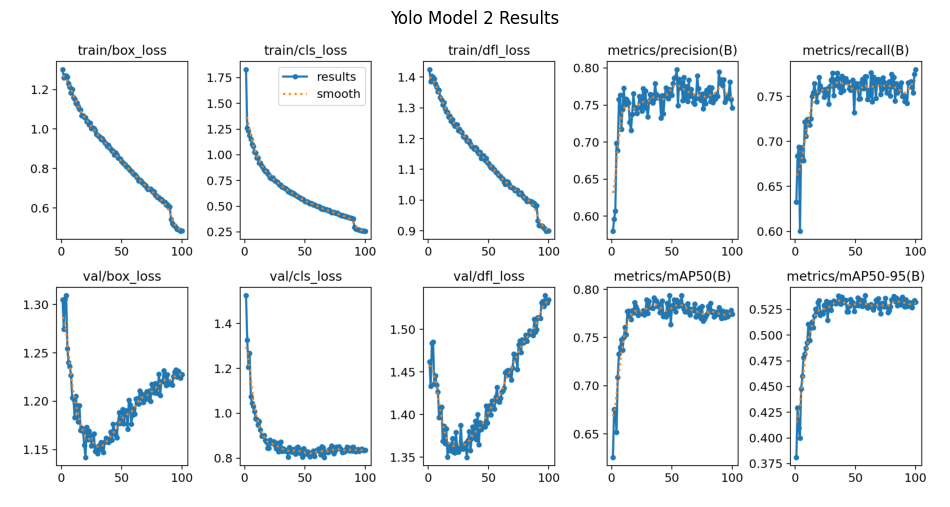

In [46]:
# Load image
yolo2_results = cv2.imread('/content/drive/MyDrive/yolo_runs2/runs2/detect/2nd yolo train/results.png', 1)

# Convert BGR to RGB
yolo2_results_rgb = cv2.cvtColor(yolo2_results, cv2.COLOR_BGR2RGB)

# Set a larger figure size for display
plt.figure(figsize=(12, 10))

# Display the image
plt.title("Yolo Model 2 Results")
plt.imshow(yolo2_results_rgb)
plt.axis("off")
plt.show()

## Yolo 2 Evaluation
- P: 0.777
- R: 0.77
-mAP50: 0.792
- mAP50-95: 0.538

In [ ]:
# Check final metrics
yolo2.val()

Ultralytics YOLOv8.0.222 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
Model summary (fused): 218 layers, 25845550 parameters, 0 gradients, 78.7 GFLOPs


val: Scanning /content/drive/My Drive/YoloProject/test/labels.cache... 536 images, 0 backgrounds, 0 corrupt: 100%|██████████| 536/536 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 34/34 [00:09<00:00,  3.58it/s]


                   all        536       2031      0.777       0.77      0.792      0.538
            Sunglasses        536         82      0.535      0.323      0.423       0.15
                   Hat        536         76      0.781      0.751       0.77      0.433
                Jacket        536        181      0.761      0.851      0.835      0.653
                 Shirt        536        365       0.83       0.83      0.868      0.616
                 Pants        536        114      0.905      0.919      0.956      0.765
                Shorts        536        107      0.812      0.841      0.819      0.537
                 Skirt        536        185      0.819      0.808      0.849       0.68
                 Dress        536        128      0.728      0.875       0.83      0.672
                   Bag        536        274      0.774      0.715       0.75      0.418
                  Shoe        536        519      0.825      0.783      0.819      0.461
Speed: 0.2ms preproce

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7dfd943809d0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.0

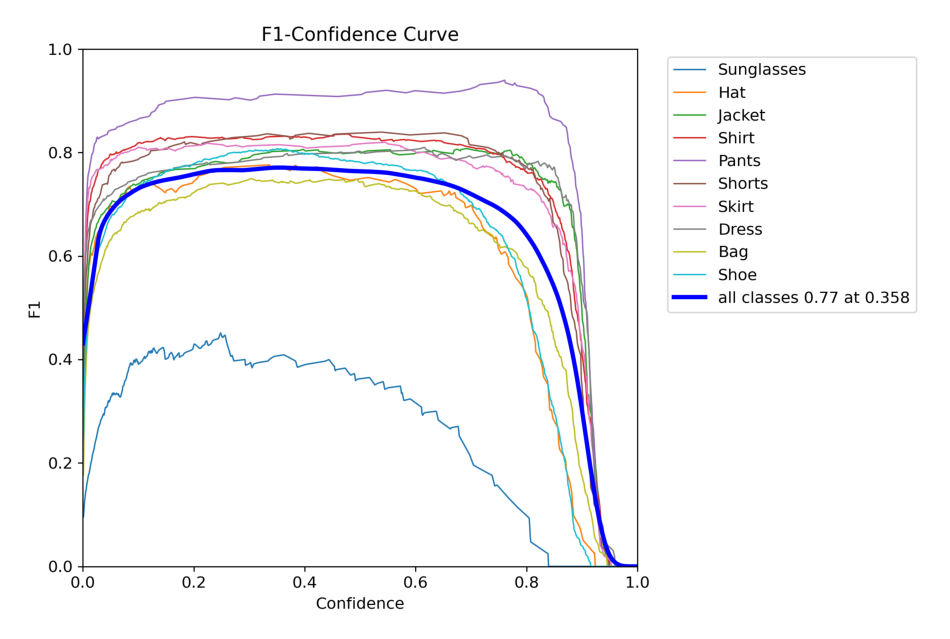

In [47]:
# Load image
yolo2_f1 = cv2.imread('/content/drive/MyDrive/yolo_runs2/runs2/detect/2nd yolo val/F1_curve.png', 1)

# Convert BGR to RGB
yolo2_f1_rgb = cv2.cvtColor(yolo2_f1, cv2.COLOR_BGR2RGB)

# Set a larger figure size for display
plt.figure(figsize=(12, 10))

# Display the image
plt.imshow(yolo2_f1_rgb)
plt.axis("off")
plt.show()

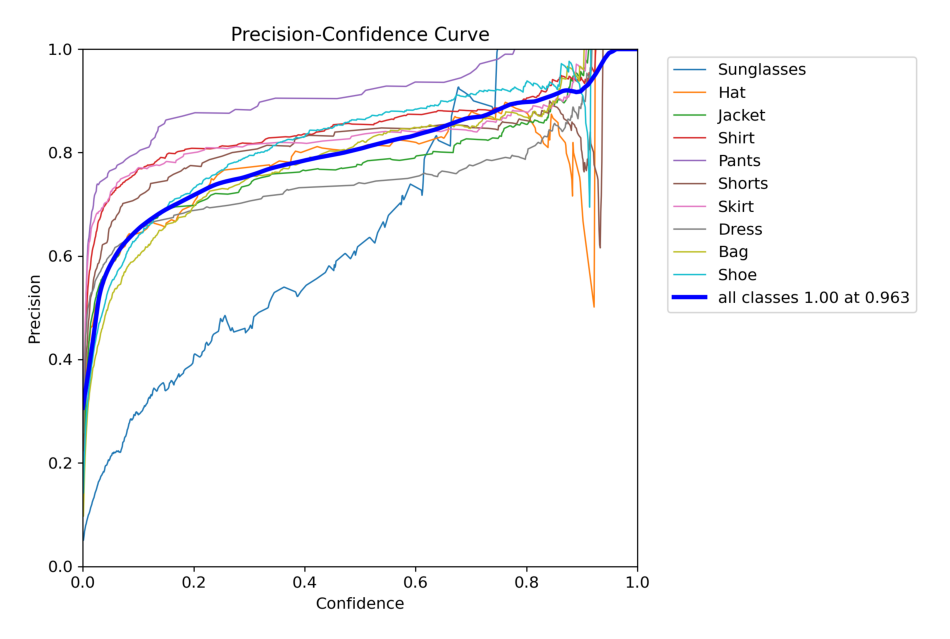

In [48]:
# Load image
yolo2_pc = cv2.imread('/content/drive/MyDrive/yolo_runs2/runs2/detect/2nd yolo val/P_curve.png', 1)

# Convert BGR to RGB
yolo2_pc_rgb = cv2.cvtColor(yolo2_pc, cv2.COLOR_BGR2RGB)

# Set a larger figure size for display
plt.figure(figsize=(12, 10))

# Display the image
plt.imshow(yolo2_pc_rgb)
plt.axis("off")
plt.show()

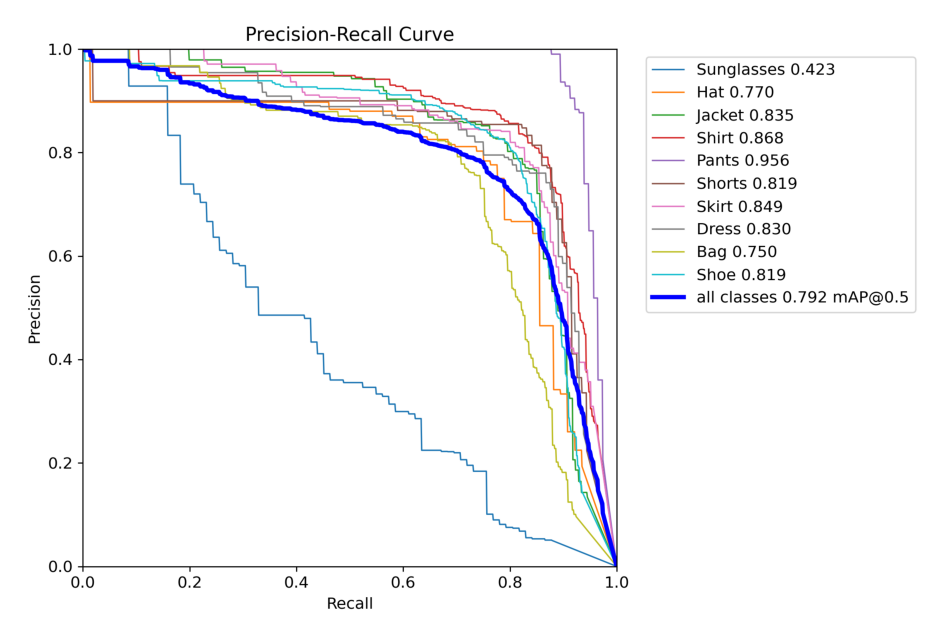

In [49]:
# Load image
yolo2_pr = cv2.imread('/content/drive/MyDrive/yolo_runs2/runs2/detect/2nd yolo val/PR_curve.png', 1)

# Convert BGR to RGB
yolo2_pr_rgb = cv2.cvtColor(yolo2_pr, cv2.COLOR_BGR2RGB)

# Set a larger figure size for display
plt.figure(figsize=(12, 10))

# Display the image
plt.imshow(yolo2_pr_rgb)
plt.axis("off")
plt.show()

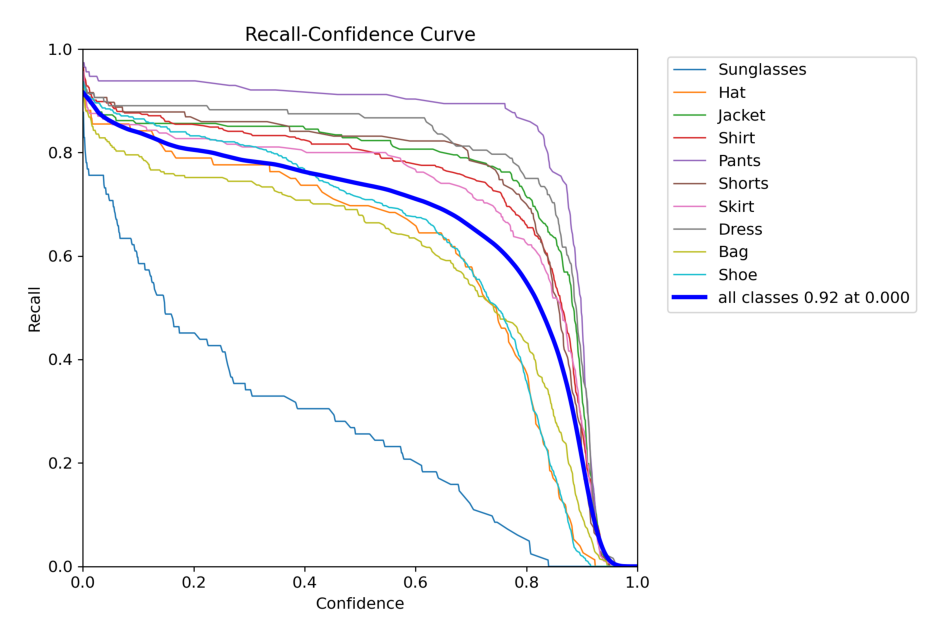

In [50]:
# Load image
yolo2_rm = cv2.imread('/content/drive/MyDrive/yolo_runs2/runs2/detect/2nd yolo val/R_curve.png', 1)

# Convert BGR to RGB
yolo2_rm_rgb = cv2.cvtColor(yolo2_rm, cv2.COLOR_BGR2RGB)

# Set a larger figure size for display
plt.figure(figsize=(12, 10))

# Display the image
plt.imshow(yolo2_rm_rgb)
plt.axis("off")
plt.show()

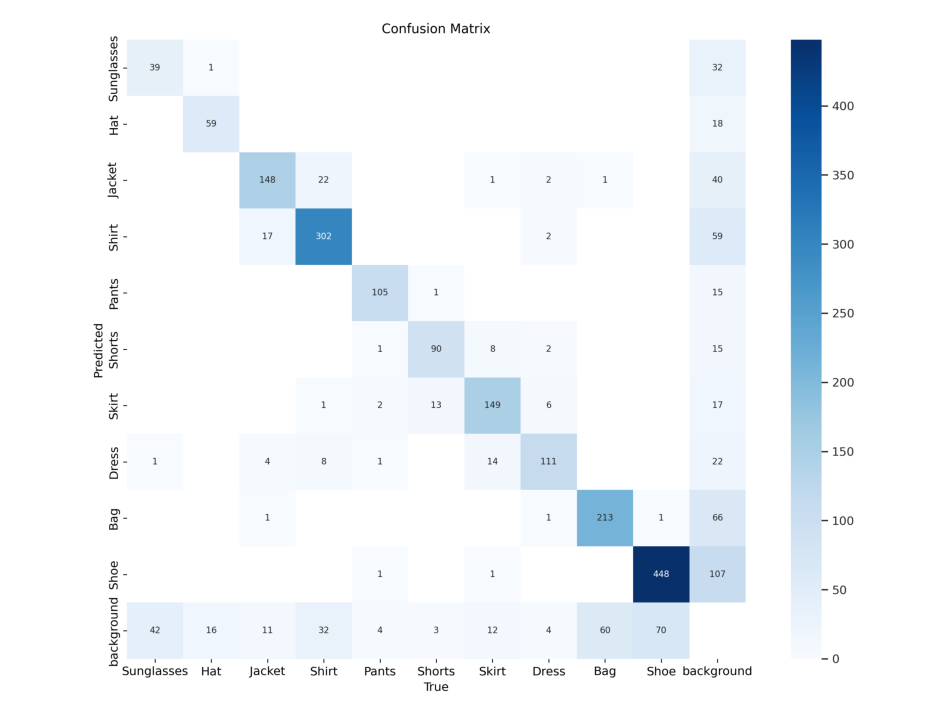

In [51]:
# Load image
yolo2_cm = cv2.imread('/content/drive/MyDrive/yolo_runs2/runs2/detect/2nd yolo val/confusion_matrix.png', 1)

# Convert BGR to RGB
yolo2_cm_rgb = cv2.cvtColor(yolo2_cm, cv2.COLOR_BGR2RGB)

# Set a larger figure size for display
plt.figure(figsize=(12, 10))

# Display the image
plt.imshow(yolo2_cm_rgb)
plt.axis("off")
plt.show()

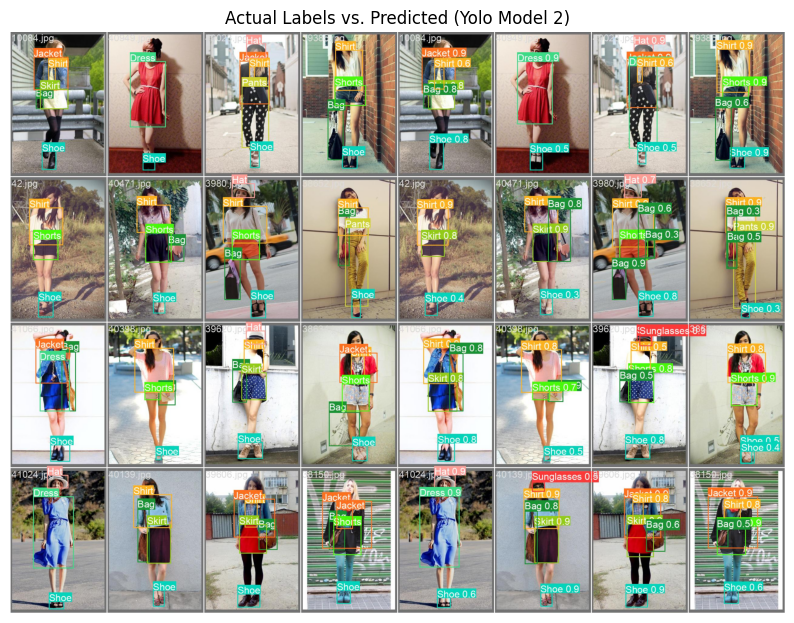

In [53]:
# Load the image
yolo2_pred = cv2.imread('/content/drive/MyDrive/yolo_runs2/runs2/detect/2nd yolo val/val_batch0_pred.jpg', -1)

# Convert BGR to RGB
yolo2_pred_rgb = cv2.cvtColor(yolo2_pred, cv2.COLOR_BGR2RGB)

actual_labels = cv2.imread('/content/drive/MyDrive/yolo_runs2/runs2/detect/1st yolo val/val_batch0_labels.jpg', -1)
actual_labels_rgb = cv2.cvtColor(actual_labels, cv2.COLOR_BGR2RGB)

# Combine the images side by side
combined_image = cv2.hconcat([actual_labels_rgb, yolo2_pred_rgb])
plt.figure(figsize=(10, 8))

# Display the combined image
plt.imshow(combined_image)
plt.axis("off")
plt.title("Actual Labels vs. Predicted (Yolo Model 2)")
plt.show()


image 1/1 /content/drive/MyDrive/people.jpg: 448x640 3 Jackets, 3 Shirts, 2 Pantss, 3 Shoes, 16.3ms
Speed: 2.7ms preprocess, 16.3ms inference, 2.3ms postprocess per image at shape (1, 3, 448, 640)


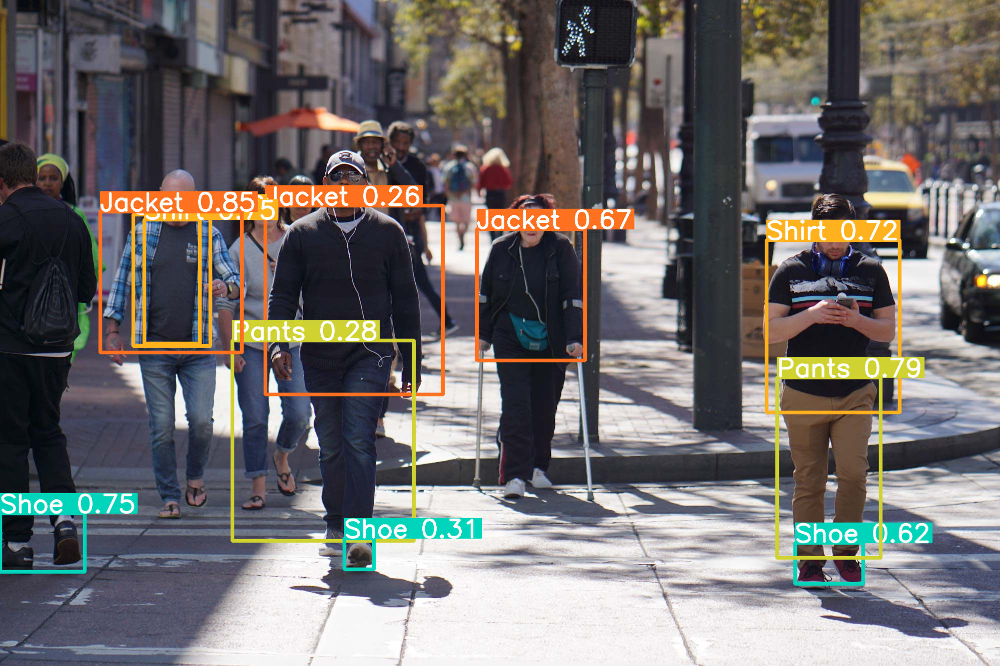

In [ ]:
# Testing model on real world image
from PIL import Image
results2 = yolo2("/content/drive/MyDrive/people.jpg")
for r in results2:
    im_array = r.plot()
    im = Image.fromarray(im_array[..., ::-1])
    display(im)

# Yolo Model 3 - 100 Epochs - Some Augmentation

In [ ]:
augmentation = '''
train: '/content/drive/My Drive/YoloProject/train'
val: '/content/drive/My Drive/YoloProject/test'

nc: 10
names: ['sunglass', 'hat', 'jacket', 'shirt', 'pants', 'shorts', 'skirt', 'dress', 'bag', 'shoe']

# Data Augmentation Parameters
augment:
  hue: 0.1
  saturation: 1.5
  exposure: 1.5
  mosaic: true
  mixup: true
  flipud: 0.5  # Probability of vertical flip
  fliplr: 0.5  # Probability of horizontal flip
  rotate: 10.0  # Rotate images within +/- 10 degrees
  '''

with open('/content/drive/My Drive/YoloProject/data4.yaml', 'w') as f:
  f.write(augmentation)

## Yolo 3 Training

In [ ]:
# Training Model
yolo3 = YOLO('yolov8m.pt')
yolo3.train(data='/content/drive/My Drive/YoloProject/data4.yaml', epochs=100)

Ultralytics YOLOv8.0.222 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
engine/trainer: task=detect, mode=train, model=yolov8m.pt, data=/content/drive/My Drive/YoloProject/data4.yaml, epochs=100, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train3, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=Tr

train: Scanning /content/drive/My Drive/YoloProject/train/labels.cache... 2143 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2143/2143 [00:00<?, ?it/s]


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/drive/My Drive/YoloProject/test/labels.cache... 536 images, 0 backgrounds, 0 corrupt: 100%|██████████| 536/536 [00:00<?, ?it/s]


Plotting labels to runs/detect/train3/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000714, momentum=0.9) with parameter groups 77 weight(decay=0.0), 84 weight(decay=0.0005), 83 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/train3
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      7.07G      1.302       1.83      1.425        117        640: 100%|██████████| 134/134 [00:30<00:00,  4.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:04<00:00,  4.09it/s]

                   all        536       2031       0.58      0.633      0.626      0.381



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      7.29G      1.259      1.259      1.385         88        640: 100%|██████████| 134/134 [00:26<00:00,  5.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.41it/s]


                   all        536       2031      0.596      0.684      0.675      0.429

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100       7.3G       1.27      1.232      1.403        103        640: 100%|██████████| 134/134 [00:26<00:00,  5.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.28it/s]


                   all        536       2031      0.607      0.694      0.676       0.41

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100       7.3G      1.271      1.188      1.399         98        640: 100%|██████████| 134/134 [00:25<00:00,  5.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:04<00:00,  4.20it/s]


                   all        536       2031      0.698        0.6      0.652        0.4

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      7.29G      1.265      1.149      1.394        122        640: 100%|██████████| 134/134 [00:25<00:00,  5.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:04<00:00,  4.21it/s]


                   all        536       2031      0.688      0.693      0.709      0.448

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      7.31G      1.231      1.101      1.377        112        640: 100%|██████████| 134/134 [00:25<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:04<00:00,  4.22it/s]


                   all        536       2031      0.758      0.682      0.733       0.46

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      7.29G      1.213      1.081      1.368        144        640: 100%|██████████| 134/134 [00:25<00:00,  5.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.38it/s]


                   all        536       2031      0.763      0.679       0.74      0.478

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      7.32G      1.184      1.025      1.352        140        640: 100%|██████████| 134/134 [00:25<00:00,  5.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.40it/s]


                   all        536       2031      0.717      0.722      0.748      0.482

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      7.33G      1.202       1.02      1.357         85        640: 100%|██████████| 134/134 [00:25<00:00,  5.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.37it/s]


                   all        536       2031      0.744      0.706      0.737      0.487

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      7.31G      1.159     0.9691      1.333        124        640: 100%|██████████| 134/134 [00:25<00:00,  5.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.50it/s]

                   all        536       2031      0.773      0.724       0.75      0.493



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      7.28G      1.152     0.9676      1.326        120        640: 100%|██████████| 134/134 [00:25<00:00,  5.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.44it/s]


                   all        536       2031       0.75      0.725       0.76      0.511

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      7.32G       1.13     0.9221      1.309        104        640: 100%|██████████| 134/134 [00:25<00:00,  5.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.38it/s]


                   all        536       2031      0.758      0.718      0.753      0.495

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100       7.3G      1.132     0.9218      1.317        102        640: 100%|██████████| 134/134 [00:25<00:00,  5.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.54it/s]


                   all        536       2031      0.755      0.725      0.777      0.507

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      7.31G      1.114     0.8886      1.297        100        640: 100%|██████████| 134/134 [00:25<00:00,  5.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.45it/s]

                   all        536       2031      0.753       0.75      0.777      0.513



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      7.33G        1.1     0.8734      1.286        122        640: 100%|██████████| 134/134 [00:25<00:00,  5.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.31it/s]


                   all        536       2031      0.727      0.754      0.771      0.507

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100       7.3G      1.097     0.8515      1.286         82        640: 100%|██████████| 134/134 [00:26<00:00,  5.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.31it/s]


                   all        536       2031      0.716      0.764      0.769      0.519

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      7.28G      1.067     0.8358       1.27        107        640: 100%|██████████| 134/134 [00:25<00:00,  5.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:04<00:00,  4.23it/s]

                   all        536       2031      0.738      0.754      0.778      0.525



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100       7.3G      1.067      0.843      1.273         84        640: 100%|██████████| 134/134 [00:25<00:00,  5.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.35it/s]


                   all        536       2031      0.765      0.744      0.776      0.523

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100       7.3G       1.06     0.8203      1.257        155        640: 100%|██████████| 134/134 [00:25<00:00,  5.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.44it/s]


                   all        536       2031      0.747      0.754      0.787      0.532

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      7.29G      1.057      0.803      1.261         93        640: 100%|██████████| 134/134 [00:25<00:00,  5.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.37it/s]

                   all        536       2031      0.745      0.771      0.782      0.533



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100       7.3G      1.038     0.7776      1.248        106        640: 100%|██████████| 134/134 [00:25<00:00,  5.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.31it/s]


                   all        536       2031      0.739      0.762      0.779      0.519

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      7.33G      1.038     0.7712       1.24        102        640: 100%|██████████| 134/134 [00:25<00:00,  5.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.40it/s]


                   all        536       2031      0.746      0.758      0.773      0.522

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100       7.3G      1.022      0.777      1.246        100        640: 100%|██████████| 134/134 [00:25<00:00,  5.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.60it/s]


                   all        536       2031      0.762      0.757      0.776      0.521

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      7.33G       1.03     0.7602      1.246         95        640: 100%|██████████| 134/134 [00:25<00:00,  5.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.43it/s]


                   all        536       2031      0.757      0.749      0.775      0.529

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      7.33G      1.003     0.7484      1.226         97        640: 100%|██████████| 134/134 [00:25<00:00,  5.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.46it/s]


                   all        536       2031      0.742      0.758      0.776      0.525

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      7.29G      1.007     0.7398       1.23        126        640: 100%|██████████| 134/134 [00:25<00:00,  5.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.38it/s]


                   all        536       2031      0.772      0.753      0.778      0.533

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      7.28G      1.002     0.7372      1.223        117        640: 100%|██████████| 134/134 [00:25<00:00,  5.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.30it/s]


                   all        536       2031      0.748      0.759      0.774      0.514

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      7.32G     0.9924     0.7218      1.221        110        640: 100%|██████████| 134/134 [00:25<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.41it/s]


                   all        536       2031      0.769      0.741      0.778       0.53

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      7.28G     0.9732     0.7055      1.206        113        640: 100%|██████████| 134/134 [00:25<00:00,  5.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.54it/s]


                   all        536       2031      0.746      0.761      0.789      0.532

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100       7.3G     0.9686     0.7056      1.204        102        640: 100%|██████████| 134/134 [00:25<00:00,  5.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.50it/s]


                   all        536       2031      0.734      0.768      0.775      0.524

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      7.31G     0.9637     0.6886      1.205        102        640: 100%|██████████| 134/134 [00:25<00:00,  5.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.57it/s]

                   all        536       2031      0.755      0.776      0.787      0.531



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      7.31G     0.9587     0.6827      1.192         90        640: 100%|██████████| 134/134 [00:25<00:00,  5.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.58it/s]

                   all        536       2031      0.765      0.751      0.781      0.533



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      7.28G     0.9469     0.6751       1.19        119        640: 100%|██████████| 134/134 [00:25<00:00,  5.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.56it/s]

                   all        536       2031      0.764      0.769      0.781      0.531



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100       7.3G     0.9519     0.6715      1.192        107        640: 100%|██████████| 134/134 [00:25<00:00,  5.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.35it/s]


                   all        536       2031      0.753      0.763       0.78      0.531

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      7.28G     0.9427     0.6608      1.182        110        640: 100%|██████████| 134/134 [00:25<00:00,  5.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:04<00:00,  4.17it/s]


                   all        536       2031      0.758      0.776      0.791      0.532

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100       7.3G     0.9306     0.6398      1.175        118        640: 100%|██████████| 134/134 [00:25<00:00,  5.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.38it/s]


                   all        536       2031      0.779      0.769      0.789      0.538

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100       7.3G     0.9234     0.6447      1.172        106        640: 100%|██████████| 134/134 [00:25<00:00,  5.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.48it/s]


                   all        536       2031      0.764       0.76      0.788      0.537

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100      7.31G     0.9128     0.6315      1.166        109        640: 100%|██████████| 134/134 [00:25<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.54it/s]


                   all        536       2031      0.763      0.754      0.783       0.53

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      7.33G     0.9188     0.6322      1.171        147        640: 100%|██████████| 134/134 [00:25<00:00,  5.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.48it/s]


                   all        536       2031       0.76      0.773      0.785      0.537

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      7.32G     0.9035     0.6199      1.168        117        640: 100%|██████████| 134/134 [00:25<00:00,  5.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.55it/s]


                   all        536       2031      0.759      0.756      0.776      0.532

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100       7.3G     0.8977      0.622      1.156        118        640: 100%|██████████| 134/134 [00:25<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.64it/s]


                   all        536       2031      0.732      0.768       0.78      0.533

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100       7.3G     0.8879     0.6075      1.151        128        640: 100%|██████████| 134/134 [00:25<00:00,  5.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.50it/s]


                   all        536       2031      0.763       0.77      0.788      0.534

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100       7.3G     0.8889     0.6005      1.156        105        640: 100%|██████████| 134/134 [00:25<00:00,  5.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.37it/s]


                   all        536       2031      0.738      0.766      0.772      0.523

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100       7.3G     0.8694     0.5933      1.136         98        640: 100%|██████████| 134/134 [00:25<00:00,  5.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.33it/s]


                   all        536       2031      0.763      0.766      0.774      0.523

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      7.29G     0.8793     0.5851      1.142        120        640: 100%|██████████| 134/134 [00:25<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.47it/s]


                   all        536       2031      0.773      0.759      0.772      0.528

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100       7.3G     0.8686     0.5807      1.144        101        640: 100%|██████████| 134/134 [00:25<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.50it/s]


                   all        536       2031      0.772      0.757      0.786      0.535

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100      7.29G     0.8542     0.5709       1.13         97        640: 100%|██████████| 134/134 [00:25<00:00,  5.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.54it/s]


                   all        536       2031      0.759       0.76      0.774      0.531

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100       7.3G     0.8514      0.571      1.135        105        640: 100%|██████████| 134/134 [00:25<00:00,  5.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.51it/s]

                   all        536       2031      0.771      0.768      0.793      0.532



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100       7.3G      0.847     0.5612      1.123        113        640: 100%|██████████| 134/134 [00:25<00:00,  5.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.59it/s]


                   all        536       2031      0.765      0.732      0.764      0.523

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100      7.31G     0.8348      0.549       1.12        107        640: 100%|██████████| 134/134 [00:25<00:00,  5.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.39it/s]

                   all        536       2031      0.763       0.76       0.78      0.529



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      7.29G     0.8295     0.5442      1.112         88        640: 100%|██████████| 134/134 [00:25<00:00,  5.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.36it/s]

                   all        536       2031      0.779      0.764      0.783      0.529



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100      7.29G     0.8239     0.5431      1.106         98        640: 100%|██████████| 134/134 [00:25<00:00,  5.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.35it/s]

                   all        536       2031      0.786       0.76      0.789      0.536



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100      7.32G     0.8192     0.5333      1.108        108        640: 100%|██████████| 134/134 [00:25<00:00,  5.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.35it/s]


                   all        536       2031      0.788      0.747      0.777      0.529

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100       7.3G     0.8108     0.5259      1.101         89        640: 100%|██████████| 134/134 [00:25<00:00,  5.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.51it/s]


                   all        536       2031      0.798      0.748      0.789      0.533

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100       7.3G     0.8063     0.5286      1.099        101        640: 100%|██████████| 134/134 [00:25<00:00,  5.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.61it/s]

                   all        536       2031      0.749      0.765      0.782      0.534



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100      7.29G     0.7978     0.5213       1.09        104        640: 100%|██████████| 134/134 [00:25<00:00,  5.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.59it/s]

                   all        536       2031      0.785      0.769      0.786      0.528



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100       7.3G     0.7911     0.5145      1.089        116        640: 100%|██████████| 134/134 [00:25<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.57it/s]


                   all        536       2031      0.773      0.759      0.783      0.529

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100      7.29G     0.7862     0.5123      1.083         85        640: 100%|██████████| 134/134 [00:25<00:00,  5.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.55it/s]


                   all        536       2031       0.78      0.772      0.794      0.539

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      7.29G     0.7791     0.5052      1.079        126        640: 100%|██████████| 134/134 [00:25<00:00,  5.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.52it/s]

                   all        536       2031      0.756      0.772      0.783      0.529



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100      7.29G     0.7718     0.4988      1.076        111        640: 100%|██████████| 134/134 [00:25<00:00,  5.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.38it/s]


                   all        536       2031      0.788      0.747      0.779      0.527

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100      7.29G     0.7688     0.4998       1.07         95        640: 100%|██████████| 134/134 [00:25<00:00,  5.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.28it/s]


                   all        536       2031       0.76      0.756      0.777      0.529

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100      7.29G     0.7624     0.4956      1.069         83        640: 100%|██████████| 134/134 [00:25<00:00,  5.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.47it/s]

                   all        536       2031      0.775      0.751      0.777      0.529



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100      7.29G     0.7542     0.4811      1.059         95        640: 100%|██████████| 134/134 [00:25<00:00,  5.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.46it/s]


                   all        536       2031      0.755      0.777      0.785       0.53

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100       7.3G     0.7375     0.4735      1.051        128        640: 100%|██████████| 134/134 [00:25<00:00,  5.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.53it/s]

                   all        536       2031      0.784      0.744       0.78      0.527



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      7.29G      0.742     0.4795       1.06        112        640: 100%|██████████| 134/134 [00:25<00:00,  5.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.50it/s]

                   all        536       2031      0.762      0.772      0.774      0.524



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100      7.29G     0.7383     0.4694      1.058        111        640: 100%|██████████| 134/134 [00:25<00:00,  5.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.51it/s]


                   all        536       2031      0.771       0.77      0.779      0.528

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100      7.29G     0.7284      0.468      1.052        143        640: 100%|██████████| 134/134 [00:25<00:00,  5.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.42it/s]

                   all        536       2031      0.764      0.748      0.779      0.534



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100      7.32G     0.7246     0.4664      1.042        114        640: 100%|██████████| 134/134 [00:25<00:00,  5.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.37it/s]


                   all        536       2031      0.754      0.765      0.778      0.532

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      7.29G     0.7164     0.4556      1.042        115        640: 100%|██████████| 134/134 [00:26<00:00,  5.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:04<00:00,  4.24it/s]


                   all        536       2031      0.751      0.769      0.785      0.535

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100       7.3G     0.7133     0.4605      1.041        118        640: 100%|██████████| 134/134 [00:25<00:00,  5.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.42it/s]


                   all        536       2031      0.759      0.766      0.772      0.526

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100      7.29G     0.7019     0.4487      1.037        111        640: 100%|██████████| 134/134 [00:25<00:00,  5.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.46it/s]

                   all        536       2031      0.789      0.752      0.773      0.521



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100       7.3G     0.6938     0.4384      1.031        137        640: 100%|██████████| 134/134 [00:25<00:00,  5.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.47it/s]


                   all        536       2031      0.772      0.758      0.779      0.531

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100       7.3G     0.6942     0.4437      1.032        100        640: 100%|██████████| 134/134 [00:25<00:00,  5.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.42it/s]


                   all        536       2031      0.759      0.771      0.781      0.531

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100       7.3G     0.6956     0.4422      1.033         97        640: 100%|██████████| 134/134 [00:25<00:00,  5.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.56it/s]


                   all        536       2031      0.757      0.766       0.77      0.528

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100       7.3G     0.6877     0.4342      1.021        116        640: 100%|██████████| 134/134 [00:25<00:00,  5.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.32it/s]


                   all        536       2031      0.765       0.76      0.782      0.536

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100       7.3G     0.6798     0.4294      1.019        104        640: 100%|██████████| 134/134 [00:25<00:00,  5.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.31it/s]

                   all        536       2031      0.745      0.754      0.767      0.527



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100      7.29G     0.6824     0.4341      1.023        142        640: 100%|██████████| 134/134 [00:25<00:00,  5.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.29it/s]


                   all        536       2031      0.766      0.762      0.769      0.522

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100      7.32G     0.6643     0.4194      1.016        110        640: 100%|██████████| 134/134 [00:25<00:00,  5.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.40it/s]

                   all        536       2031      0.752      0.766      0.771      0.524



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100       7.3G     0.6607     0.4167       1.01        107        640: 100%|██████████| 134/134 [00:25<00:00,  5.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.50it/s]


                   all        536       2031       0.77      0.751      0.774      0.528

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100       7.3G     0.6536     0.4071      1.006        115        640: 100%|██████████| 134/134 [00:25<00:00,  5.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.53it/s]


                   all        536       2031      0.763      0.775      0.782      0.534

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100       7.3G      0.653     0.4099      1.006        109        640: 100%|██████████| 134/134 [00:25<00:00,  5.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.61it/s]

                   all        536       2031      0.774      0.761       0.78      0.534



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100      7.31G     0.6431     0.4047     0.9966        127        640: 100%|██████████| 134/134 [00:25<00:00,  5.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.62it/s]

                   all        536       2031      0.755      0.771      0.785      0.538



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100       7.3G     0.6429     0.4026     0.9974        147        640: 100%|██████████| 134/134 [00:25<00:00,  5.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.40it/s]


                   all        536       2031      0.774      0.745      0.776      0.533

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100      7.32G      0.633     0.3975     0.9975        117        640: 100%|██████████| 134/134 [00:25<00:00,  5.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.38it/s]


                   all        536       2031      0.754      0.765      0.777      0.536

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100      7.29G     0.6311     0.3975     0.9953        114        640: 100%|██████████| 134/134 [00:25<00:00,  5.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.41it/s]

                   all        536       2031      0.761      0.754      0.772      0.529



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100      7.33G     0.6286     0.3923     0.9952        110        640: 100%|██████████| 134/134 [00:25<00:00,  5.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.59it/s]

                   all        536       2031      0.758      0.757      0.775      0.532



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100       7.3G     0.6157     0.3847     0.9863        112        640: 100%|██████████| 134/134 [00:25<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.54it/s]

                   all        536       2031      0.765      0.761      0.776      0.534



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100       7.3G     0.6186     0.3863     0.9893        114        640: 100%|██████████| 134/134 [00:25<00:00,  5.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.58it/s]

                   all        536       2031      0.762      0.765      0.774      0.529



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100      7.28G     0.6069     0.3826     0.9814        122        640: 100%|██████████| 134/134 [00:25<00:00,  5.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.66it/s]

                   all        536       2031      0.795       0.75      0.781      0.537



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100       7.3G     0.6063     0.3785     0.9821        108        640: 100%|██████████| 134/134 [00:25<00:00,  5.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.59it/s]

                   all        536       2031      0.779      0.751      0.773      0.531


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100      7.33G     0.5415      0.293     0.9328         54        640: 100%|██████████| 134/134 [00:27<00:00,  4.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.61it/s]

                   all        536       2031      0.784      0.745       0.77      0.528



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100      7.31G     0.5213     0.2795     0.9186         54        640: 100%|██████████| 134/134 [00:25<00:00,  5.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.39it/s]


                   all        536       2031      0.776       0.75      0.778      0.535

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100      7.27G     0.5138     0.2763     0.9171         51        640: 100%|██████████| 134/134 [00:25<00:00,  5.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.43it/s]

                   all        536       2031      0.784      0.742      0.771      0.528



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100       7.3G     0.5099     0.2714     0.9162         55        640: 100%|██████████| 134/134 [00:25<00:00,  5.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.42it/s]


                   all        536       2031      0.754      0.765      0.771      0.529

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100      7.28G     0.5023      0.269     0.9137         47        640: 100%|██████████| 134/134 [00:25<00:00,  5.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.39it/s]


                   all        536       2031      0.758      0.766      0.777      0.532

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100       7.3G      0.493     0.2654     0.9087         51        640: 100%|██████████| 134/134 [00:25<00:00,  5.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.44it/s]


                   all        536       2031      0.759      0.767      0.771      0.527

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100      7.31G     0.4893      0.261     0.9057         58        640: 100%|██████████| 134/134 [00:25<00:00,  5.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.48it/s]


                   all        536       2031      0.763       0.76      0.773      0.527

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100      7.33G     0.4873     0.2592      0.899         56        640: 100%|██████████| 134/134 [00:25<00:00,  5.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.58it/s]


                   all        536       2031      0.781      0.754      0.776      0.531

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100       7.3G     0.4818     0.2565     0.9002         49        640: 100%|██████████| 134/134 [00:25<00:00,  5.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.54it/s]


                   all        536       2031      0.758      0.775      0.778      0.534

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100       7.3G     0.4849      0.258     0.9008         54        640: 100%|██████████| 134/134 [00:25<00:00,  5.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.56it/s]


                   all        536       2031      0.746       0.78      0.774      0.532

100 epochs completed in 0.859 hours.
Optimizer stripped from runs/detect/train3/weights/last.pt, 52.0MB
Optimizer stripped from runs/detect/train3/weights/best.pt, 52.0MB

Validating runs/detect/train3/weights/best.pt...
Ultralytics YOLOv8.0.222 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
Model summary (fused): 218 layers, 25845550 parameters, 0 gradients, 78.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:07<00:00,  2.21it/s]


                   all        536       2031       0.78      0.772      0.794      0.539
              sunglass        536         82      0.555      0.335      0.438      0.151
                   hat        536         76      0.784       0.75       0.77      0.436
                jacket        536        181      0.761      0.851      0.836      0.652
                 shirt        536        365       0.83       0.83      0.868      0.616
                 pants        536        114      0.905      0.919      0.956      0.767
                shorts        536        107       0.82      0.849      0.819      0.533
                 skirt        536        185      0.819      0.808      0.849      0.681
                 dress        536        128      0.728      0.875      0.832      0.673
                   bag        536        274      0.776      0.715      0.749       0.42
                  shoe        536        519      0.824      0.784      0.818      0.459
Speed: 0.1ms preproce

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7a1abc755cf0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.0

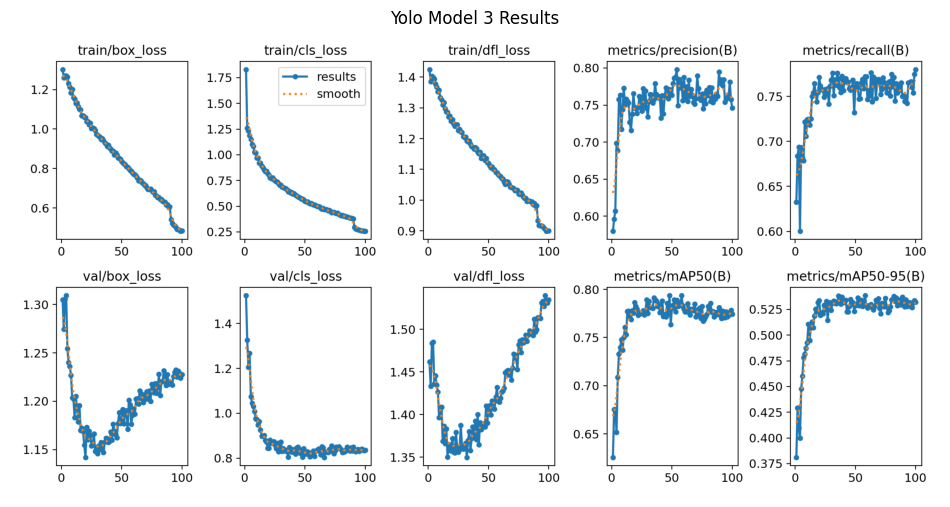

In [56]:
# Load image
yolo3_results = cv2.imread('/content/drive/MyDrive/yolo_runs2/runs2/detect/3rd yolo train/results.png', 1)

# Convert BGR to RGB
yolo3_results_rgb = cv2.cvtColor(yolo3_results, cv2.COLOR_BGR2RGB)

# Set a larger figure size for display
plt.figure(figsize=(12, 10))

# Display the image
plt.title("Yolo Model 3 Results")
plt.imshow(yolo3_results_rgb)
plt.axis("off")
plt.show()

## Yolo 3 Evaluation
- P: 0.777
- R: 0.77
-mAP50: 0.792
- mAP50-95: 0.538

In [ ]:
# Getting metrics
yolo3.val()

Ultralytics YOLOv8.0.222 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
Model summary (fused): 218 layers, 25845550 parameters, 0 gradients, 78.7 GFLOPs


val: Scanning /content/drive/My Drive/YoloProject/test/labels.cache... 536 images, 0 backgrounds, 0 corrupt: 100%|██████████| 536/536 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 34/34 [00:09<00:00,  3.66it/s]


                   all        536       2031      0.777       0.77      0.792      0.538
              sunglass        536         82      0.535      0.323      0.423       0.15
                   hat        536         76      0.781      0.751       0.77      0.433
                jacket        536        181      0.761      0.851      0.835      0.653
                 shirt        536        365       0.83       0.83      0.868      0.616
                 pants        536        114      0.905      0.919      0.956      0.765
                shorts        536        107      0.812      0.841      0.819      0.537
                 skirt        536        185      0.819      0.808      0.849       0.68
                 dress        536        128      0.728      0.875       0.83      0.672
                   bag        536        274      0.774      0.715       0.75      0.418
                  shoe        536        519      0.825      0.783      0.819      0.461
Speed: 0.1ms preproce

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7a18eba4a0b0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.0

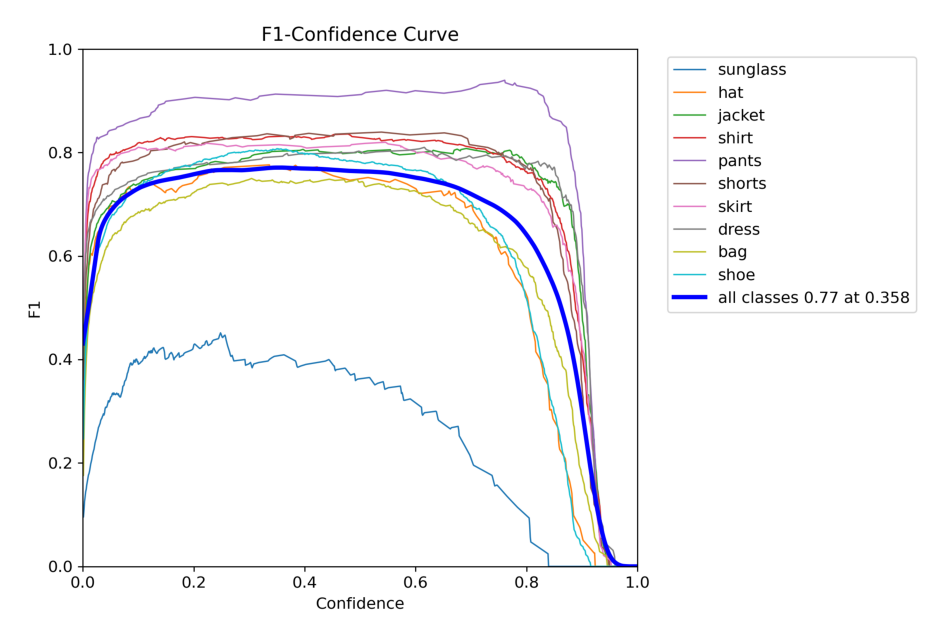

In [57]:
# Load image
yolo3_f1 = cv2.imread('/content/drive/MyDrive/yolo_runs2/runs2/detect/3rd yolo val/F1_curve.png', 1)

# Convert BGR to RGB
yolo3_f1_rgb = cv2.cvtColor(yolo3_f1, cv2.COLOR_BGR2RGB)

# Set a larger figure size for display
plt.figure(figsize=(12, 10))

# Display the image
plt.imshow(yolo3_f1_rgb)
plt.axis("off")
plt.show()

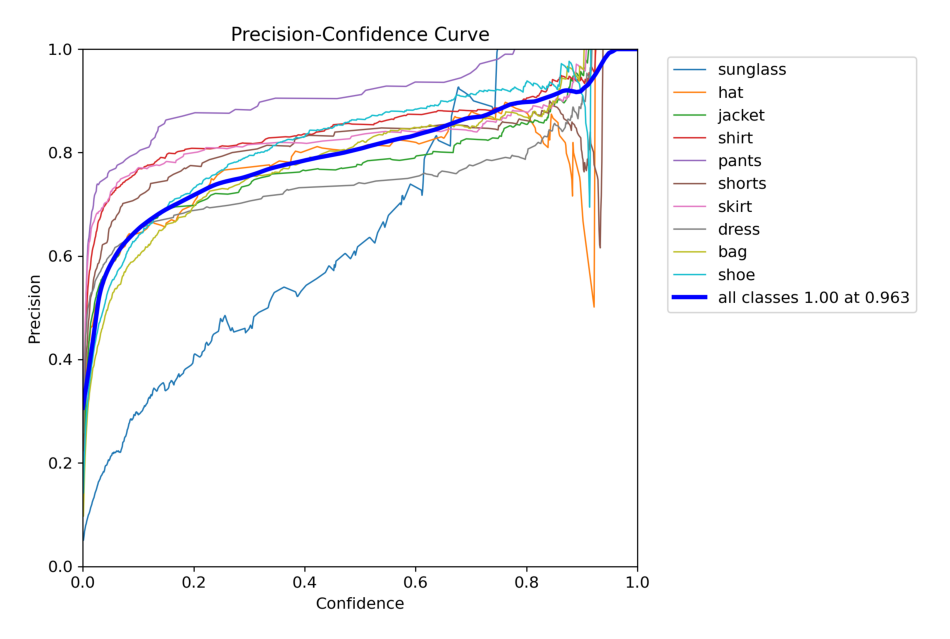

In [58]:
# Load image
yolo3_pc = cv2.imread('/content/drive/MyDrive/yolo_runs2/runs2/detect/3rd yolo val/P_curve.png', 1)

# Convert BGR to RGB
yolo3_pc_rgb = cv2.cvtColor(yolo3_pc, cv2.COLOR_BGR2RGB)

# Set a larger figure size for display
plt.figure(figsize=(12, 10))

# Display the image
plt.imshow(yolo3_pc_rgb)
plt.axis("off")
plt.show()

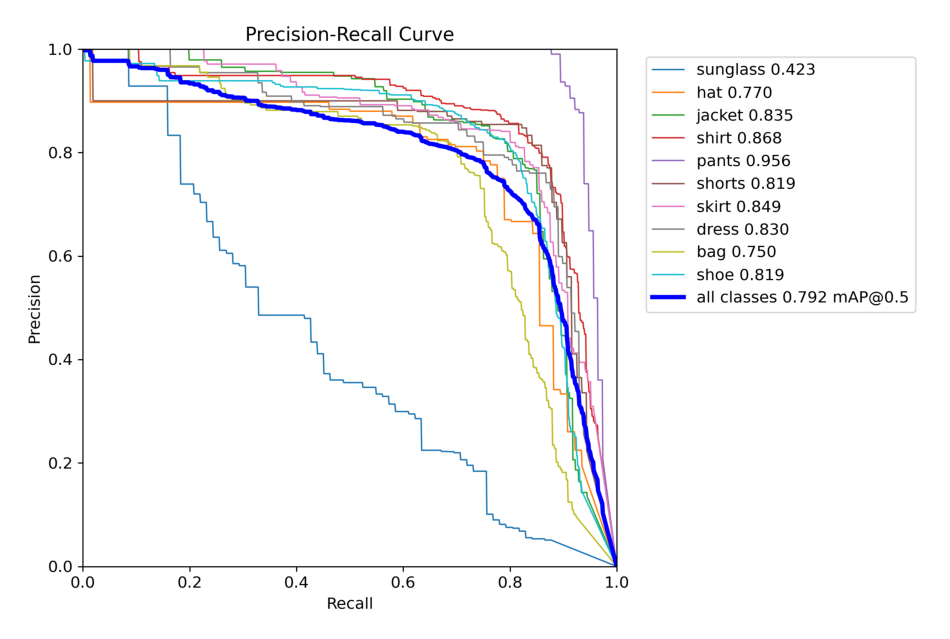

In [59]:
# Load image
yolo3_pr = cv2.imread('/content/drive/MyDrive/yolo_runs2/runs2/detect/3rd yolo val/PR_curve.png', 1)

# Convert BGR to RGB
yolo3_pr_rgb = cv2.cvtColor(yolo3_pr, cv2.COLOR_BGR2RGB)

# Set a larger figure size for display
plt.figure(figsize=(12, 10))

# Display the image
plt.imshow(yolo3_pr_rgb)
plt.axis("off")
plt.show()

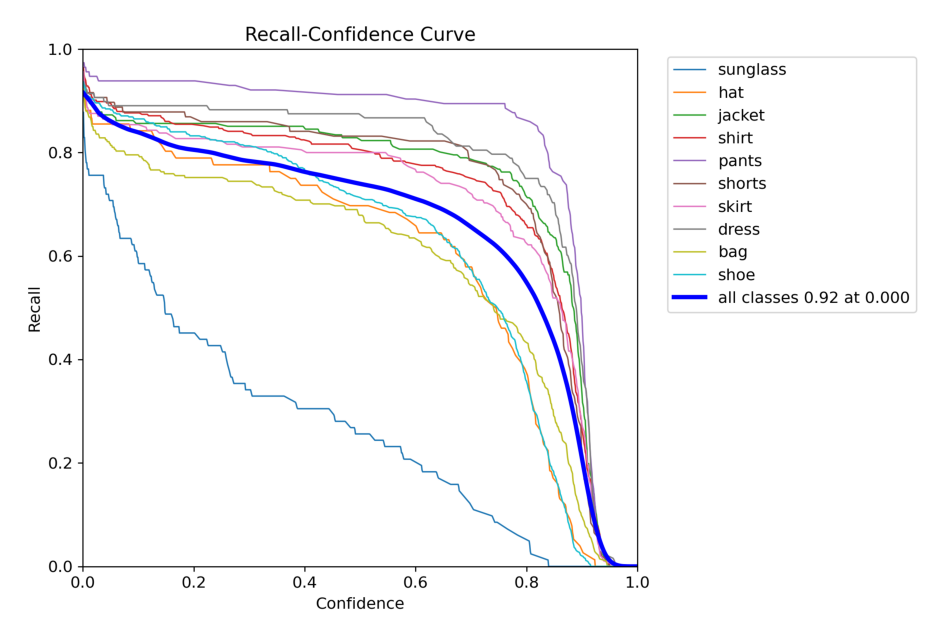

In [60]:
# Load image
yolo3_rm = cv2.imread('/content/drive/MyDrive/yolo_runs2/runs2/detect/3rd yolo val/R_curve.png', 1)

# Convert BGR to RGB
yolo3_rm_rgb = cv2.cvtColor(yolo3_rm, cv2.COLOR_BGR2RGB)

# Set a larger figure size for display
plt.figure(figsize=(12, 10))

# Display the image
plt.imshow(yolo3_rm_rgb)
plt.axis("off")
plt.show()

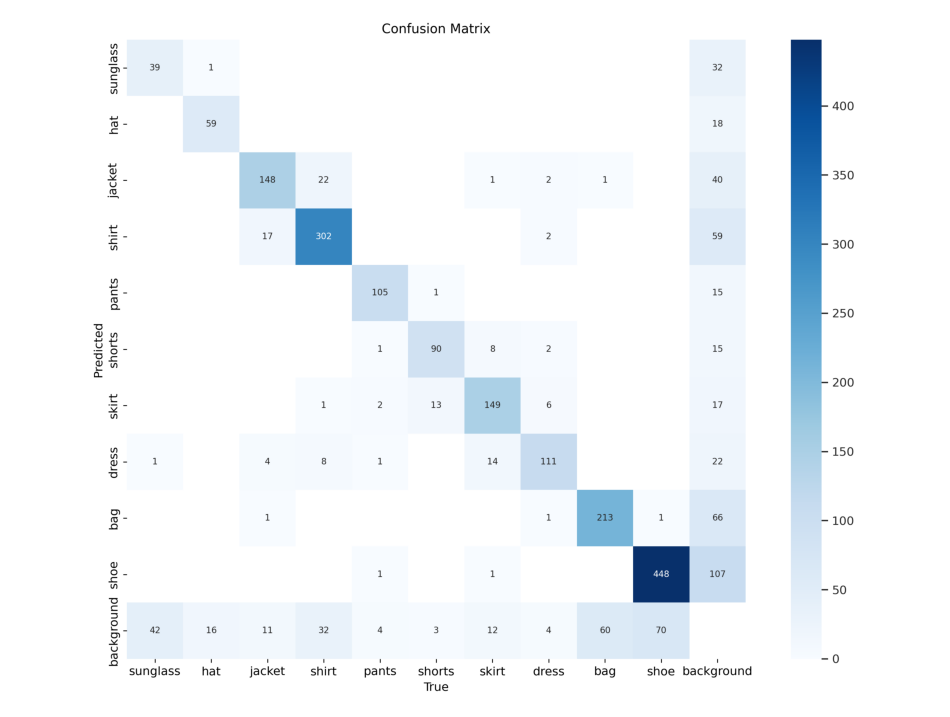

In [61]:
# Load image
yolo3_cm = cv2.imread('/content/drive/MyDrive/yolo_runs2/runs2/detect/3rd yolo val/confusion_matrix.png', 1)

# Convert BGR to RGB
yolo3_cm_rgb = cv2.cvtColor(yolo3_cm, cv2.COLOR_BGR2RGB)

# Set a larger figure size for display
plt.figure(figsize=(12, 10))

# Display the image
plt.imshow(yolo3_cm_rgb)
plt.axis("off")
plt.show()

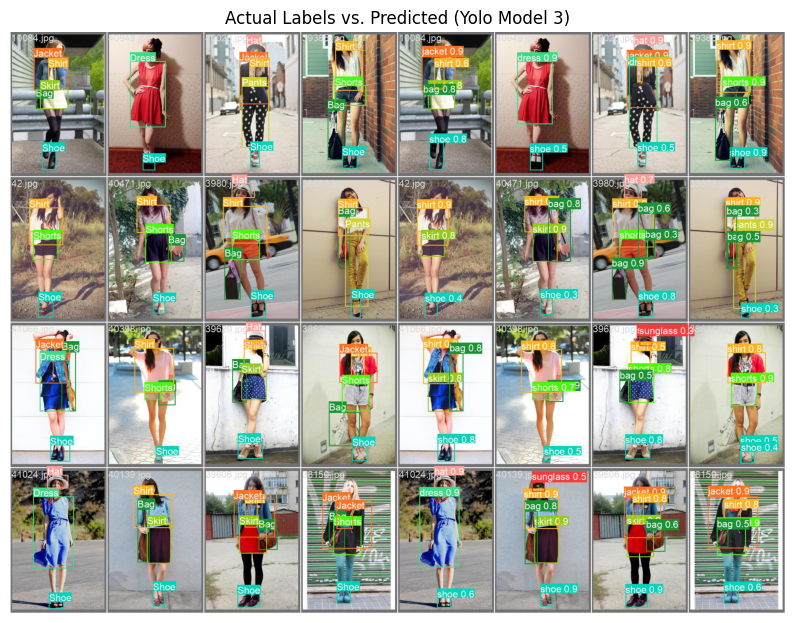

In [62]:
# Load the image
yolo3_pred = cv2.imread('/content/drive/MyDrive/yolo_runs2/runs2/detect/3rd yolo val/val_batch0_pred.jpg', -1)

# Convert BGR to RGB
yolo3_pred_rgb = cv2.cvtColor(yolo3_pred, cv2.COLOR_BGR2RGB)

actual_labels = cv2.imread('/content/drive/MyDrive/yolo_runs2/runs2/detect/1st yolo val/val_batch0_labels.jpg', -1)
actual_labels_rgb = cv2.cvtColor(actual_labels, cv2.COLOR_BGR2RGB)

# Combine the images side by side
combined_image = cv2.hconcat([actual_labels_rgb, yolo3_pred_rgb])
plt.figure(figsize=(10, 8))

# Display the combined image
plt.imshow(combined_image)
plt.axis("off")
plt.title("Actual Labels vs. Predicted (Yolo Model 3)")
plt.show()


image 1/1 /content/drive/MyDrive/people.jpg: 448x640 3 jackets, 2 shirts, 4 pantss, 1 bag, 3 shoes, 13.4ms
Speed: 6.1ms preprocess, 13.4ms inference, 2.4ms postprocess per image at shape (1, 3, 448, 640)


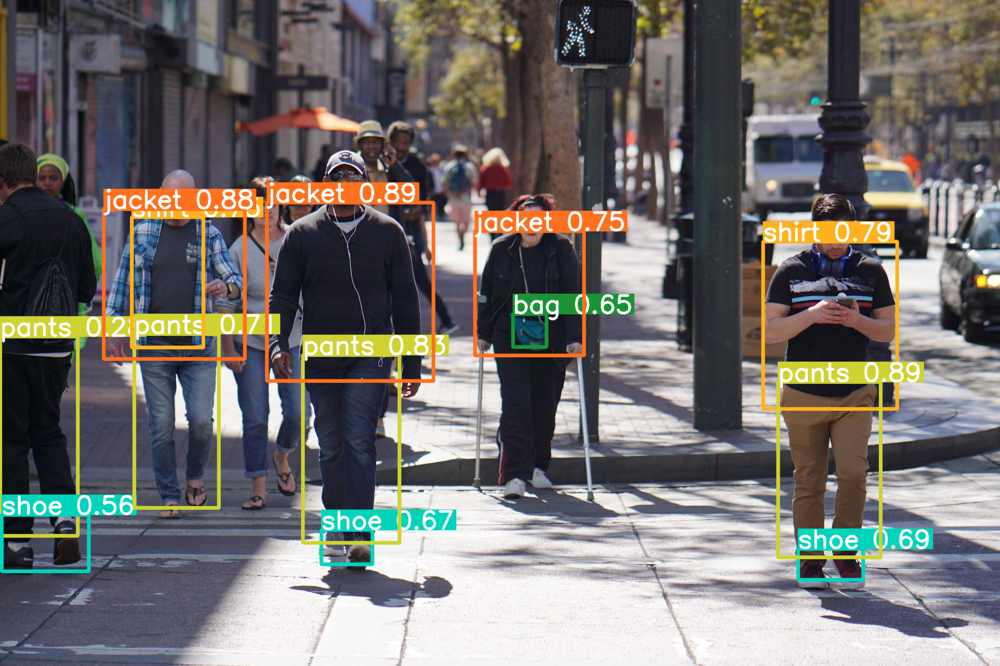

In [ ]:
# Testing model on real world data
from PIL import Image
results3 = yolo3("/content/drive/MyDrive/people.jpg")
for r in results3:
    im_array = r.plot()
    im = Image.fromarray(im_array[..., ::-1])
    display(im)

# YOLO Model 4 - 100 Epochs - More Augmentation

In [ ]:
augmentation2 = '''
train: '/content/drive/My Drive/YoloProject/train'
val: '/content/drive/My Drive/YoloProject/test'

nc: 10
names: ['sunglass', 'hat', 'jacket', 'shirt', 'pants', 'shorts', 'skirt', 'dress', 'bag', 'shoe']

# Data Augmentation Parameters
augment:
  hblur_limit: 1
  translate: 0.1
  scale: 0.2
  shear: 0.2
  perspective: 0.1
  flipud: 0.7
  fliplr: 0.5
  mosaic: 0.3
  mixup: 0.1
  brightness_contrast:
  brightness_limit: 0.1
  contrast_limit: 0.1
  horizontal_flip: true
  hue_shift_limit: 20
  sat_shift_limit: 50
  rotate: 10
  '''

with open('/content/drive/My Drive/YoloProject/data5.yaml', 'w') as f:
  f.write(augmentation2)

In [6]:
# Training model
yolo4 = YOLO('yolov8m.pt')
yolo4.train(data='/content/drive/My Drive/YoloProject/data5.yaml', epochs=100)

Ultralytics YOLOv8.0.222 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
engine/trainer: task=detect, mode=train, model=yolov8m.pt, data=/content/drive/My Drive/YoloProject/data5.yaml, epochs=100, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train6, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=Tr

train: Scanning /content/drive/My Drive/YoloProject/train/labels.cache... 2143 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2143/2143 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/drive/My Drive/YoloProject/test/labels.cache... 536 images, 0 backgrounds, 0 corrupt: 100%|██████████| 536/536 [00:00<?, ?it/s]


Plotting labels to runs/detect/train6/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000714, momentum=0.9) with parameter groups 77 weight(decay=0.0), 84 weight(decay=0.0005), 83 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/train6
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      7.08G      1.302       1.83      1.425        117        640: 100%|██████████| 134/134 [00:30<00:00,  4.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.36it/s]


                   all        536       2031       0.58      0.633      0.626      0.381

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      7.76G      1.259      1.259      1.385         88        640: 100%|██████████| 134/134 [00:26<00:00,  5.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.52it/s]


                   all        536       2031      0.596      0.684      0.675      0.429

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100       7.8G       1.27      1.232      1.403        103        640: 100%|██████████| 134/134 [00:25<00:00,  5.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.51it/s]


                   all        536       2031      0.607      0.694      0.676       0.41

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100       7.8G      1.271      1.188      1.399         98        640: 100%|██████████| 134/134 [00:25<00:00,  5.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.37it/s]


                   all        536       2031      0.698        0.6      0.652        0.4

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      7.79G      1.265      1.149      1.394        122        640: 100%|██████████| 134/134 [00:25<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.57it/s]


                   all        536       2031      0.688      0.693      0.709      0.448

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      7.78G      1.231      1.101      1.377        112        640: 100%|██████████| 134/134 [00:25<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.41it/s]


                   all        536       2031      0.758      0.682      0.733       0.46

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100       7.8G      1.213      1.081      1.368        144        640: 100%|██████████| 134/134 [00:25<00:00,  5.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.38it/s]


                   all        536       2031      0.763      0.679       0.74      0.478

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      7.79G      1.184      1.025      1.352        140        640: 100%|██████████| 134/134 [00:25<00:00,  5.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.60it/s]


                   all        536       2031      0.717      0.722      0.748      0.482

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      7.79G      1.202       1.02      1.357         85        640: 100%|██████████| 134/134 [00:25<00:00,  5.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.36it/s]


                   all        536       2031      0.744      0.706      0.737      0.487

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      7.79G      1.159     0.9691      1.333        124        640: 100%|██████████| 134/134 [00:25<00:00,  5.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:04<00:00,  4.19it/s]

                   all        536       2031      0.773      0.724       0.75      0.493



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      7.81G      1.152     0.9676      1.326        120        640: 100%|██████████| 134/134 [00:25<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.56it/s]


                   all        536       2031       0.75      0.725       0.76      0.511

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      7.79G       1.13     0.9221      1.309        104        640: 100%|██████████| 134/134 [00:25<00:00,  5.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.43it/s]


                   all        536       2031      0.758      0.718      0.753      0.495

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      7.82G      1.132     0.9218      1.317        102        640: 100%|██████████| 134/134 [00:25<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.38it/s]


                   all        536       2031      0.755      0.725      0.777      0.507

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      7.79G      1.114     0.8886      1.297        100        640: 100%|██████████| 134/134 [00:25<00:00,  5.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.50it/s]


                   all        536       2031      0.753       0.75      0.777      0.513

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      7.78G        1.1     0.8734      1.286        122        640: 100%|██████████| 134/134 [00:25<00:00,  5.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:04<00:00,  4.17it/s]


                   all        536       2031      0.727      0.754      0.771      0.507

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100       7.8G      1.097     0.8515      1.286         82        640: 100%|██████████| 134/134 [00:25<00:00,  5.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.52it/s]


                   all        536       2031      0.716      0.764      0.769      0.519

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100       7.8G      1.067     0.8358       1.27        107        640: 100%|██████████| 134/134 [00:25<00:00,  5.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.55it/s]


                   all        536       2031      0.738      0.754      0.778      0.525

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      7.83G      1.067      0.843      1.273         84        640: 100%|██████████| 134/134 [00:25<00:00,  5.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.25it/s]


                   all        536       2031      0.765      0.744      0.776      0.523

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      7.81G       1.06     0.8203      1.257        155        640: 100%|██████████| 134/134 [00:25<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.49it/s]


                   all        536       2031      0.747      0.754      0.787      0.532

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      7.81G      1.057      0.803      1.261         93        640: 100%|██████████| 134/134 [00:25<00:00,  5.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:04<00:00,  4.24it/s]


                   all        536       2031      0.745      0.771      0.782      0.533

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      7.76G      1.038     0.7776      1.248        106        640: 100%|██████████| 134/134 [00:25<00:00,  5.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.25it/s]


                   all        536       2031      0.739      0.762      0.779      0.519

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      7.77G      1.038     0.7712       1.24        102        640: 100%|██████████| 134/134 [00:25<00:00,  5.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.59it/s]


                   all        536       2031      0.746      0.758      0.773      0.522

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      7.79G      1.022      0.777      1.246        100        640: 100%|██████████| 134/134 [00:25<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.48it/s]


                   all        536       2031      0.762      0.757      0.776      0.521

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      7.81G       1.03     0.7602      1.246         95        640: 100%|██████████| 134/134 [00:25<00:00,  5.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.40it/s]


                   all        536       2031      0.757      0.749      0.775      0.529

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      7.79G      1.003     0.7484      1.226         97        640: 100%|██████████| 134/134 [00:25<00:00,  5.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.64it/s]


                   all        536       2031      0.742      0.758      0.776      0.525

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      7.81G      1.007     0.7398       1.23        126        640: 100%|██████████| 134/134 [00:25<00:00,  5.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.51it/s]


                   all        536       2031      0.772      0.753      0.778      0.533

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      7.78G      1.002     0.7372      1.223        117        640: 100%|██████████| 134/134 [00:25<00:00,  5.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.29it/s]

                   all        536       2031      0.748      0.759      0.774      0.514



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100       7.8G     0.9924     0.7218      1.221        110        640: 100%|██████████| 134/134 [00:25<00:00,  5.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.60it/s]

                   all        536       2031      0.769      0.741      0.778       0.53



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100       7.8G     0.9732     0.7055      1.206        113        640: 100%|██████████| 134/134 [00:25<00:00,  5.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.39it/s]

                   all        536       2031      0.746      0.761      0.789      0.532



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100       7.8G     0.9686     0.7056      1.204        102        640: 100%|██████████| 134/134 [00:25<00:00,  5.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:04<00:00,  3.91it/s]

                   all        536       2031      0.734      0.768      0.775      0.524



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      7.79G     0.9637     0.6886      1.205        102        640: 100%|██████████| 134/134 [00:25<00:00,  5.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.61it/s]


                   all        536       2031      0.755      0.776      0.787      0.531

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      7.78G     0.9587     0.6827      1.192         90        640: 100%|██████████| 134/134 [00:25<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:04<00:00,  4.24it/s]


                   all        536       2031      0.765      0.751      0.781      0.533

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      7.75G     0.9469     0.6751       1.19        119        640: 100%|██████████| 134/134 [00:25<00:00,  5.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.36it/s]

                   all        536       2031      0.764      0.769      0.781      0.531



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100      7.81G     0.9519     0.6715      1.192        107        640: 100%|██████████| 134/134 [00:25<00:00,  5.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.50it/s]


                   all        536       2031      0.753      0.763       0.78      0.531

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      7.81G     0.9427     0.6608      1.182        110        640: 100%|██████████| 134/134 [00:26<00:00,  5.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:04<00:00,  4.23it/s]

                   all        536       2031      0.758      0.776      0.791      0.532



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      7.77G     0.9306     0.6398      1.175        118        640: 100%|██████████| 134/134 [00:25<00:00,  5.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.65it/s]


                   all        536       2031      0.779      0.769      0.789      0.538

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      7.78G     0.9234     0.6447      1.172        106        640: 100%|██████████| 134/134 [00:25<00:00,  5.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:04<00:00,  4.21it/s]


                   all        536       2031      0.764       0.76      0.788      0.537

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100      7.78G     0.9128     0.6315      1.166        109        640: 100%|██████████| 134/134 [00:25<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:04<00:00,  4.17it/s]


                   all        536       2031      0.763      0.754      0.783       0.53

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      7.76G     0.9188     0.6322      1.171        147        640: 100%|██████████| 134/134 [00:25<00:00,  5.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.51it/s]


                   all        536       2031       0.76      0.773      0.785      0.537

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      7.79G     0.9035     0.6199      1.168        117        640: 100%|██████████| 134/134 [00:25<00:00,  5.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.30it/s]


                   all        536       2031      0.759      0.756      0.776      0.532

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100       7.8G     0.8977      0.622      1.156        118        640: 100%|██████████| 134/134 [00:25<00:00,  5.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.46it/s]


                   all        536       2031      0.732      0.768       0.78      0.533

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100       7.8G     0.8879     0.6075      1.151        128        640: 100%|██████████| 134/134 [00:25<00:00,  5.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.59it/s]

                   all        536       2031      0.763       0.77      0.788      0.534



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      7.77G     0.8889     0.6005      1.156        105        640: 100%|██████████| 134/134 [00:25<00:00,  5.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.30it/s]

                   all        536       2031      0.738      0.766      0.772      0.523



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100       7.8G     0.8694     0.5933      1.136         98        640: 100%|██████████| 134/134 [00:25<00:00,  5.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.40it/s]


                   all        536       2031      0.763      0.766      0.774      0.523

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      7.76G     0.8793     0.5851      1.142        120        640: 100%|██████████| 134/134 [00:25<00:00,  5.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.63it/s]


                   all        536       2031      0.773      0.759      0.772      0.528

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100       7.8G     0.8686     0.5807      1.144        101        640: 100%|██████████| 134/134 [00:25<00:00,  5.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.41it/s]

                   all        536       2031      0.772      0.757      0.786      0.535



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100       7.8G     0.8542     0.5709       1.13         97        640: 100%|██████████| 134/134 [00:25<00:00,  5.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.52it/s]


                   all        536       2031      0.759       0.76      0.774      0.531

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100       7.8G     0.8514      0.571      1.135        105        640: 100%|██████████| 134/134 [00:25<00:00,  5.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.59it/s]


                   all        536       2031      0.771      0.768      0.793      0.532

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      7.79G      0.847     0.5612      1.123        113        640: 100%|██████████| 134/134 [00:25<00:00,  5.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.29it/s]


                   all        536       2031      0.765      0.732      0.764      0.523

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100      7.81G     0.8348      0.549       1.12        107        640: 100%|██████████| 134/134 [00:25<00:00,  5.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.50it/s]


                   all        536       2031      0.763       0.76       0.78      0.529

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      7.79G     0.8295     0.5442      1.112         88        640: 100%|██████████| 134/134 [00:25<00:00,  5.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.47it/s]


                   all        536       2031      0.779      0.764      0.783      0.529

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100      7.79G     0.8239     0.5431      1.106         98        640: 100%|██████████| 134/134 [00:25<00:00,  5.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.38it/s]


                   all        536       2031      0.786       0.76      0.789      0.536

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100      7.76G     0.8192     0.5333      1.108        108        640: 100%|██████████| 134/134 [00:25<00:00,  5.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.56it/s]

                   all        536       2031      0.788      0.747      0.777      0.529



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100       7.8G     0.8108     0.5259      1.101         89        640: 100%|██████████| 134/134 [00:25<00:00,  5.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.27it/s]

                   all        536       2031      0.798      0.748      0.789      0.533



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100       7.8G     0.8063     0.5286      1.099        101        640: 100%|██████████| 134/134 [00:25<00:00,  5.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:04<00:00,  4.14it/s]

                   all        536       2031      0.749      0.765      0.782      0.534



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100       7.8G     0.7978     0.5213       1.09        104        640: 100%|██████████| 134/134 [00:25<00:00,  5.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.56it/s]

                   all        536       2031      0.785      0.769      0.786      0.528



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100      7.76G     0.7911     0.5145      1.089        116        640: 100%|██████████| 134/134 [00:25<00:00,  5.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.45it/s]


                   all        536       2031      0.773      0.759      0.783      0.529

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100       7.8G     0.7862     0.5123      1.083         85        640: 100%|██████████| 134/134 [00:25<00:00,  5.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.42it/s]


                   all        536       2031       0.78      0.772      0.794      0.539

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      7.78G     0.7791     0.5052      1.079        126        640: 100%|██████████| 134/134 [00:25<00:00,  5.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.58it/s]


                   all        536       2031      0.756      0.772      0.783      0.529

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100      7.79G     0.7718     0.4988      1.076        111        640: 100%|██████████| 134/134 [00:26<00:00,  5.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.63it/s]

                   all        536       2031      0.788      0.747      0.779      0.527



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100      7.81G     0.7688     0.4998       1.07         95        640: 100%|██████████| 134/134 [00:25<00:00,  5.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.37it/s]


                   all        536       2031       0.76      0.756      0.777      0.529

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100      7.77G     0.7624     0.4956      1.069         83        640: 100%|██████████| 134/134 [00:25<00:00,  5.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.56it/s]

                   all        536       2031      0.775      0.751      0.777      0.529



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100      7.79G     0.7542     0.4811      1.059         95        640: 100%|██████████| 134/134 [00:26<00:00,  5.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.47it/s]


                   all        536       2031      0.755      0.777      0.785       0.53

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100      7.78G     0.7375     0.4735      1.051        128        640: 100%|██████████| 134/134 [00:25<00:00,  5.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.41it/s]


                   all        536       2031      0.784      0.744       0.78      0.527

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      7.79G      0.742     0.4795       1.06        112        640: 100%|██████████| 134/134 [00:25<00:00,  5.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.67it/s]

                   all        536       2031      0.762      0.772      0.774      0.524



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100       7.8G     0.7383     0.4694      1.058        111        640: 100%|██████████| 134/134 [00:25<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.37it/s]


                   all        536       2031      0.771       0.77      0.779      0.528

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100      7.79G     0.7284      0.468      1.052        143        640: 100%|██████████| 134/134 [00:25<00:00,  5.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.51it/s]


                   all        536       2031      0.764      0.748      0.779      0.534

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100      7.82G     0.7246     0.4664      1.042        114        640: 100%|██████████| 134/134 [00:25<00:00,  5.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.57it/s]


                   all        536       2031      0.754      0.765      0.778      0.532

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      7.79G     0.7164     0.4556      1.042        115        640: 100%|██████████| 134/134 [00:25<00:00,  5.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.44it/s]


                   all        536       2031      0.751      0.769      0.785      0.535

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100      7.83G     0.7133     0.4605      1.041        118        640: 100%|██████████| 134/134 [00:25<00:00,  5.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:04<00:00,  3.93it/s]

                   all        536       2031      0.759      0.766      0.772      0.526



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100       7.8G     0.7019     0.4487      1.037        111        640: 100%|██████████| 134/134 [00:25<00:00,  5.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:04<00:00,  3.50it/s]

                   all        536       2031      0.789      0.752      0.773      0.521



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100      7.81G     0.6938     0.4384      1.031        137        640: 100%|██████████| 134/134 [00:25<00:00,  5.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:04<00:00,  4.23it/s]


                   all        536       2031      0.772      0.758      0.779      0.531

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100       7.8G     0.6942     0.4437      1.032        100        640: 100%|██████████| 134/134 [00:25<00:00,  5.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.47it/s]

                   all        536       2031      0.759      0.771      0.781      0.531



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100      7.79G     0.6956     0.4422      1.033         97        640: 100%|██████████| 134/134 [00:25<00:00,  5.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.57it/s]

                   all        536       2031      0.757      0.766       0.77      0.528



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100       7.8G     0.6877     0.4342      1.021        116        640: 100%|██████████| 134/134 [00:26<00:00,  5.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.36it/s]

                   all        536       2031      0.765       0.76      0.782      0.536



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100      7.78G     0.6798     0.4294      1.019        104        640: 100%|██████████| 134/134 [00:25<00:00,  5.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.50it/s]

                   all        536       2031      0.745      0.754      0.767      0.527



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100      7.79G     0.6824     0.4341      1.023        142        640: 100%|██████████| 134/134 [00:26<00:00,  5.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.50it/s]

                   all        536       2031      0.766      0.762      0.769      0.522



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100      7.79G     0.6643     0.4194      1.016        110        640: 100%|██████████| 134/134 [00:25<00:00,  5.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.32it/s]

                   all        536       2031      0.752      0.766      0.771      0.524



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100      7.77G     0.6607     0.4167       1.01        107        640: 100%|██████████| 134/134 [00:25<00:00,  5.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.57it/s]

                   all        536       2031       0.77      0.751      0.774      0.528



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100      7.79G     0.6536     0.4071      1.006        115        640: 100%|██████████| 134/134 [00:26<00:00,  5.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.36it/s]


                   all        536       2031      0.763      0.775      0.782      0.534

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100       7.8G      0.653     0.4099      1.006        109        640: 100%|██████████| 134/134 [00:25<00:00,  5.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.37it/s]


                   all        536       2031      0.774      0.761       0.78      0.534

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100       7.8G     0.6431     0.4047     0.9966        127        640: 100%|██████████| 134/134 [00:25<00:00,  5.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.44it/s]

                   all        536       2031      0.755      0.771      0.785      0.538



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100      7.79G     0.6429     0.4026     0.9974        147        640: 100%|██████████| 134/134 [00:25<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.31it/s]

                   all        536       2031      0.774      0.745      0.776      0.533



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100      7.78G      0.633     0.3975     0.9975        117        640: 100%|██████████| 134/134 [00:25<00:00,  5.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:04<00:00,  4.21it/s]

                   all        536       2031      0.754      0.765      0.777      0.536



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100      7.76G     0.6311     0.3975     0.9953        114        640: 100%|██████████| 134/134 [00:25<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:04<00:00,  4.16it/s]

                   all        536       2031      0.761      0.754      0.772      0.529



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100      7.81G     0.6286     0.3923     0.9952        110        640: 100%|██████████| 134/134 [00:25<00:00,  5.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.34it/s]


                   all        536       2031      0.758      0.757      0.775      0.532

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100      7.79G     0.6157     0.3847     0.9863        112        640: 100%|██████████| 134/134 [00:25<00:00,  5.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.43it/s]


                   all        536       2031      0.765      0.761      0.776      0.534

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100       7.8G     0.6186     0.3863     0.9893        114        640: 100%|██████████| 134/134 [00:25<00:00,  5.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.61it/s]


                   all        536       2031      0.762      0.765      0.774      0.529

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100      7.78G     0.6069     0.3826     0.9814        122        640: 100%|██████████| 134/134 [00:25<00:00,  5.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.28it/s]

                   all        536       2031      0.795       0.75      0.781      0.537



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100       7.8G     0.6063     0.3785     0.9821        108        640: 100%|██████████| 134/134 [00:26<00:00,  5.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.33it/s]

                   all        536       2031      0.779      0.751      0.773      0.531


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100      7.77G     0.5415      0.293     0.9328         54        640: 100%|██████████| 134/134 [00:27<00:00,  4.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.43it/s]

                   all        536       2031      0.784      0.745       0.77      0.528



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100       7.8G     0.5213     0.2795     0.9186         54        640: 100%|██████████| 134/134 [00:25<00:00,  5.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.43it/s]

                   all        536       2031      0.776       0.75      0.778      0.535



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100      7.79G     0.5138     0.2763     0.9171         51        640: 100%|██████████| 134/134 [00:25<00:00,  5.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.40it/s]

                   all        536       2031      0.784      0.742      0.771      0.528



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100       7.8G     0.5099     0.2714     0.9162         55        640: 100%|██████████| 134/134 [00:25<00:00,  5.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.55it/s]


                   all        536       2031      0.754      0.765      0.771      0.529

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100      7.79G     0.5023      0.269     0.9137         47        640: 100%|██████████| 134/134 [00:25<00:00,  5.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:04<00:00,  4.22it/s]


                   all        536       2031      0.758      0.766      0.777      0.532

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100      7.83G      0.493     0.2654     0.9087         51        640: 100%|██████████| 134/134 [00:25<00:00,  5.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:04<00:00,  4.22it/s]


                   all        536       2031      0.759      0.767      0.771      0.527

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100      7.81G     0.4893      0.261     0.9057         58        640: 100%|██████████| 134/134 [00:25<00:00,  5.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.59it/s]


                   all        536       2031      0.763       0.76      0.773      0.527

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100      7.79G     0.4873     0.2592      0.899         56        640: 100%|██████████| 134/134 [00:25<00:00,  5.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.46it/s]

                   all        536       2031      0.781      0.754      0.776      0.531



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100      7.81G     0.4818     0.2565     0.9002         49        640: 100%|██████████| 134/134 [00:25<00:00,  5.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.50it/s]


                   all        536       2031      0.758      0.775      0.778      0.534

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100      7.81G     0.4849      0.258     0.9008         54        640: 100%|██████████| 134/134 [00:25<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:04<00:00,  4.23it/s]

                   all        536       2031      0.746       0.78      0.774      0.532



100 epochs completed in 0.859 hours.
Optimizer stripped from runs/detect/train6/weights/last.pt, 52.0MB
Optimizer stripped from runs/detect/train6/weights/best.pt, 52.0MB

Validating runs/detect/train6/weights/best.pt...
Ultralytics YOLOv8.0.222 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
Model summary (fused): 218 layers, 25845550 parameters, 0 gradients, 78.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:07<00:00,  2.13it/s]


                   all        536       2031       0.78      0.772      0.794      0.539
              sunglass        536         82      0.555      0.335      0.438      0.151
                   hat        536         76      0.784       0.75       0.77      0.436
                jacket        536        181      0.761      0.851      0.836      0.652
                 shirt        536        365       0.83       0.83      0.868      0.616
                 pants        536        114      0.905      0.919      0.956      0.767
                shorts        536        107       0.82      0.849      0.819      0.533
                 skirt        536        185      0.819      0.808      0.849      0.681
                 dress        536        128      0.728      0.875      0.832      0.673
                   bag        536        274      0.776      0.715      0.749       0.42
                  shoe        536        519      0.824      0.784      0.818      0.459
Speed: 0.1ms preproce

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7b7e50464730>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.0

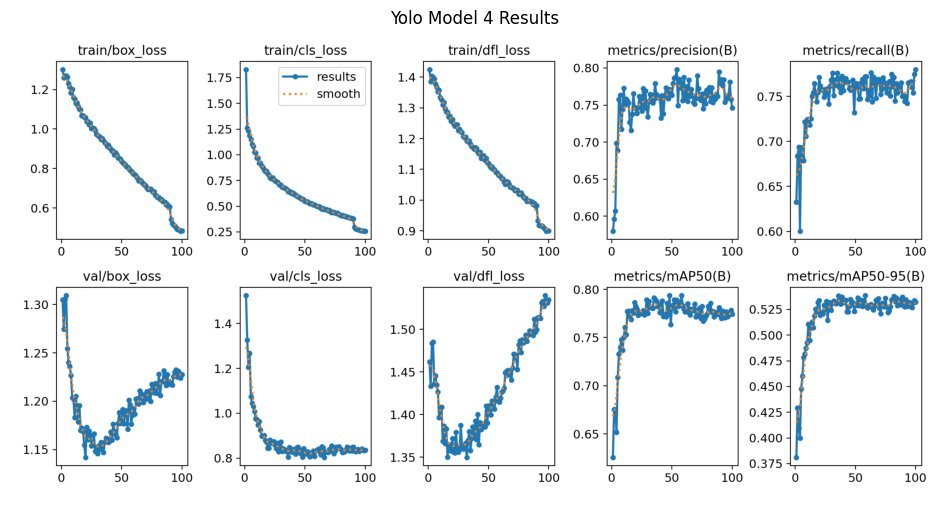

In [63]:
# Load image
yolo4_results = cv2.imread('/content/drive/MyDrive/yolo_runs2/runs2/detect/4th yolo train/results.png', 1)

# Convert BGR to RGB
yolo4_results_rgb = cv2.cvtColor(yolo4_results, cv2.COLOR_BGR2RGB)

# Set a larger figure size for display
plt.figure(figsize=(12, 10))

# Display the image
plt.title("Yolo Model 4 Results")
plt.imshow(yolo4_results_rgb)
plt.axis("off")
plt.show()

## Yolo 4 Evaluation
- P: 0.777
- R: 0.77
-mAP50: 0.792
- mAP50-95: 0.538

In [7]:
# Getting Metrics
yolo4.val()

Ultralytics YOLOv8.0.222 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
Model summary (fused): 218 layers, 25845550 parameters, 0 gradients, 78.7 GFLOPs


val: Scanning /content/drive/My Drive/YoloProject/test/labels.cache... 536 images, 0 backgrounds, 0 corrupt: 100%|██████████| 536/536 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 34/34 [00:09<00:00,  3.47it/s]


                   all        536       2031      0.777       0.77      0.792      0.538
              sunglass        536         82      0.535      0.323      0.423       0.15
                   hat        536         76      0.781      0.751       0.77      0.433
                jacket        536        181      0.761      0.851      0.835      0.653
                 shirt        536        365       0.83       0.83      0.868      0.616
                 pants        536        114      0.905      0.919      0.956      0.765
                shorts        536        107      0.812      0.841      0.819      0.537
                 skirt        536        185      0.819      0.808      0.849       0.68
                 dress        536        128      0.728      0.875       0.83      0.672
                   bag        536        274      0.774      0.715       0.75      0.418
                  shoe        536        519      0.825      0.783      0.819      0.461
Speed: 0.1ms preproce

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7b7e50123c40>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.0

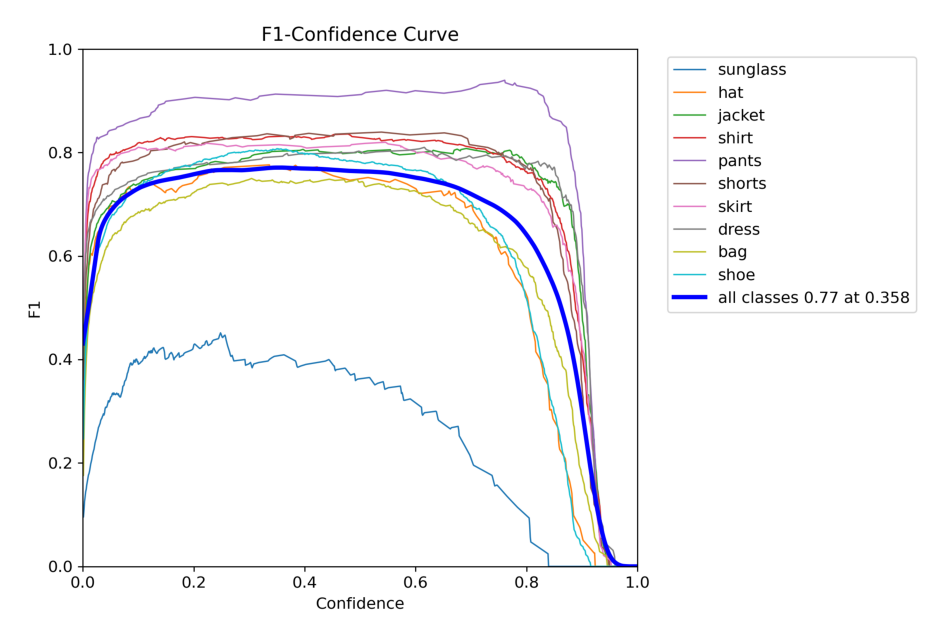

In [64]:
# Load image
yolo4_f1 = cv2.imread('/content/drive/MyDrive/yolo_runs2/runs2/detect/4th yolo val/F1_curve.png', 1)

# Convert BGR to RGB
yolo4_f1_rgb = cv2.cvtColor(yolo4_f1, cv2.COLOR_BGR2RGB)

# Set a larger figure size for display
plt.figure(figsize=(12, 10))

# Display the image
plt.imshow(yolo4_f1_rgb)
plt.axis("off")
plt.show()

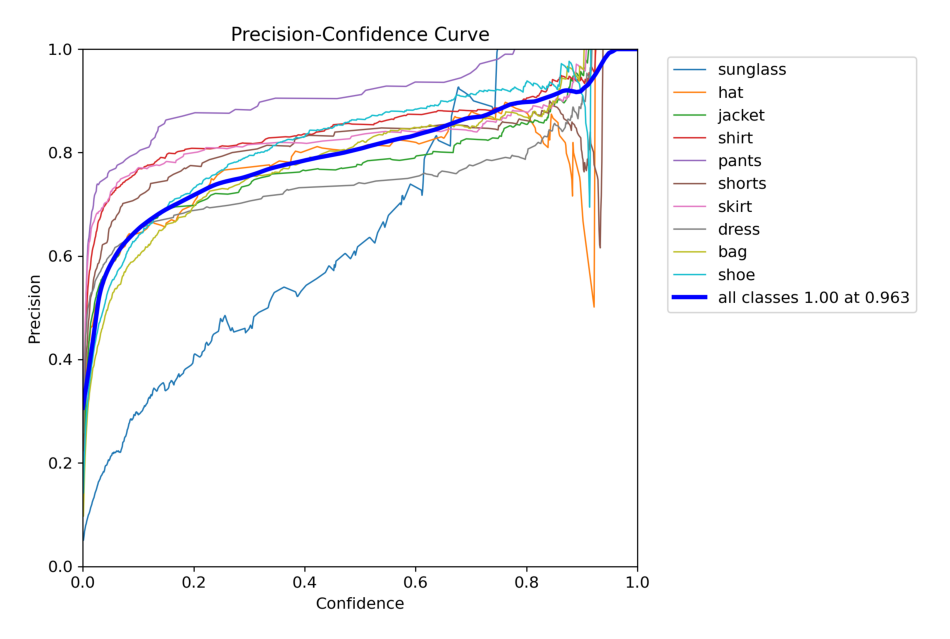

In [65]:
# Load image
yolo4_pc = cv2.imread('/content/drive/MyDrive/yolo_runs2/runs2/detect/4th yolo val/P_curve.png', 1)

# Convert BGR to RGB
yolo4_pc_rgb = cv2.cvtColor(yolo4_pc, cv2.COLOR_BGR2RGB)

# Set a larger figure size for display
plt.figure(figsize=(12, 10))

# Display the image
plt.imshow(yolo4_pc_rgb)
plt.axis("off")
plt.show()

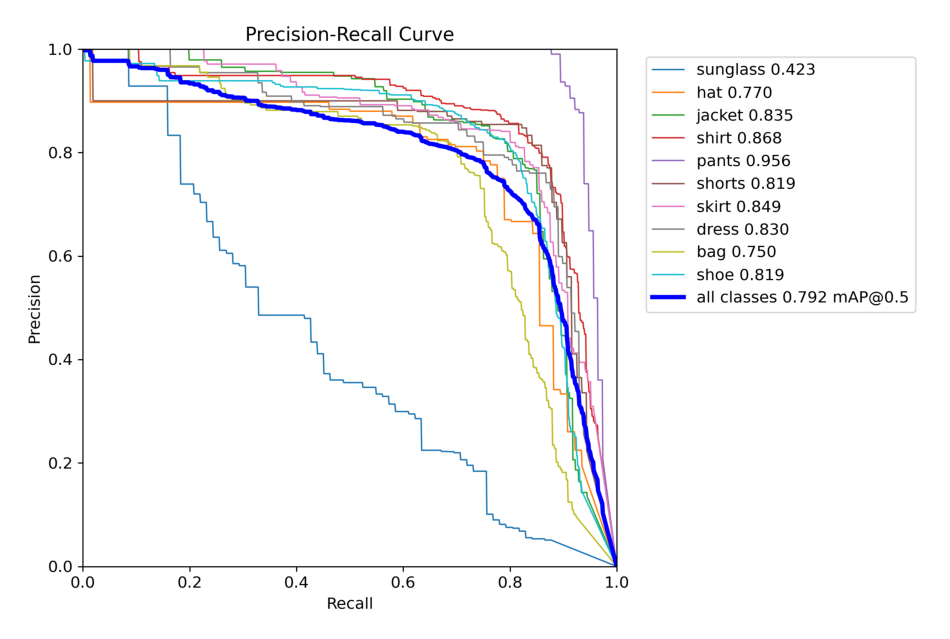

In [66]:
# Load image
yolo4_pr = cv2.imread('/content/drive/MyDrive/yolo_runs2/runs2/detect/4th yolo val/PR_curve.png', 1)

# Convert BGR to RGB
yolo4_pr_rgb = cv2.cvtColor(yolo4_pr, cv2.COLOR_BGR2RGB)

# Set a larger figure size for display
plt.figure(figsize=(12, 10))

# Display the image
plt.imshow(yolo4_pr_rgb)
plt.axis("off")
plt.show()

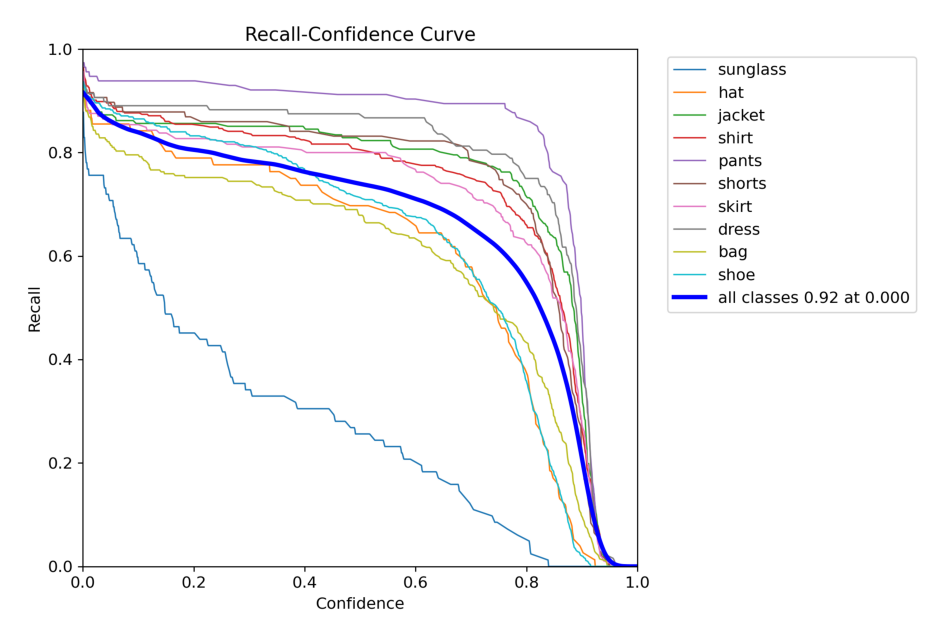

In [67]:
# Load image
yolo4_rm = cv2.imread('/content/drive/MyDrive/yolo_runs2/runs2/detect/4th yolo val/R_curve.png', 1)

# Convert BGR to RGB
yolo4_rm_rgb = cv2.cvtColor(yolo4_rm, cv2.COLOR_BGR2RGB)

# Set a larger figure size for display
plt.figure(figsize=(12, 10))

# Display the image
plt.imshow(yolo4_rm_rgb)
plt.axis("off")
plt.show()

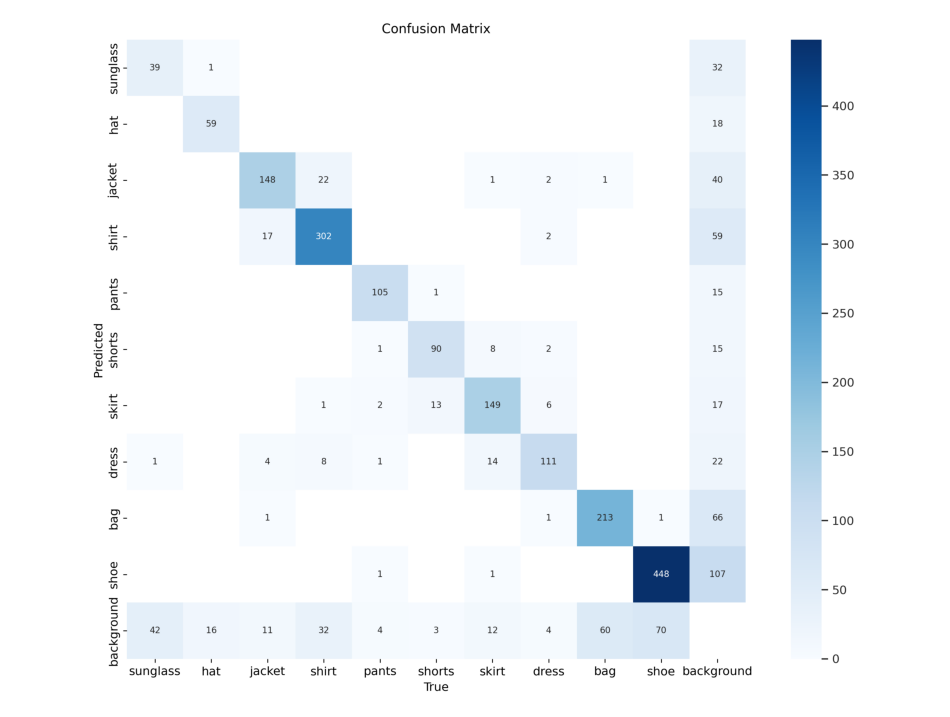

In [68]:
# Load image
yolo4_cm = cv2.imread('/content/drive/MyDrive/yolo_runs2/runs2/detect/4th yolo val/confusion_matrix.png', 1)

# Convert BGR to RGB
yolo4_cm_rgb = cv2.cvtColor(yolo4_cm, cv2.COLOR_BGR2RGB)

# Set a larger figure size for display
plt.figure(figsize=(12, 10))

# Display the image
plt.imshow(yolo4_cm_rgb)
plt.axis("off")
plt.show()

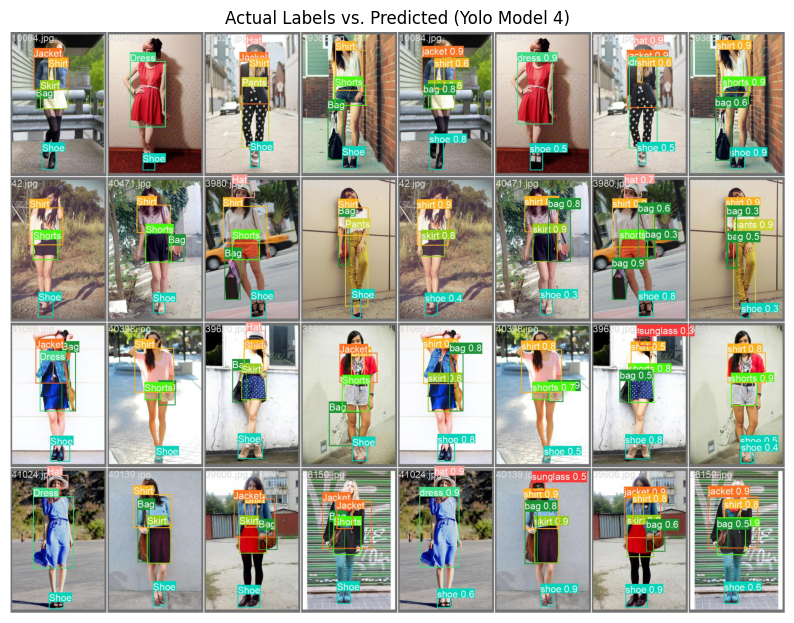

In [70]:
# Load the image
yolo4_pred = cv2.imread('/content/drive/MyDrive/yolo_runs2/runs2/detect/4th yolo val/val_batch0_pred.jpg', -1)

# Convert BGR to RGB
yolo4_pred_rgb = cv2.cvtColor(yolo4_pred, cv2.COLOR_BGR2RGB)

actual_labels = cv2.imread('/content/drive/MyDrive/yolo_runs2/runs2/detect/1st yolo val/val_batch0_labels.jpg', -1)
actual_labels_rgb = cv2.cvtColor(actual_labels, cv2.COLOR_BGR2RGB)

# Combine the images side by side
combined_image = cv2.hconcat([actual_labels_rgb, yolo4_pred_rgb])
plt.figure(figsize=(10, 8))

# Display the combined image
plt.imshow(combined_image)
plt.axis("off")
plt.title("Actual Labels vs. Predicted (Yolo Model 4)")
plt.show()


image 1/1 /content/drive/MyDrive/people.jpg: 448x640 3 jackets, 2 shirts, 4 pantss, 1 bag, 3 shoes, 13.9ms
Speed: 2.8ms preprocess, 13.9ms inference, 2.2ms postprocess per image at shape (1, 3, 448, 640)


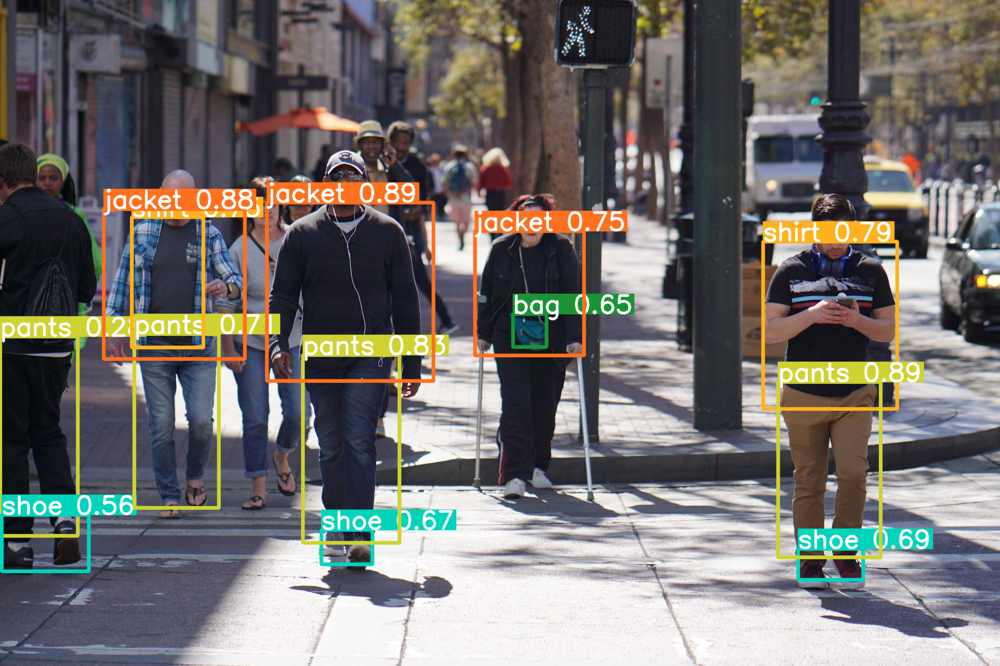

In [9]:
# Testing model onn real world data
from PIL import Image
results4 = yolo4("/content/drive/MyDrive/people.jpg")
for r in results4:
    im_array = r.plot()
    im = Image.fromarray(im_array[..., ::-1])
    display(im)

# Yolo 5 - Different Method of Augmentation - 100 Epochs

## Yolo 5 Training

In [3]:
yolo5 = YOLO('yolov8m.pt')
yolo5.train(data='/content/drive/My Drive/YoloProject/data4.yaml', epochs=100, degrees=0.25, perspective=0.001, translate = 0.1, scale = 0.2, shear = 0.2)

Ultralytics YOLOv8.0.222 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
engine/trainer: task=detect, mode=train, model=yolov8m.pt, data=/content/drive/My Drive/YoloProject/data4.yaml, epochs=100, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train5, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=Tr

train: Scanning /content/drive/My Drive/YoloProject/train/labels.cache... 2143 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2143/2143 [00:00<?, ?it/s]


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/drive/My Drive/YoloProject/test/labels.cache... 536 images, 0 backgrounds, 0 corrupt: 100%|██████████| 536/536 [00:00<?, ?it/s]


Plotting labels to runs/detect/train5/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000714, momentum=0.9) with parameter groups 77 weight(decay=0.0), 84 weight(decay=0.0005), 83 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/train5
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      6.94G      1.508      1.946      1.571        119        640: 100%|██████████| 134/134 [00:31<00:00,  4.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:04<00:00,  4.10it/s]

                   all        536       2031      0.646      0.679       0.69      0.401



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      7.15G      1.452      1.386      1.514        112        640: 100%|██████████| 134/134 [00:26<00:00,  5.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:04<00:00,  4.20it/s]


                   all        536       2031      0.646      0.616      0.645      0.376

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      7.19G      1.453      1.372      1.521        101        640: 100%|██████████| 134/134 [00:26<00:00,  5.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:04<00:00,  4.19it/s]


                   all        536       2031      0.688      0.645      0.693      0.398

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      7.21G      1.447      1.316      1.518        120        640: 100%|██████████| 134/134 [00:26<00:00,  5.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.25it/s]


                   all        536       2031      0.711      0.682      0.698      0.422

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      7.15G      1.416      1.276      1.498        117        640: 100%|██████████| 134/134 [00:25<00:00,  5.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.38it/s]


                   all        536       2031      0.715      0.735      0.736      0.453

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      7.16G      1.396      1.213      1.489        107        640: 100%|██████████| 134/134 [00:25<00:00,  5.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.39it/s]


                   all        536       2031      0.738      0.705      0.729      0.445

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      7.19G      1.368      1.188      1.463        141        640: 100%|██████████| 134/134 [00:25<00:00,  5.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.46it/s]


                   all        536       2031      0.731       0.69      0.722       0.44

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      7.17G      1.364      1.162      1.464        136        640: 100%|██████████| 134/134 [00:26<00:00,  5.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.48it/s]


                   all        536       2031      0.677      0.732      0.754      0.478

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      7.17G      1.355      1.145      1.458         93        640: 100%|██████████| 134/134 [00:25<00:00,  5.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.55it/s]


                   all        536       2031      0.706      0.737      0.759      0.472

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      7.19G      1.324      1.094      1.437        107        640: 100%|██████████| 134/134 [00:26<00:00,  5.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.33it/s]


                   all        536       2031      0.707      0.747      0.758      0.487

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      7.17G      1.301      1.061       1.42        115        640: 100%|██████████| 134/134 [00:25<00:00,  5.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.41it/s]


                   all        536       2031       0.69      0.728      0.746      0.475

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      7.19G      1.302      1.053      1.425         99        640: 100%|██████████| 134/134 [00:25<00:00,  5.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.28it/s]


                   all        536       2031      0.748       0.76      0.782      0.496

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      7.16G      1.294      1.059      1.418        103        640: 100%|██████████| 134/134 [00:25<00:00,  5.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.29it/s]


                   all        536       2031      0.754      0.754      0.778      0.507

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      7.17G      1.276      1.018      1.409        125        640: 100%|██████████| 134/134 [00:25<00:00,  5.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:04<00:00,  4.11it/s]


                   all        536       2031      0.747      0.744      0.774      0.503

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      7.18G       1.26      1.007      1.392        113        640: 100%|██████████| 134/134 [00:25<00:00,  5.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.32it/s]


                   all        536       2031      0.721      0.748      0.769      0.498

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      7.17G      1.254     0.9816       1.39         90        640: 100%|██████████| 134/134 [00:26<00:00,  5.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.51it/s]


                   all        536       2031      0.748      0.765      0.783      0.506

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      7.18G      1.235     0.9616      1.381         91        640: 100%|██████████| 134/134 [00:25<00:00,  5.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.44it/s]


                   all        536       2031       0.79       0.74      0.781      0.511

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      7.19G      1.223     0.9434      1.371         99        640: 100%|██████████| 134/134 [00:26<00:00,  5.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.44it/s]


                   all        536       2031      0.778      0.724      0.775      0.515

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      7.15G      1.224      0.931      1.367        137        640: 100%|██████████| 134/134 [00:25<00:00,  5.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.50it/s]


                   all        536       2031       0.76      0.772      0.786      0.512

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      7.17G      1.213     0.9245      1.355        101        640: 100%|██████████| 134/134 [00:25<00:00,  5.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.70it/s]


                   all        536       2031      0.745       0.76      0.779      0.512

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      7.15G      1.203     0.9092      1.351        109        640: 100%|██████████| 134/134 [00:25<00:00,  5.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.53it/s]

                   all        536       2031      0.761      0.763      0.789      0.519



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      7.17G        1.2     0.9035      1.348        118        640: 100%|██████████| 134/134 [00:25<00:00,  5.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.47it/s]


                   all        536       2031      0.771      0.752       0.78       0.51

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      7.16G      1.195     0.8906      1.346         96        640: 100%|██████████| 134/134 [00:25<00:00,  5.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.35it/s]


                   all        536       2031      0.749       0.75      0.779      0.515

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      7.19G      1.183     0.8695      1.328         99        640: 100%|██████████| 134/134 [00:25<00:00,  5.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.46it/s]


                   all        536       2031      0.753      0.772       0.79      0.524

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      7.17G      1.163     0.8615      1.314        104        640: 100%|██████████| 134/134 [00:25<00:00,  5.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.59it/s]


                   all        536       2031      0.754      0.765      0.797      0.533

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      7.17G       1.18      0.861      1.333        122        640: 100%|██████████| 134/134 [00:25<00:00,  5.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.52it/s]


                   all        536       2031      0.768      0.763      0.782      0.522

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      7.17G      1.173     0.8623      1.327        103        640: 100%|██████████| 134/134 [00:25<00:00,  5.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.54it/s]

                   all        536       2031      0.743       0.78      0.782      0.522



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      7.16G      1.163     0.8246      1.311        117        640: 100%|██████████| 134/134 [00:25<00:00,  5.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.57it/s]

                   all        536       2031       0.75      0.772      0.792      0.523



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      7.17G       1.14     0.8276      1.309        115        640: 100%|██████████| 134/134 [00:25<00:00,  5.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.71it/s]


                   all        536       2031      0.754      0.752      0.783      0.518

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      7.19G      1.148      0.824       1.31        114        640: 100%|██████████| 134/134 [00:25<00:00,  5.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.56it/s]

                   all        536       2031      0.769      0.752      0.781      0.519



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      7.18G      1.129     0.8143        1.3        109        640: 100%|██████████| 134/134 [00:25<00:00,  5.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.48it/s]


                   all        536       2031      0.757      0.771      0.797      0.538

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      7.18G      1.132     0.8004        1.3         94        640: 100%|██████████| 134/134 [00:25<00:00,  5.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.29it/s]

                   all        536       2031      0.753      0.776        0.8      0.537



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      7.19G      1.126     0.7993      1.294        110        640: 100%|██████████| 134/134 [00:25<00:00,  5.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.33it/s]


                   all        536       2031      0.778       0.76      0.793      0.528

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100      7.17G       1.13     0.7964      1.293        112        640: 100%|██████████| 134/134 [00:25<00:00,  5.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.56it/s]


                   all        536       2031       0.76      0.767      0.783      0.531

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      7.16G       1.11     0.7878      1.281        114        640: 100%|██████████| 134/134 [00:25<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.56it/s]

                   all        536       2031      0.713      0.764      0.769      0.511



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      7.17G      1.098      0.754      1.281        110        640: 100%|██████████| 134/134 [00:25<00:00,  5.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.68it/s]

                   all        536       2031      0.771      0.755      0.797      0.542



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      7.18G      1.101     0.7608      1.281        104        640: 100%|██████████| 134/134 [00:25<00:00,  5.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.56it/s]

                   all        536       2031      0.778      0.741      0.786      0.529



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100      7.16G      1.096     0.7527      1.272        103        640: 100%|██████████| 134/134 [00:25<00:00,  5.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.44it/s]

                   all        536       2031      0.739      0.764      0.783      0.527



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      7.19G      1.091     0.7568      1.272        123        640: 100%|██████████| 134/134 [00:26<00:00,  5.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:04<00:00,  4.15it/s]


                   all        536       2031      0.786      0.764      0.792      0.527

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      7.16G      1.077     0.7419      1.271        113        640: 100%|██████████| 134/134 [00:25<00:00,  5.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:04<00:00,  4.19it/s]

                   all        536       2031      0.776      0.757      0.792      0.533



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      7.16G      1.073     0.7359      1.261        133        640: 100%|██████████| 134/134 [00:25<00:00,  5.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.36it/s]

                   all        536       2031      0.758      0.762      0.779      0.519



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100      7.18G      1.065     0.7265      1.256        123        640: 100%|██████████| 134/134 [00:25<00:00,  5.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.46it/s]


                   all        536       2031      0.765      0.785      0.795      0.534

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      7.17G      1.061      0.715      1.258        106        640: 100%|██████████| 134/134 [00:26<00:00,  5.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.47it/s]

                   all        536       2031      0.787      0.753      0.791      0.532



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100      7.17G      1.059      0.705      1.246        117        640: 100%|██████████| 134/134 [00:26<00:00,  5.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.59it/s]


                   all        536       2031      0.759      0.773      0.789      0.531

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      7.18G      1.061     0.7077      1.247        120        640: 100%|██████████| 134/134 [00:25<00:00,  5.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.39it/s]


                   all        536       2031      0.744      0.788      0.785      0.528

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100      7.18G      1.046     0.7057      1.248        108        640: 100%|██████████| 134/134 [00:25<00:00,  5.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:04<00:00,  4.23it/s]


                   all        536       2031      0.747      0.781      0.792      0.533

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100      7.16G       1.04     0.6929      1.231         95        640: 100%|██████████| 134/134 [00:25<00:00,  5.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.34it/s]


                   all        536       2031      0.779      0.762      0.788      0.526

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      7.18G      1.037     0.6948      1.234        109        640: 100%|██████████| 134/134 [00:25<00:00,  5.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.43it/s]


                   all        536       2031      0.745      0.781      0.794      0.534

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      7.18G      1.035     0.6832      1.226        115        640: 100%|██████████| 134/134 [00:25<00:00,  5.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.64it/s]

                   all        536       2031      0.755      0.773      0.784      0.533



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100       7.2G      1.018     0.6643      1.215        104        640: 100%|██████████| 134/134 [00:25<00:00,  5.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.43it/s]

                   all        536       2031      0.766       0.76       0.78      0.523



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      7.18G       1.02     0.6663      1.219        106        640: 100%|██████████| 134/134 [00:26<00:00,  5.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.52it/s]

                   all        536       2031      0.747      0.771      0.783       0.53



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100      7.17G      1.004     0.6571      1.205        105        640: 100%|██████████| 134/134 [00:25<00:00,  5.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.53it/s]

                   all        536       2031      0.774      0.767      0.792      0.536



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100      7.15G     0.9972     0.6479      1.206        107        640: 100%|██████████| 134/134 [00:25<00:00,  5.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.47it/s]

                   all        536       2031      0.761      0.777      0.794      0.537



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100       7.2G     0.9952     0.6513      1.199        104        640: 100%|██████████| 134/134 [00:25<00:00,  5.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.33it/s]


                   all        536       2031      0.782      0.767      0.791      0.529

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100      7.19G     0.9976     0.6393      1.207         97        640: 100%|██████████| 134/134 [00:25<00:00,  5.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.35it/s]


                   all        536       2031       0.81      0.753      0.794      0.532

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100      7.17G     0.9917     0.6362      1.201        113        640: 100%|██████████| 134/134 [00:25<00:00,  5.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.56it/s]

                   all        536       2031      0.812      0.758       0.79      0.532



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100      7.17G     0.9869     0.6322      1.199        115        640: 100%|██████████| 134/134 [00:25<00:00,  5.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.73it/s]

                   all        536       2031      0.766      0.774      0.784      0.532



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100      7.17G     0.9794     0.6295      1.185         99        640: 100%|██████████| 134/134 [00:25<00:00,  5.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.77it/s]


                   all        536       2031      0.774      0.776       0.79      0.528

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      7.16G     0.9677     0.6194      1.184        121        640: 100%|██████████| 134/134 [00:25<00:00,  5.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.65it/s]


                   all        536       2031      0.772      0.766      0.796      0.542

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100       7.2G     0.9559     0.6084      1.179        122        640: 100%|██████████| 134/134 [00:25<00:00,  5.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.57it/s]

                   all        536       2031      0.775      0.756      0.783      0.533



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100      7.15G     0.9525      0.609       1.17         90        640: 100%|██████████| 134/134 [00:25<00:00,  5.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.35it/s]

                   all        536       2031      0.792      0.756      0.788      0.527



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100      7.16G     0.9557     0.6162      1.172        107        640: 100%|██████████| 134/134 [00:25<00:00,  5.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.44it/s]


                   all        536       2031      0.761      0.777      0.785      0.533

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100      7.16G     0.9518      0.603      1.165        113        640: 100%|██████████| 134/134 [00:25<00:00,  5.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.47it/s]


                   all        536       2031      0.756      0.777      0.783      0.532

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100      7.16G     0.9361     0.5896       1.16        130        640: 100%|██████████| 134/134 [00:25<00:00,  5.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.51it/s]


                   all        536       2031      0.777      0.775      0.788      0.535

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      7.17G     0.9276     0.5895      1.158        110        640: 100%|██████████| 134/134 [00:25<00:00,  5.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.48it/s]

                   all        536       2031      0.757      0.767      0.775      0.528



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100      7.15G     0.9236     0.5802      1.152        112        640: 100%|██████████| 134/134 [00:25<00:00,  5.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.39it/s]


                   all        536       2031       0.76      0.778      0.781      0.527

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100      7.17G     0.9226     0.5814      1.152        115        640: 100%|██████████| 134/134 [00:25<00:00,  5.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.51it/s]


                   all        536       2031      0.785      0.743      0.774      0.524

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100      7.19G     0.9149     0.5742      1.149        118        640: 100%|██████████| 134/134 [00:25<00:00,  5.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.29it/s]


                   all        536       2031       0.79      0.772      0.804      0.541

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      7.19G     0.9106     0.5692      1.145         96        640: 100%|██████████| 134/134 [00:25<00:00,  5.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:04<00:00,  4.24it/s]


                   all        536       2031      0.784      0.755      0.787      0.531

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100      7.17G     0.9073     0.5689      1.147        111        640: 100%|██████████| 134/134 [00:25<00:00,  5.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.34it/s]


                   all        536       2031      0.792      0.744      0.782      0.534

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100      7.19G        0.9     0.5599      1.143         99        640: 100%|██████████| 134/134 [00:25<00:00,  5.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.50it/s]


                   all        536       2031       0.79      0.747      0.796       0.54

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100      7.18G     0.8957     0.5577      1.134        131        640: 100%|██████████| 134/134 [00:25<00:00,  5.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.51it/s]


                   all        536       2031      0.755      0.764      0.781      0.532

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100      7.16G     0.8909     0.5564      1.135         99        640: 100%|██████████| 134/134 [00:26<00:00,  5.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.42it/s]


                   all        536       2031      0.786      0.755      0.791      0.534

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100      7.17G     0.8795     0.5433      1.126        101        640: 100%|██████████| 134/134 [00:26<00:00,  5.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.55it/s]


                   all        536       2031      0.758      0.771      0.779      0.533

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100      7.17G     0.8773     0.5434      1.124        151        640: 100%|██████████| 134/134 [00:25<00:00,  5.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.30it/s]


                   all        536       2031      0.777      0.757       0.78      0.528

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100      7.17G     0.8728     0.5366      1.125        109        640: 100%|██████████| 134/134 [00:26<00:00,  5.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.31it/s]


                   all        536       2031      0.759      0.788       0.79      0.535

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100      7.17G     0.8699     0.5382      1.118        125        640: 100%|██████████| 134/134 [00:25<00:00,  5.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.30it/s]


                   all        536       2031      0.751      0.759      0.778      0.525

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100      7.18G     0.8567     0.5352      1.111        109        640: 100%|██████████| 134/134 [00:25<00:00,  5.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.45it/s]


                   all        536       2031      0.812      0.744      0.784      0.534

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100      7.17G     0.8544      0.529      1.108         95        640: 100%|██████████| 134/134 [00:25<00:00,  5.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.63it/s]

                   all        536       2031      0.795      0.752       0.79      0.535



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100      7.17G     0.8533      0.517      1.114        108        640: 100%|██████████| 134/134 [00:25<00:00,  5.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.56it/s]

                   all        536       2031       0.78      0.774      0.787      0.534



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100      7.18G     0.8496      0.522      1.106        109        640: 100%|██████████| 134/134 [00:25<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.69it/s]

                   all        536       2031      0.783      0.764      0.788      0.534



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100      7.18G     0.8489     0.5195      1.107        108        640: 100%|██████████| 134/134 [00:25<00:00,  5.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.66it/s]

                   all        536       2031      0.777      0.774      0.793      0.537



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100      7.16G     0.8396      0.511      1.098        113        640: 100%|██████████| 134/134 [00:25<00:00,  5.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.45it/s]


                   all        536       2031      0.779      0.762      0.788      0.533

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100      7.18G     0.8318     0.5115      1.097        119        640: 100%|██████████| 134/134 [00:25<00:00,  5.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.36it/s]


                   all        536       2031      0.781      0.761       0.79      0.534

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100      7.16G      0.829     0.5063      1.099        109        640: 100%|██████████| 134/134 [00:25<00:00,  5.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.31it/s]

                   all        536       2031      0.783      0.753      0.787      0.534



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100      7.16G     0.8205     0.5007      1.093        101        640: 100%|██████████| 134/134 [00:25<00:00,  5.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.59it/s]


                   all        536       2031      0.762      0.783      0.792      0.536

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100      7.16G     0.8121     0.4905      1.084        110        640: 100%|██████████| 134/134 [00:25<00:00,  5.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.63it/s]

                   all        536       2031      0.766      0.767      0.783      0.534



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100      7.17G     0.8134     0.4936      1.091        124        640: 100%|██████████| 134/134 [00:25<00:00,  5.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.63it/s]

                   all        536       2031      0.788      0.751      0.786      0.533



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100      7.17G     0.8031     0.4882       1.08        112        640: 100%|██████████| 134/134 [00:25<00:00,  5.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.63it/s]

                   all        536       2031      0.782      0.744      0.783      0.533



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100      7.19G     0.8017     0.4877      1.077        114        640: 100%|██████████| 134/134 [00:25<00:00,  5.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.42it/s]

                   all        536       2031      0.783       0.76       0.79      0.536


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100      7.17G     0.6648     0.3235     0.9791         55        640: 100%|██████████| 134/134 [00:27<00:00,  4.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.44it/s]


                   all        536       2031      0.781      0.751      0.779      0.529

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100      7.17G     0.6426     0.3093     0.9689         54        640: 100%|██████████| 134/134 [00:25<00:00,  5.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.42it/s]


                   all        536       2031      0.768      0.771      0.785      0.531

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100      7.17G     0.6257     0.3048     0.9649         52        640: 100%|██████████| 134/134 [00:25<00:00,  5.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.39it/s]


                   all        536       2031      0.782      0.753      0.786      0.533

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100      7.17G     0.6228     0.3018     0.9591         58        640: 100%|██████████| 134/134 [00:25<00:00,  5.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.52it/s]


                   all        536       2031      0.765      0.767      0.783      0.531

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100      7.15G     0.6118     0.2993     0.9586         50        640: 100%|██████████| 134/134 [00:25<00:00,  5.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.63it/s]

                   all        536       2031      0.778      0.761      0.786      0.535



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100      7.18G     0.6001     0.2912      0.952         53        640: 100%|██████████| 134/134 [00:25<00:00,  5.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.53it/s]


                   all        536       2031       0.77      0.768      0.785      0.529

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100      7.17G     0.5968     0.2904     0.9467         58        640: 100%|██████████| 134/134 [00:25<00:00,  5.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.68it/s]

                   all        536       2031      0.775      0.771      0.786       0.53



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100      7.18G     0.5908     0.2883     0.9437         57        640: 100%|██████████| 134/134 [00:25<00:00,  5.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.50it/s]

                   all        536       2031      0.788      0.751      0.784      0.531



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100      7.18G      0.579      0.285     0.9405         50        640: 100%|██████████| 134/134 [00:25<00:00,  5.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.48it/s]

                   all        536       2031      0.789      0.756      0.789      0.532



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100      7.17G     0.5824     0.2825     0.9364         55        640: 100%|██████████| 134/134 [00:25<00:00,  5.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:03<00:00,  4.42it/s]


                   all        536       2031      0.773      0.771      0.784      0.529

100 epochs completed in 0.859 hours.
Optimizer stripped from runs/detect/train5/weights/last.pt, 52.0MB
Optimizer stripped from runs/detect/train5/weights/best.pt, 52.0MB

Validating runs/detect/train5/weights/best.pt...
Ultralytics YOLOv8.0.222 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
Model summary (fused): 218 layers, 25845550 parameters, 0 gradients, 78.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 17/17 [00:07<00:00,  2.21it/s]


                   all        536       2031      0.772      0.765      0.796      0.542
              sunglass        536         82       0.44      0.392      0.424      0.166
                   hat        536         76      0.843      0.789      0.814      0.505
                jacket        536        181      0.753      0.792      0.802      0.628
                 shirt        536        365      0.824      0.784      0.867      0.621
                 pants        536        114      0.874      0.904       0.95      0.756
                shorts        536        107      0.842      0.799      0.816       0.55
                 skirt        536        185      0.805      0.843      0.841      0.654
                 dress        536        128      0.729      0.859      0.842      0.667
                   bag        536        274      0.799      0.701      0.795      0.421
                  shoe        536        519      0.812      0.792      0.811      0.454
Speed: 0.1ms preproce

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7b7e08341900>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.0

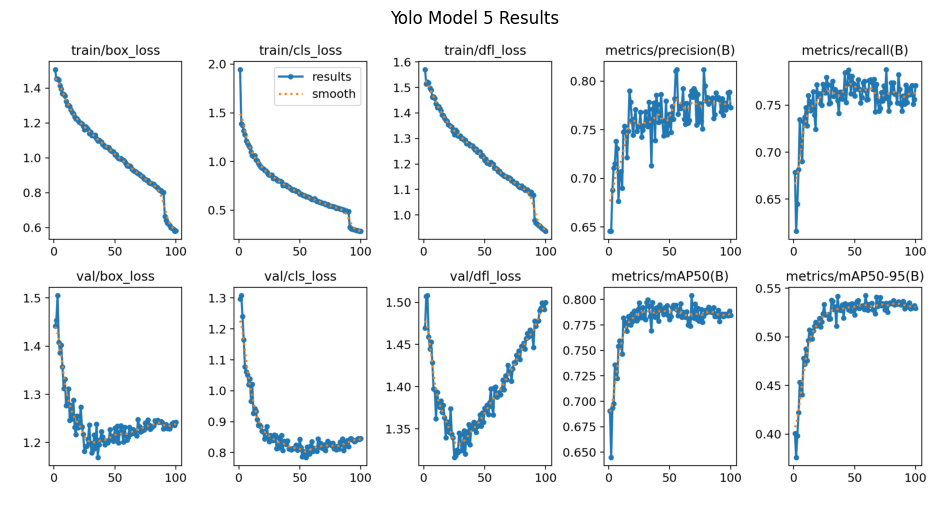

In [71]:
# Load image
yolo5_results = cv2.imread('/content/drive/MyDrive/yolo_runs2/runs2/detect/5th yolo train/results.png', 1)

# Convert BGR to RGB
yolo5_results_rgb = cv2.cvtColor(yolo5_results, cv2.COLOR_BGR2RGB)

# Set a larger figure size for display
plt.figure(figsize=(12, 10))

# Display the image
plt.title("Yolo Model 5 Results")
plt.imshow(yolo5_results_rgb)
plt.axis("off")
plt.show()

## Yolo 5 Evaluation
- P: 0.774
- R: 0.767
-mAP50: 0.797
- mAP50-95: 0.542

In [4]:
# Getting Metrics
yolo5.val()

Ultralytics YOLOv8.0.222 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
Model summary (fused): 218 layers, 25845550 parameters, 0 gradients, 78.7 GFLOPs


val: Scanning /content/drive/My Drive/YoloProject/test/labels.cache... 536 images, 0 backgrounds, 0 corrupt: 100%|██████████| 536/536 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 34/34 [00:09<00:00,  3.62it/s]


                   all        536       2031      0.774      0.767      0.797      0.542
              sunglass        536         82      0.453      0.402      0.431      0.165
                   hat        536         76      0.843      0.789      0.815      0.506
                jacket        536        181      0.753      0.791      0.802      0.627
                 shirt        536        365      0.826      0.784      0.867      0.621
                 pants        536        114      0.873      0.904       0.95      0.756
                shorts        536        107      0.842      0.799      0.815      0.548
                 skirt        536        185      0.809      0.848      0.841      0.656
                 dress        536        128      0.729      0.859      0.842      0.669
                   bag        536        274      0.803      0.704      0.798      0.423
                  shoe        536        519       0.81       0.79      0.808      0.454
Speed: 0.1ms preproce

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7b7dd9fe6ef0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.0

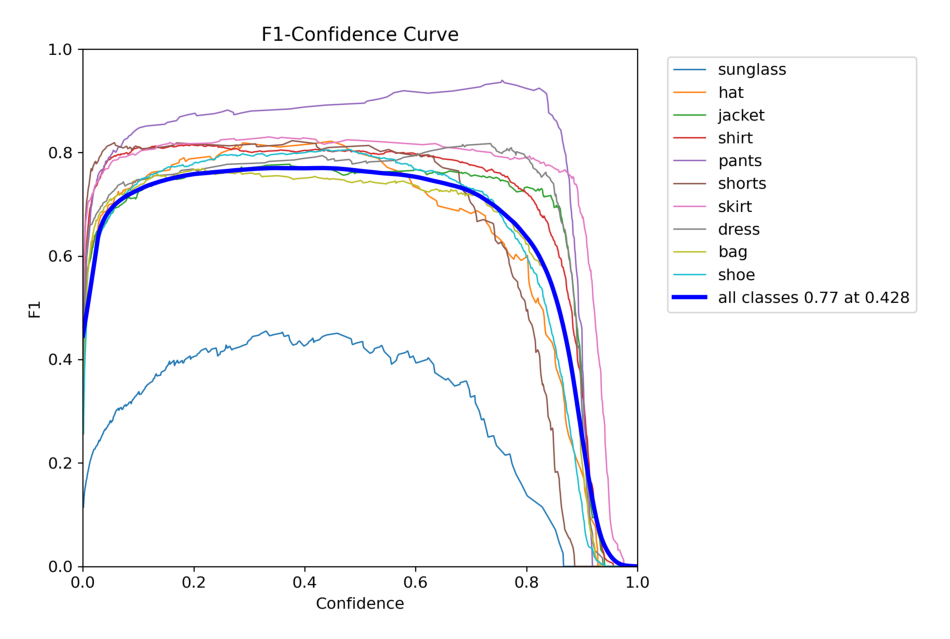

In [72]:
# Load image
yolo5_f1 = cv2.imread('/content/drive/MyDrive/yolo_runs2/runs2/detect/5th yolo val/F1_curve.png', 1)

# Convert BGR to RGB
yolo5_f1_rgb = cv2.cvtColor(yolo5_f1, cv2.COLOR_BGR2RGB)

# Set a larger figure size for display
plt.figure(figsize=(12, 10))

# Display the image
plt.imshow(yolo5_f1_rgb)
plt.axis("off")
plt.show()

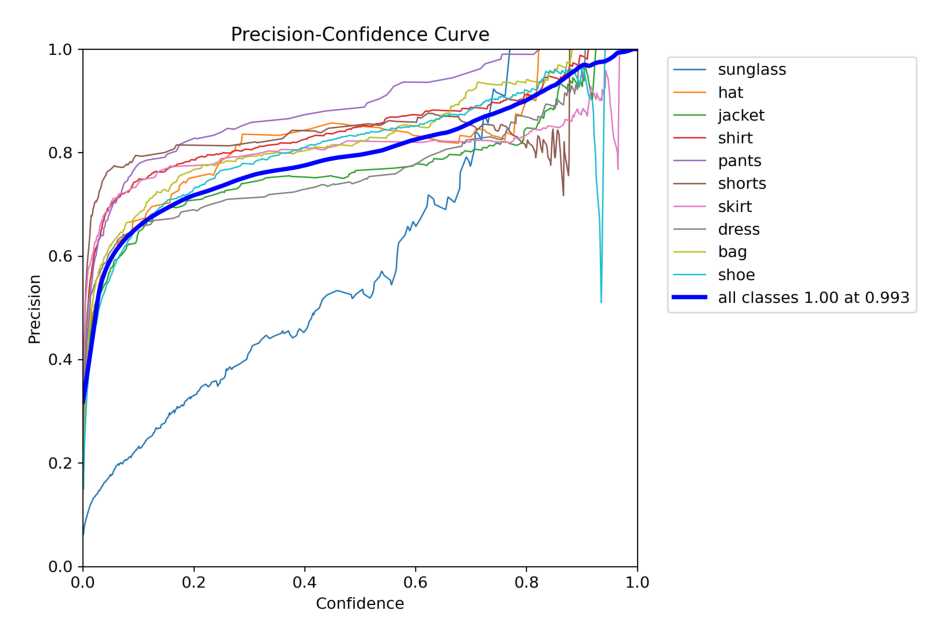

In [73]:
# Load image
yolo5_pc = cv2.imread('/content/drive/MyDrive/yolo_runs2/runs2/detect/5th yolo val/P_curve.png', 1)

# Convert BGR to RGB
yolo5_pc_rgb = cv2.cvtColor(yolo5_pc, cv2.COLOR_BGR2RGB)

# Set a larger figure size for display
plt.figure(figsize=(12, 10))

# Display the image
plt.imshow(yolo5_pc_rgb)
plt.axis("off")
plt.show()

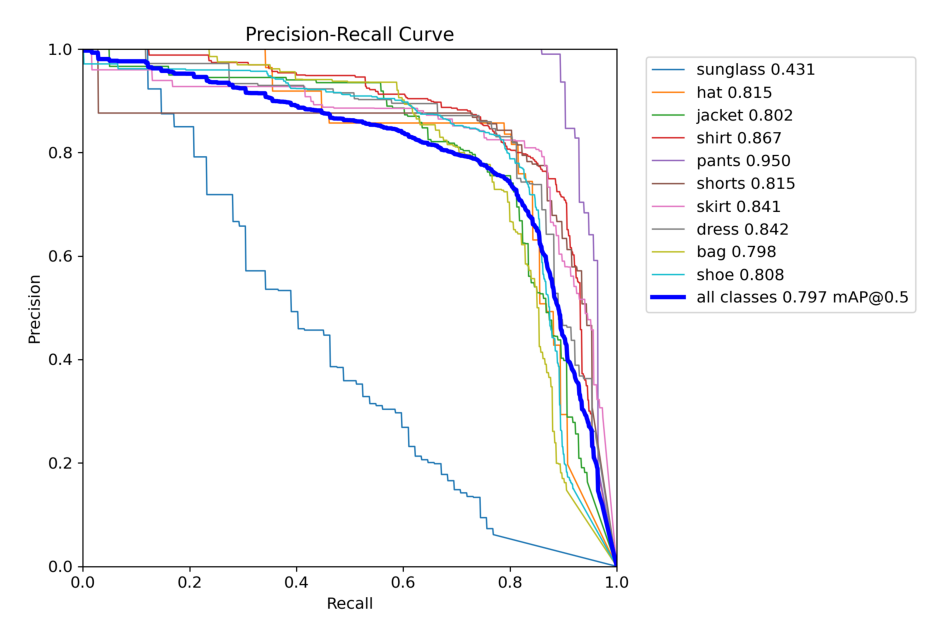

In [74]:
# Load image
yolo5_pr = cv2.imread('/content/drive/MyDrive/yolo_runs2/runs2/detect/5th yolo val/PR_curve.png', 1)

# Convert BGR to RGB
yolo5_pr_rgb = cv2.cvtColor(yolo5_pr, cv2.COLOR_BGR2RGB)

# Set a larger figure size for display
plt.figure(figsize=(12, 10))

# Display the image
plt.imshow(yolo5_pr_rgb)
plt.axis("off")
plt.show()

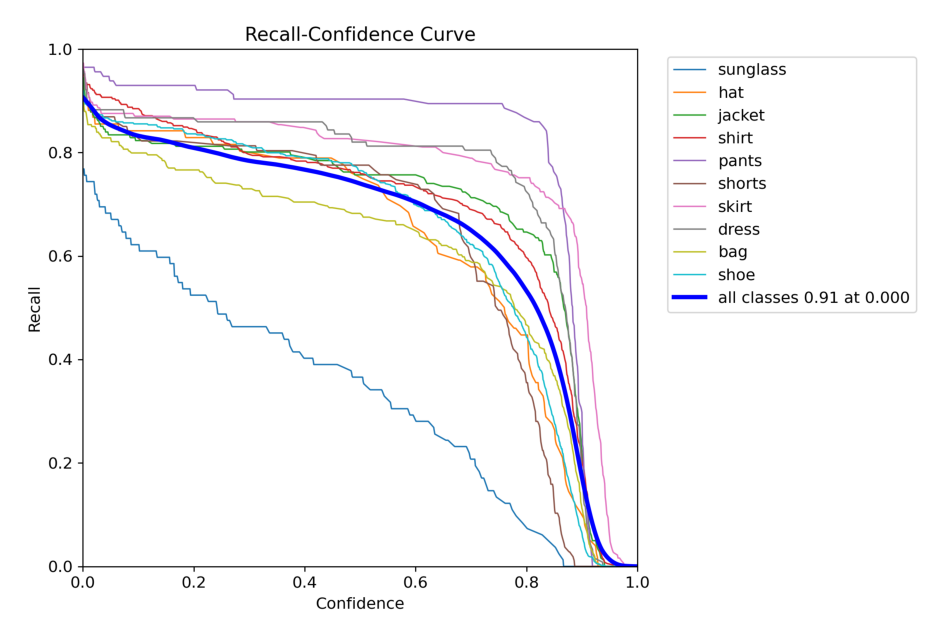

In [75]:
# Load image
yolo5_rm = cv2.imread('/content/drive/MyDrive/yolo_runs2/runs2/detect/5th yolo val/R_curve.png', 1)

# Convert BGR to RGB
yolo5_rm_rgb = cv2.cvtColor(yolo5_rm, cv2.COLOR_BGR2RGB)

# Set a larger figure size for display
plt.figure(figsize=(12, 10))

# Display the image
plt.imshow(yolo5_rm_rgb)
plt.axis("off")
plt.show()

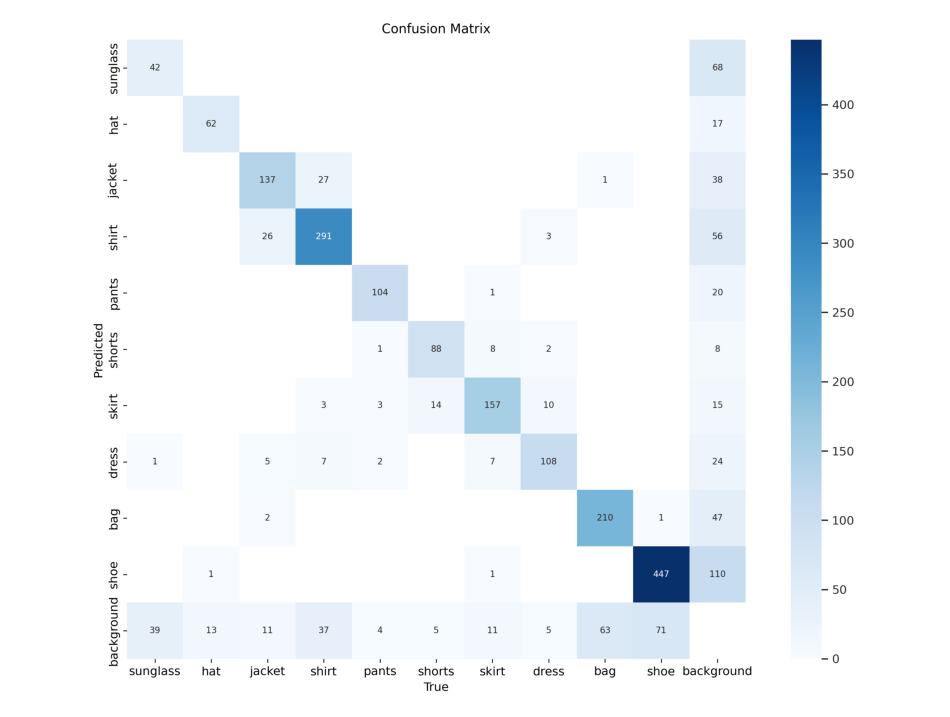

In [76]:
# Load image
yolo5_cm = cv2.imread('/content/drive/MyDrive/yolo_runs2/runs2/detect/5th yolo val/confusion_matrix.png', 1)

# Convert BGR to RGB
yolo5_cm_rgb = cv2.cvtColor(yolo5_cm, cv2.COLOR_BGR2RGB)

# Set a larger figure size for display
plt.figure(figsize=(12, 10))

# Display the image
plt.imshow(yolo5_cm_rgb)
plt.axis("off")
plt.show()

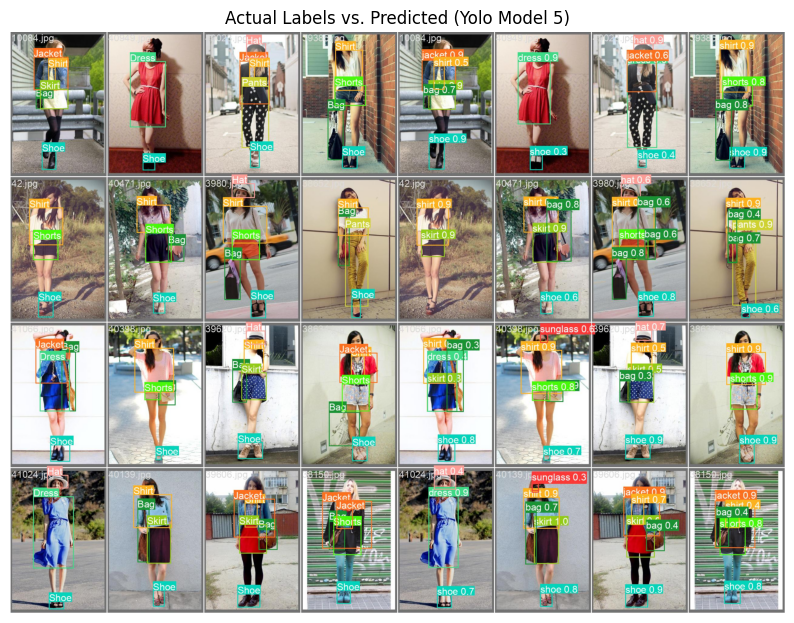

In [77]:
# Load the image
yolo5_pred = cv2.imread('/content/drive/MyDrive/yolo_runs2/runs2/detect/5th yolo val/val_batch0_pred.jpg', -1)

# Convert BGR to RGB
yolo5_pred_rgb = cv2.cvtColor(yolo5_pred, cv2.COLOR_BGR2RGB)

actual_labels = cv2.imread('/content/drive/MyDrive/yolo_runs2/runs2/detect/1st yolo val/val_batch0_labels.jpg', -1)
actual_labels_rgb = cv2.cvtColor(actual_labels, cv2.COLOR_BGR2RGB)

# Combine the images side by side
combined_image = cv2.hconcat([actual_labels_rgb, yolo5_pred_rgb])
plt.figure(figsize=(10, 8))

# Display the combined image
plt.imshow(combined_image)
plt.axis("off")
plt.title("Actual Labels vs. Predicted (Yolo Model 5)")
plt.show()


image 1/1 /content/drive/MyDrive/people.jpg: 448x640 3 jackets, 3 shirts, 2 pantss, 1 dress, 4 shoes, 88.6ms
Speed: 3.8ms preprocess, 88.6ms inference, 2.6ms postprocess per image at shape (1, 3, 448, 640)


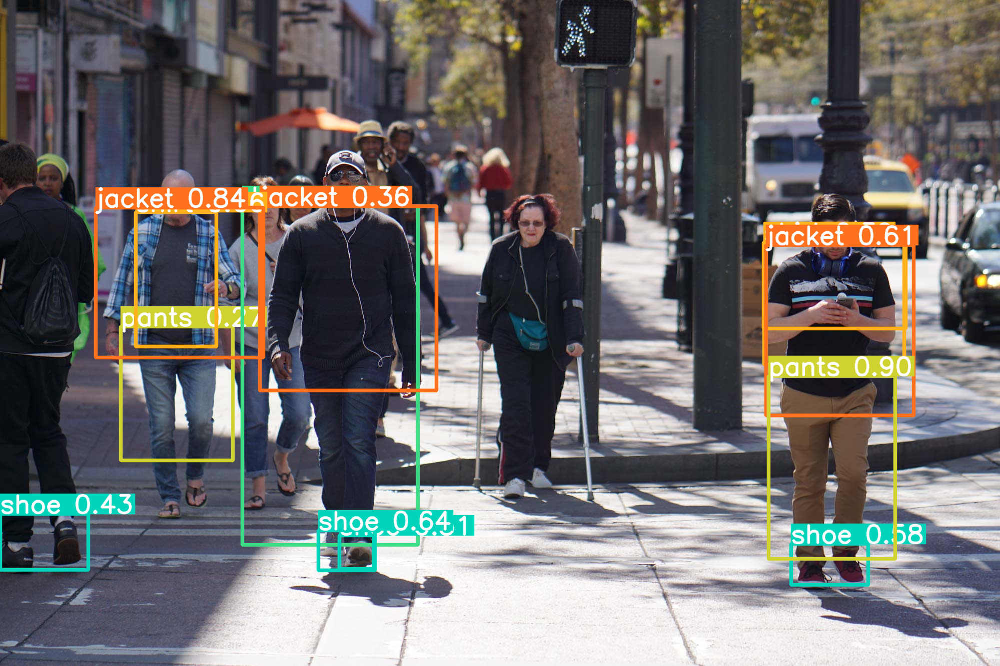

In [8]:
# Testing model onn real world data
from PIL import Image
results4 = yolo5("/content/drive/MyDrive/people.jpg")
for r in results4:
    im_array = r.plot()
    im = Image.fromarray(im_array[..., ::-1])
    display(im)

In [ ]:
yolo4.export(format='onnx')

Ultralytics YOLOv8.0.222 🚀 Python-3.10.12 torch-2.1.0+cu118 CPU (Intel Xeon 2.20GHz)

PyTorch: starting from 'runs/detect/train3/weights/best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 14, 8400) (49.6 MB)
requirements: Ultralytics requirement ['onnx>=1.12.0'] not found, attempting AutoUpdate...
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 15.7/15.7 MB 83.7 MB/s eta 0:00:00

requirements: AutoUpdate success ✅ 7.5s, installed 1 package: ['onnx>=1.12.0']
requirements: ⚠️ Restart runtime or rerun command for updates to take effect


ONNX: starting export with onnx 1.15.0 opset 17...
ONNX: export success ✅ 9.4s, saved as 'runs/detect/train3/weights/best.onnx' (98.8 MB)

Export complete (11.9s)
Results saved to /content/runs/detect/train3/weights
Predict:         yolo predict task=detect model=runs/detect/train3/weights/best.onnx imgsz=640  
Validate:        yolo val task=detect model=runs/detect/train3/weights/best.onnx imgsz=640 data=/content/drive/My Drive/YoloPro

'runs/detect/train3/weights/best.onnx'

In [10]:
!cp -r runs2 /content/drive/MyDrive/yolo_runs2